# Extracting touristic information from Airbnb guest reviews in Paris

In [1]:
import pandas as pd
from pandas.core.common import flatten
import numpy as  np
import matplotlib.pyplot as plt
import pickle
import os

import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS

import langdetect
import nltk
import unicodedata

from tqdm.notebook import tqdm
tqdm.pandas()

C:\Users\bjxn6144\AppData\Local\Continuum\anaconda3\lib\site-packages\tqdm\std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


## Loading the data

#### Load the AirBnB files and check content

The overall process is time consuming due to the very large number of reviews (more than 1.3 millions). You can chose to either run the code on a selection review samples (using the num_samples variable) or preload some precomputed files. 

In [2]:
num_samples = None

original_data_folder = os.path.join('Data', 'Original')
path_to_file = os.path.join(original_data_folder, 'listings.csv')
listing = pd.read_csv(path_to_file, low_memory=False)

path_to_reviews = os.path.join(original_data_folder, 'reviews.csv')
reviews =  pd.read_csv(path_to_reviews, low_memory=False)

# Since the code is very long to execute, we use a sample for testing
if num_samples is not None:
    reviews = reviews.sample(n=num_samples, replace=False)

In [3]:
listing.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,33065009,https://www.airbnb.com/rooms/33065009,20191107231022,2019-11-08,Beautiful apartment center of Paris with terrace,Very well located apartment in the heart of Pa...,4th floor apartment without elevator with air ...,Very well located apartment in the heart of Pa...,none,This apartment is located in the center of Par...,...,t,f,strict_14_with_grace_period,f,f,73,72,0,0,4.12
1,33008241,https://www.airbnb.com/rooms/33008241,20191107231022,2019-11-08,Magnificent apt located in the heart of Paris,Beautiful apartment of 22 square meters locate...,The accommodation is fully equipped and will p...,Beautiful apartment of 22 square meters locate...,none,NaN,...,f,f,moderate,f,f,1,1,0,0,2.18


In [4]:
reviews.head(2)

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,3109,123127969,2016-12-27,12389804,Sophie,The host canceled this reservation the day bef...
1,3109,123274144,2016-12-28,67553494,Tom'S,The host canceled this reservation 2 days befo...


In [5]:
print('Found {} reviews in total'.format(len(reviews)))

Found 1310351 reviews in total


## Compute some relevant statistics

####  Compute the number of beds available per neighbourhood

In [6]:
beds_per_ngb = listing[['neighbourhood_cleansed', 'beds']].groupby('neighbourhood_cleansed').sum()

In [7]:
beds_per_ngb = beds_per_ngb.reset_index()

####  Compute the number of flats available per neighbourhood

In [8]:
flats_per_ngb = listing[['neighbourhood_cleansed', 'id']].groupby('neighbourhood_cleansed').count()

In [9]:
flats_per_ngb = flats_per_ngb.reset_index()

In [10]:
flats_per_ngb.columns = ['Neighbourhood', 'Airbnb_flats']

In [11]:
airbnb_stats = pd.concat([flats_per_ngb, beds_per_ngb.beds], axis=1)

In [12]:
airbnb_stats.head(2)

,Neighbourhood,Airbnb_flats,beds
0,Batignolles-Monceau,4458,7123.0
1,Bourse,2235,3997.0


The file 'insee_stats.txt' was constructed based on the official statistics available on 
https://www.insee.fr/fr/statistiques/1405599?geo=COM-75101 (change 75101 by 750XX where XX represent two digits of the disctrict of interest). The final mapping from district numbers on neighbourhood names is quite classical.

In [13]:
path_to_insee = os.path.join(original_data_folder, 'insee_stats.txt')
with open(path_to_insee, encoding="utf8", errors='ignore') as fichier:
    insee_flats = pd.read_csv(fichier, sep=",")

In [14]:
airbnb_stats = pd.concat([airbnb_stats, insee_flats[['Population', 'Flats']]], axis=1)

In [15]:
airbnb_stats.head(2)

,Neighbourhood,Airbnb_flats,beds,Population,Flats
0,Batignolles-Monceau,4458,7123.0,167835,105350
1,Bourse,2235,3997.0,20260,17252


In [16]:
airbnb_stats['Flats percent'] = np.round(airbnb_stats.Airbnb_flats / airbnb_stats.Flats * 100, 1)

In [17]:
airbnb_stats['Pop. percent'] = np.round(airbnb_stats.beds / airbnb_stats.Population * 100, 1)

In [18]:
airbnb_stats['Attraction ratio'] = airbnb_stats['Pop. percent'] / airbnb_stats['Airbnb_flats']
airbnb_stats['Attraction ratio'] = airbnb_stats['Attraction ratio'] / max(airbnb_stats['Attraction ratio'])
airbnb_stats['Attraction ratio'] = np.round(airbnb_stats['Attraction ratio'], 2)

In [19]:
airbnb_stats

,Neighbourhood,Airbnb_flats,beds,Population,Flats,Flats percent,Pop. percent,Attraction ratio
0,Batignolles-Monceau,4458,7123.0,167835,105350,4.2,4.2,0.09
1,Bourse,2235,3997.0,20260,17252,13.0,19.7,0.85
2,Buttes-Chaumont,3718,6254.0,186393,96407,3.9,3.4,0.09
3,Buttes-Montmartre,7446,11279.0,195060,121297,6.1,5.8,0.08
4,Entrepôt,4595,7519.0,91932,59566,7.7,8.2,0.17
5,Gobelins,2271,3715.0,181552,103862,2.2,2.0,0.08
6,Hôtel-de-Ville,2006,3406.0,27487,22813,8.8,12.4,0.60
7,Louvre,1329,2249.0,16252,13797,9.6,13.8,1.00
8,Luxembourg,1927,3511.0,40916,31517,6.1,8.6,0.43
9,Ménilmontant,3834,6161.0,195604,106522,3.6,3.1,0.08


### Visualization of relevant statistics

#### Total number of AirBnB flats per neighbourhood

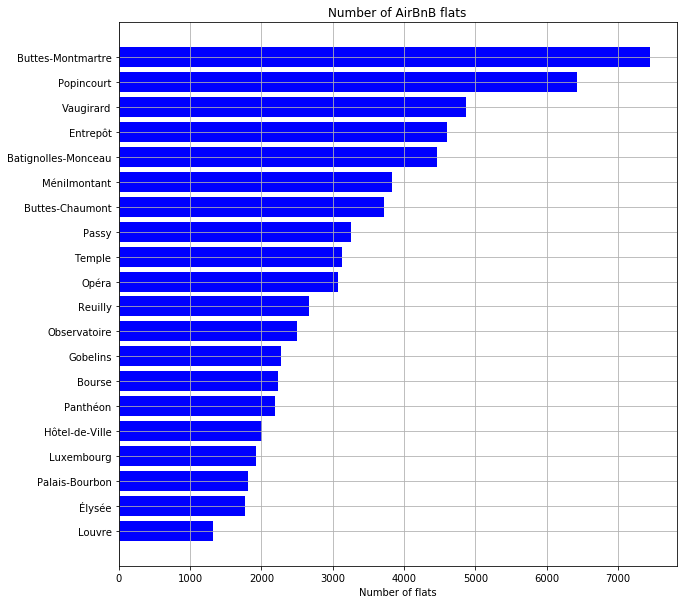

In [20]:
features = airbnb_stats['Neighbourhood'].values
importances = airbnb_stats['Airbnb_flats']

indices = np.argsort(importances)

fig, ax = plt.subplots(figsize=(10,10))
plt.title('Number of AirBnB flats')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Number of flats')
plt.grid()
plt.show()

#### Percentage of AirBnB flats relative to the total number of flats

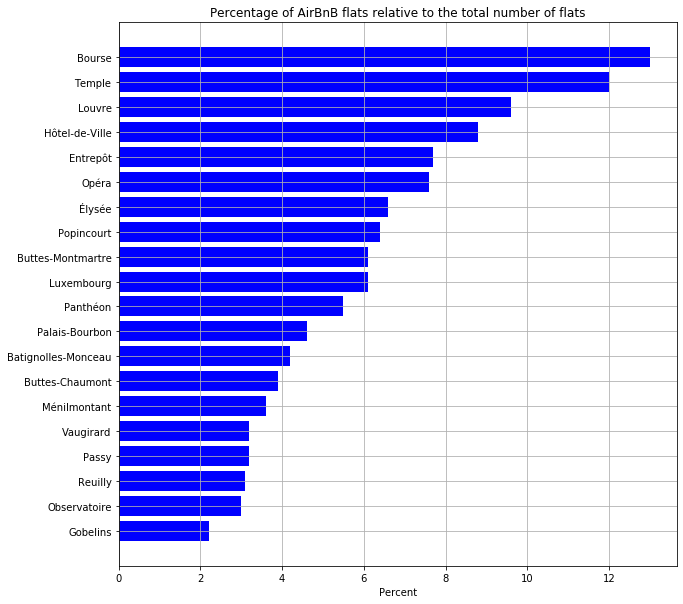

In [21]:
features = airbnb_stats['Neighbourhood'].values
importances = airbnb_stats['Flats percent']

indices = np.argsort(importances)

fig, ax = plt.subplots(figsize=(10,10))
plt.title('Percentage of AirBnB flats relative to the total number of flats')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Percent')
plt.grid()
plt.show()

#### Percentage of AirBnB beds relative to the population

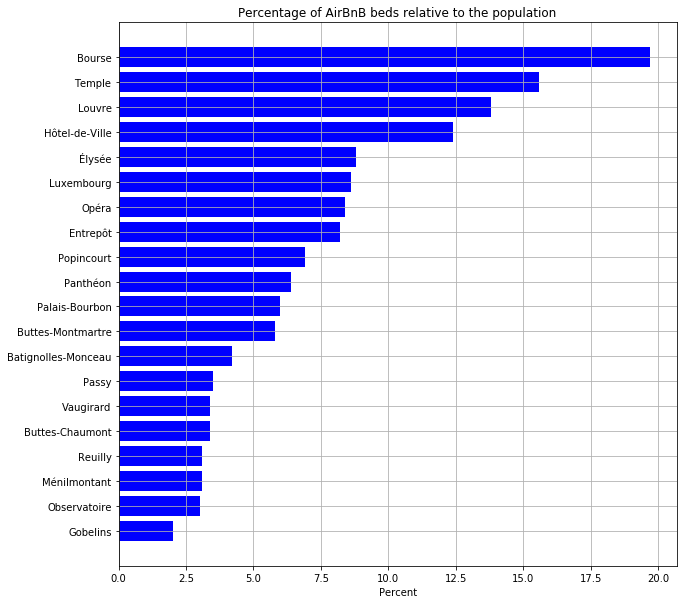

In [22]:
features = airbnb_stats['Neighbourhood'].values
importances = airbnb_stats['Pop. percent']

indices = np.argsort(importances)

fig, ax = plt.subplots(figsize=(10,10))
plt.title('Percentage of AirBnB beds relative to the population')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Percent')
plt.grid()
plt.show()

#### Neighbourhood attraction ratio

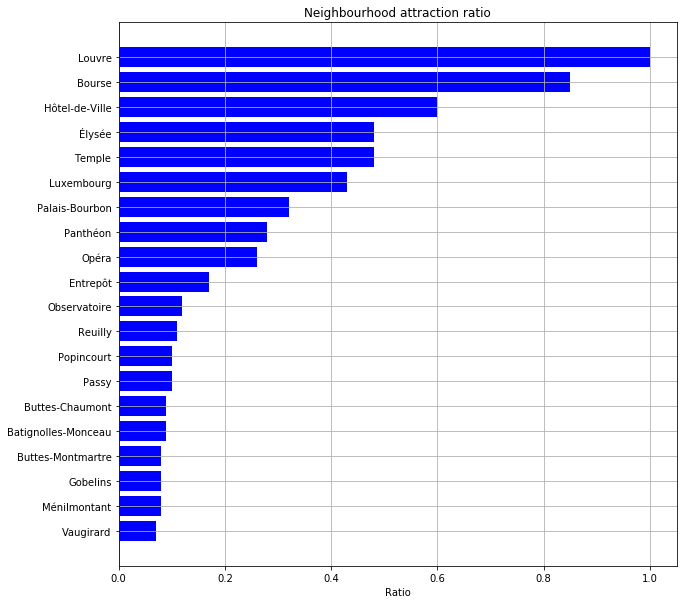

In [23]:
features = airbnb_stats['Neighbourhood'].values
importances = airbnb_stats['Attraction ratio']

indices = np.argsort(importances)

fig, ax = plt.subplots(figsize=(10,10))
plt.title('Neighbourhood attraction ratio')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Ratio')
plt.grid()
plt.show()

## Reviews filtering

Before processing the reviews set, we make the following filtering:  
* Since most of the reviews are in english, we choose to select only the reviews in english. For this, we use the package 'langdetect'. 
* We discard the reviews that are automatically posted by a bot and can be found through the pattern 'This is an automated posting'. 
* We keep only reviews containing text

In [24]:
def assess_language(text):
    """
    Returns the language detected in a tex when applicable.
    """
    try:
        x = langdetect.detect(text)
    except:
        x = np.nan
    return x

In [25]:
def select_reviews(text):
    """
    Selects the review of interest for the analysis : written in english, not written by a bot.
    """
    if (type(text) is not str) or ('This is an automated posting' in text) or (assess_language(text) != 'en'):
        return np.nan
    else:
        return text

The selection is very time consuming. To gain time, we use the saved index of the corresponding process. 

In [26]:
path_to_pickles = os.path.join('Data', 'Saved')
path_to_dataindex = os.path.join(path_to_pickles, 'DataIndex.pickle')

if os.path.exists(path_to_dataindex) and num_samples is None:
    DataIndex = pickle.load(open(path_to_dataindex, 'rb'))
    reviews_english = reviews.iloc[DataIndex].copy()
else:
    reviews_english = reviews.copy()
    reviews_english['comments'] = reviews_english['comments'].progress_apply(select_reviews)
    reviews_english = reviews_english.dropna(subset=['comments'])
    if num_samples is None:
        pickle.dump(reviews_english.index, open(path_to_dataindex, 'wb'))

In [27]:
print('Found {} reviews written in english'.format(len(reviews_english)))

Found 795721 reviews written in english


#### Add the neighbourhood information to the dataframe and remove some non-useful columns

__Keep only useful columns__

In [28]:
reviews_english = reviews_english[['listing_id', 'date', 'comments']]

In [29]:
def get_neighbourhood(row, listing=listing):    
    """
    Returns the neighbourhood of a review by searching for it in the listing file. 
    """
    neighbourhood_series = listing[listing['id'] == row['listing_id']].neighbourhood_cleansed
    if len(neighbourhood_series)>0:
        return neighbourhood_series.values[0]
    else:
        return np.nan

In [30]:
reviews_english['Neighbourhood'] = reviews_english.progress_apply(get_neighbourhood, axis=1)

#### Keep only useful columns

In [31]:
reviews_english = reviews_english[['date', 'comments', 'Neighbourhood']]

In [32]:
reviews_english.head()

,date,comments,Neighbourhood
5,2010-03-27,I booked this apartment for my four friends an...,Buttes-Montmartre
6,2010-04-11,I love the appartment as it is very cute with ...,Buttes-Montmartre
7,2010-05-13,The apartment is very charming. My teenage dau...,Buttes-Montmartre
8,2010-05-24,This delightful little nest was perfect for u...,Buttes-Montmartre
9,2010-06-20,"Karen is a wonderful host, after greeting us w...",Buttes-Montmartre


## Stopwords from Gensim to be filtered out:

In [33]:
STOPWORDS = gensim.parsing.preprocessing.STOPWORDS

In [34]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
STOPWORDS = set(stopwords.words('french')).union(STOPWORDS)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\bjxn6144\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [35]:
def remove_accents(x):
    return ''.join((c for c in unicodedata.normalize('NFD', x) if unicodedata.category(c) != 'Mn'))

## Host names to be removed. 
The analysis can be biased by the hosts names that often appear in the reviews. To cope with this issue, we remove all names found in the reviews with the help of the list below. 



In [36]:
def construct_name(x):
    """
    When applicable, splits a text into tokens.
    This is applied to the listing['host_name'] column to get the components of the hosts names. 
    """
    try:
        z = gensim.utils.simple_preprocess(x)
    except:
        z = np.nan
            
    return z

Extract names from the listing host data and do some cleaning

In [37]:
names = listing['host_name'].apply(construct_name)

In [38]:
# We flatten the list of host names into a list
all_names = set(flatten(list(names.values)))
all_names.discard(np.nan)
# We discard some elements that represent also famous places from Paris
all_names.discard('champs')
all_names.discard('charles')
all_names.discard('paris')
all_names.discard('louis')
all_names.discard('jourdain')
all_names.discard('roland')
all_names.discard('dame')
all_names.discard('germain')
all_names.discard('montmartre')

# For some names like Jean-Marc, we can have spelling error and find it as Jean Marc. 
# Therefore we add these derived names to the names list
derived_names = set()
for x in all_names:
    derived_names.add(' '.join(x.split('-')))
    
all_names = all_names.union(derived_names)
    
all_names = set(all_names)

At this point, we have in all_names both real names and other tokens that are not names. For further filtering, we load a database of french names and keep only the elements of all_names that are present in this list.  
The following file was extracted from https://www.insee.fr/fr/statistiques/2540004 which contains all the names that were given in France since early 1900. 

In [39]:
insee_names = pd.read_csv('./Data/Original/nat2018.csv', sep=';')
all_names_insee = (insee_names.preusuel.values)
all_names_insee = set([x.lower() for x in all_names_insee if type(x)==str and len(x)>1])

In [40]:
for x in list(all_names):
    if x not in all_names_insee:
        all_names.discard(x)
    else:
        all_names.add(remove_accents(x))

Further filtering done after iteration on the result. 

In [41]:
names_to_add = {'nazeem', 'polyna', 'monic', 'lolotte', 'henley', 'mami', 'mychele', 'pat','kat', 'venie', 'ysa',\
          'germaine', 'siyoung', 'bouzra', 'khal', 'jojo', 'zanne', 'yas', 'elo', 'segire', 'aki',\
          'welly', 'ebe', 'suomi', 'sweet inn', 'segolene', 'corrine', 'regine', 'vale', 'jen', 'marie-anne',\
        'anne-sophie', 'jp', 'jean-paul', 'jean-marc', 'anne-charlotte', 'jean-pierre', 'jc', 'maitis',\
                'jean-michel', 'cat cute', 'jean-michel', 'anne-marie', 'jean-luc', 'noelle', 'jean-louis',\
                'jb', 'jean-francois', 'rumi', 'jean-claude', 'marie-christine', 'osaka', 'fralma', 'fralmas',\
                'sono', 'm4', 'sl', 'sichen', 'hag', 'jean-baptiste'}
 
for x in names_to_add:
    all_names.add(x)

The following function is used for filtering of the dictionnaries, see below.

In [42]:
def common_tokens(x1, x2):
    """
    Split two strings in tokens and return the list of common token.
    """
    x1 = gensim.utils.simple_preprocess(x1)
    x2 = gensim.utils.simple_preprocess(x2)
    
    return list(set(x1).intersection(x2))

In [43]:
x1 = 'walk eiffel'
x2 = 'walk eiffel tower'
common_tokens(x1, x2)

['walk', 'eiffel']

## Entity name recognition

We provide below the functions that permit to do tokenization, and then we provide some examples to understand how the code works.

In [44]:
import nltk
import codecs

sentence_tokenizer = nltk.data.load('tokenizers/punkt/english.pickle')

In [45]:
def build_tokens(sentence):
    """
    From a sentence tokenized by nltk, build a list of tokens.
    We use filering of host names and grouping of entities representing locations. 
    
    IN : 
    _________________________________________
    sentence tokenized by nltk
    
    RETURN : 
    _________________________________________
    list of tokens
    """
    all_tokens = []
    current_token = []
    articles = {'the', 'le', 'les', 'à', 'a', 'aux', 'au'}
    
    ii = 0
    while ii<len(sentence):
        if  sentence[ii][1] == 'NNP' and sentence[ii][0].lower() not in articles\
        and sentence[ii][0].lower() not in all_names and len(sentence[ii][0])>1:
            while ii<len(sentence) and sentence[ii][1] == 'NNP':
                current_token.append(sentence[ii][0].lower())
                ii+=1
            if ii<len(sentence) and sentence[ii][0].lower() in articles:
                current_token.append(sentence[ii][0].lower())
                ii+=1      
                while ii<len(sentence) and sentence[ii][1] == 'NNP':
                    current_token.append(sentence[ii][0].lower())
                    ii+=1
            current_token = ' '.join([x for x in current_token])
            if current_token.lower() != 'paris' and current_token.lower() not in all_names:
                all_tokens.append(current_token)
            current_token = []
        else:
            x = sentence[ii][0].lower()
            x = remove_accents(x)
            if x.isalpha() and x not in STOPWORDS and x != 'paris' and x not in all_names:
                all_tokens.append(x)
            ii += 1
                
    return all_tokens

In [46]:
def tags_to_token(pos_tagged_sents):
    """
    Concatenates the results of several sentences tokenization
    
    Input : List of words with their tokens, output from nltk tokenizer (see example below)
    Output : list of tokens of the review
    """

    all_tokens = []
    for sentence in pos_tagged_sents:
        all_tokens += build_tokens(sentence)
        
    return all_tokens

In [47]:
def review_to_token(review):
    """
    High level function. Calls the nltk tokenizer and call the low level functions that constructs tokens.
    
    IN : one review
    Out : the tokens
    """
    
    try:
        sentences = sentence_tokenizer.tokenize(review)
        tok_sentences = [nltk.word_tokenize(s) for s in sentences]
        
        pos_tagged_sents = []
        for s in tok_sentences:
            tmp = nltk.pos_tag(s)
            pos_tagged_sents.append(tmp)
            
        tokens = tags_to_token(pos_tagged_sents)
        
    except:
        print('ERROR')
        print(review)
        print('_'*50)
        tokens = np.nan
        
    return tokens
            

__Final result illustration__ : we can see below that 'notre dame' and 'ile st. louis' are recognized as unbreakable entities.

In [74]:
review = 'Perfect place to be in Paris, walking home every night past Notre Dame and across the river \
through the old streets of the Ile St. Louis. The studio is just right- attractive, immaculate, \
with everything you could need.'
review_to_token(review)

['perfect',
 'place',
 'walking',
 'home',
 'night',
 'past',
 'notre dame',
 'river',
 'old',
 'streets',
 'ile st. louis',
 'studio',
 'attractive',
 'immaculate',
 'need']

__Intermediate result illustration__ : vizualizing the result of the nltk tokenizer

In [77]:
sentences = sentence_tokenizer.tokenize(review)
tok_sentences = [nltk.word_tokenize(s) for s in sentences]

pos_tagged_sents = []
for s in tok_sentences:
    tmp = nltk.pos_tag(s)
    pos_tagged_sents.append(tmp)

In [78]:
pos_tagged_sents

[[('Perfect', 'JJ'),
  ('place', 'NN'),
  ('to', 'TO'),
  ('be', 'VB'),
  ('in', 'IN'),
  ('Paris', 'NNP'),
  (',', ','),
  ('walking', 'VBG'),
  ('home', 'NN'),
  ('every', 'DT'),
  ('night', 'NN'),
  ('past', 'IN'),
  ('Notre', 'NNP'),
  ('Dame', 'NNP'),
  ('and', 'CC'),
  ('across', 'IN'),
  ('the', 'DT'),
  ('river', 'NN'),
  ('through', 'IN'),
  ('the', 'DT'),
  ('old', 'JJ'),
  ('streets', 'NNS'),
  ('of', 'IN'),
  ('the', 'DT'),
  ('Ile', 'NNP'),
  ('St.', 'NNP'),
  ('Louis', 'NNP'),
  ('.', '.')],
 [('The', 'DT'),
  ('studio', 'NN'),
  ('is', 'VBZ'),
  ('just', 'RB'),
  ('right-', 'JJ'),
  ('attractive', 'JJ'),
  (',', ','),
  ('immaculate', 'JJ'),
  (',', ','),
  ('with', 'IN'),
  ('everything', 'NN'),
  ('you', 'PRP'),
  ('could', 'MD'),
  ('need', 'VB'),
  ('.', '.')]]

### Obtaining one big review per neighbourhood

In the process below, we build 20 big reviews, one per neighbourhood, and save them in a new compact dataframe review_concat.

In [49]:
path_to_review_concat = os.path.join(path_to_pickles, 'review_concat.pickle')

if os.path.exists(path_to_review_concat) and num_samples is None:
    review_concat = pickle.load(open(path_to_review_concat, 'rb'))
else:
    print('review_to_token:')
    reviews_english['tokens'] = reviews_english['comments'].progress_apply(review_to_token)
    print('review_concat:')
    review_concat = reviews_english[['Neighbourhood', 'tokens']].groupby('Neighbourhood').progress_apply(lambda x :x.sum())
    if num_samples is None:
        pickle.dump(review_concat, open(path_to_review_concat, 'wb'))

review_to_token:



review_concat:


### TF-IDF vectorizer

In [50]:
def dummy_fun(doc):
    """
    Used to be able to apply TfidfVectorizer to lists
    """
    return doc

In [51]:
from sklearn.feature_extraction.text import TfidfVectorizer

VocabSize = 2000
corpus = list(review_concat['tokens'].values)

vectorizer = TfidfVectorizer(max_df=0.9,
                             min_df=5,
                             analyzer = 'word', 
                             tokenizer = dummy_fun,
                             preprocessor = dummy_fun,
                             max_features=VocabSize, 
                             ngram_range=(1, 3), 
                             token_pattern=None)
X = vectorizer.fit_transform(corpus)

In [52]:
DfW = pd.DataFrame(X.todense(), columns=vectorizer.get_feature_names())
DfW.index = review_concat.index

In [53]:
DfW

,able drop bags,able walk eiffel tower,able walk louvre,able walk major,able walk wanted,able watch,absolute perfect,absolutely amazing location,absolutely book,absolutely fantastic location,...,wonderful host highly,wonderful marais,wonderful market,wonderful night stay,wonderful shops restaurants,wonderful time great,wonderful view eiffel tower,wonderful walking,wood beams,wooden beams
Neighbourhood,,,,,,,,,,,,,,,,,,,,,
Batignolles-Monceau,0.000648,0.002484,0.000000,0.000000,0.003241,0.000648,0.004760,0.002040,0.003241,0.000000,...,0.004537,0.000000,0.008840,0.004080,0.001944,0.009074,0.002248,0.000680,0.000000,0.000787
Bourse,0.010814,0.001884,0.020902,0.010230,0.008357,0.003932,0.003610,0.006189,0.005407,0.006495,...,0.002949,0.002813,0.004126,0.006704,0.003932,0.005407,0.000000,0.007220,0.003978,0.011944
Buttes-Chaumont,0.001614,0.000000,0.000000,0.000000,0.000000,0.000000,0.001129,0.000000,0.000538,0.000000,...,0.000000,0.000000,0.002822,0.000000,0.000000,0.000538,0.000000,0.001129,0.000000,0.000000
Buttes-Montmartre,0.002738,0.000000,0.000256,0.000487,0.000632,0.001685,0.001989,0.001989,0.001474,0.001855,...,0.003581,0.000000,0.000442,0.002431,0.001685,0.004423,0.002192,0.001326,0.000487,0.002047
Entrepôt,0.002186,0.000000,0.001062,0.001011,0.002186,0.001968,0.001376,0.000459,0.001749,0.001444,...,0.002624,0.000417,0.001147,0.000918,0.001093,0.002405,0.000253,0.002294,0.000506,0.001062
Gobelins,0.000000,0.000000,0.000000,0.000000,0.000000,0.002983,0.006260,0.000000,0.005967,0.003285,...,0.026850,0.000000,0.012520,0.012520,0.002983,0.005967,0.003449,0.000000,0.003449,0.007249
Hôtel-de-Ville,0.002100,0.000671,0.004464,0.004552,0.003937,0.000787,0.005783,0.004957,0.002362,0.005492,...,0.002887,0.026039,0.000275,0.003305,0.005775,0.004200,0.000000,0.001928,0.005463,0.010205
Louvre,0.007030,0.001796,0.010249,0.007316,0.007030,0.002109,0.010326,0.009589,0.005624,0.008515,...,0.003515,0.001341,0.000000,0.003688,0.002812,0.005624,0.000813,0.008851,0.008942,0.008541
Luxembourg,0.006804,0.003161,0.018035,0.012873,0.009897,0.004330,0.011032,0.011032,0.003711,0.008173,...,0.008660,0.000000,0.001298,0.007787,0.007422,0.004330,0.002145,0.009085,0.011443,0.012775


## Obtaining the final colored maps 

For each neighbourhood, we keep the 150 most significant ngrams. 
For a better result, we introduce two levels of filtering that were chosen in an iterative way:  
* First, we remove all items that are included in an other item if it has a significant tf-idf value
* Secondly, only for the neighbourhood needing it, we search for pairs of item having at least two tokens in common, and we keep only the longest one if it has a sufficient tf-idf  
 
For monitoring the filtering process, we added some logging where we put the rule number, the removed key, the cause of removal, and the number of times it has been applied. 


We plot the three possible output (without filtering / with one level of filtering / with two levels of filtering) and we choose visually the one that seems the most diverse. 

In [62]:
vibrations_full = {}
vibrations_F2 = {}
vibrations_F23 = {}

for q in DfW.index:
    
    # Compute tf-idf dictionnary for neighbourhood q
    vibrations_full[q] = DfW.loc[q].sort_values(ascending=False)
    vibrations_F2[q] = DfW.loc[q].sort_values(ascending=False)
    vibrations_F23[q] = DfW.loc[q].sort_values(ascending=False)
    
for q in DfW.index:
     
    # Remove keys included in others
    for k in (vibrations_full[q]).keys():
        if k in names_to_add:
            (vibrations_full[q]).pop(k)
            
    # Remove keys included in others
    for k in (vibrations_F2[q]).keys():
        if k in names_to_add:
            (vibrations_F2[q]).pop(k)   
            
            
    # Remove keys included in others
    for k in (vibrations_F23[q]).keys():
        if k in names_to_add:
            (vibrations_F23[q]).pop(k)    

In [63]:
th_include = 0.2
r2 = 0

for q in DfW.index:
     
    # Remove keys included in others
    for k in (vibrations_F2[q]).keys():
        for k2 in (vibrations_F2[q]).keys():
            if k2 is not k and k in k2.split() and vibrations_F2[q][k2]>=th_include*vibrations_F2[q][k]: 
                r2+=1
                print('2. Removed ', k, ', cause : ', k2, r2)
                vibrations_F2[q][k2] = max(vibrations_F2[q][k], vibrations_F2[q][k2])
                (vibrations_F2[q]).pop(k)
                break   

2. Removed  congres , cause :  palais congres 1
2. Removed  palais , cause :  palais congres 2
2. Removed  arch , cause :  triumphal arch 3
2. Removed  triomph , cause :  arc triomph 4
2. Removed  moulin , cause :  moulin rouge 5
2. Removed  porte , cause :  porte maillot 6
2. Removed  rouge , cause :  moulin rouge 7
2. Removed  elysee , cause :  champs elysee 8
2. Removed  concorde , cause :  place de concorde 9
2. Removed  lafayette , cause :  galleries lafayette 10
2. Removed  cœur , cause :  sacré cœur 11
2. Removed  couer , cause :  walk sacre couer 12
2. Removed  pompidou , cause :  louvre pompidou 13
2. Removed  cour , cause :  sacre cour 14
2. Removed  republique , cause :  republique metro 15
2. Removed  sex , cause :  sex shops 16
2. Removed  mars , cause :  champ mars 17
2. Removed  roissy , cause :  roissy bus 18
2. Removed  canal , cause :  canal saint martin 19
2. Removed  pont , cause :  pont neuf 20
2. Removed  picasso , cause :  picasso museum 21
2. Removed  buttes , c

2. Removed  pont , cause :  pont neuf 170
2. Removed  mars , cause :  champ mars 171
2. Removed  palais , cause :  palais garnier 172
2. Removed  roissy , cause :  roissy bus 173
2. Removed  vosges , cause :  place vosges 174
2. Removed  triomph , cause :  arc triomph 175
2. Removed  mouffetard , cause :  rue mouffetard 176
2. Removed  d'orsay , cause :  louvre musee d'orsay 177
2. Removed  rodin , cause :  rodin museum 178
2. Removed  mouffetard , cause :  rue mouffetard 179
2. Removed  plantes , cause :  jardin plantes 180
2. Removed  roissy , cause :  roissy bus 181
2. Removed  pompidou , cause :  pompidou center 182
2. Removed  metiers , cause :  arts metiers 183
2. Removed  d'orsay , cause :  louvre musee d'orsay 184
2. Removed  rivoli , cause :  rue rivoli 185
2. Removed  est , cause :  gare est 186
2. Removed  halles , cause :  chatelet les halles 187
2. Removed  arch , cause :  arch triumph 188
2. Removed  elysee , cause :  champs elysee 189
2. Removed  enfants , cause :  enfan

2. Removed  rivoli , cause :  rue rivoli 336
2. Removed  rouge , cause :  moulin rouge 337
2. Removed  l'est , cause :  gare l'est 338
2. Removed  roissy , cause :  roissy bus 339
2. Removed  metiers , cause :  arts metiers 340
2. Removed  montorgueil , cause :  rue montorgueil 341
2. Removed  elysee , cause :  champs elysee 342
2. Removed  moulin , cause :  moulin rouge 343
2. Removed  palais , cause :  palais royal 344
2. Removed  couer , cause :  walk sacre couer 345
2. Removed  congres , cause :  palais congres 346
2. Removed  rodin , cause :  rodin museum 347
2. Removed  rouges , cause :  enfants rouges 348
2. Removed  arch , cause :  arch triumph 349
2. Removed  vosges , cause :  place de vosges 350
2. Removed  triomph , cause :  arc triomph 351
2. Removed  cœur , cause :  sacré cœur 352
2. Removed  lafayette , cause :  galeries lafayette 353
2. Removed  plantes , cause :  jardin plantes 354
2. Removed  d'orsay , cause :  louvre musee d'orsay 355
2. Removed  pont , cause :  pont 

2. Removed  triomph , cause :  arc triomph 513
2. Removed  congres , cause :  palais congres 514
2. Removed  porte , cause :  porte maillot 515
2. Removed  mars , cause :  champ mars 516
2. Removed  concorde , cause :  place de concorde 517
2. Removed  roland , cause :  roland garros 518
2. Removed  moulin , cause :  moulin rouge 519
2. Removed  pompidou , cause :  louvre centre pompidou 520
2. Removed  roissy , cause :  roissy bus 521
2. Removed  lafayette , cause :  galeries lafayette 522
2. Removed  rouge , cause :  moulin rouge 523
2. Removed  republique , cause :  place de republique 524
2. Removed  canal , cause :  canal st martin 525
2. Removed  chaumont , cause :  buttes chaumont park 526
2. Removed  metiers , cause :  arts metiers 527
2. Removed  buttes-chaumont , cause :  parc buttes-chaumont 528
2. Removed  buttes , cause :  buttes chaumont park 529
2. Removed  vosges , cause :  place vosges 530
2. Removed  halles , cause :  chatelet les halles 531
2. Removed  montorgueil , 

2. Removed  triomph , cause :  arc triomph 689
2. Removed  palais , cause :  palais congres 690
2. Removed  roissy , cause :  roissy bus 691
2. Removed  rouge , cause :  moulin rouge 692
2. Removed  d'orsay , cause :  louvre musee d'orsay 693
2. Removed  moulin , cause :  moulin rouge 694
2. Removed  congres , cause :  palais congres 695
2. Removed  rivoli , cause :  rue rivoli 696
2. Removed  rodin , cause :  rodin museum 697
2. Removed  cour , cause :  sacre cour 698
2. Removed  pompidou , cause :  louvre pompidou 699
2. Removed  cemetery , cause :  père lachaise cemetery 700
2. Removed  vosges , cause :  place vosges 701
2. Removed  couer , cause :  walk sacre couer 702
2. Removed  canal , cause :  walk canal 703
2. Removed  buttes-chaumont , cause :  parc buttes-chaumont 704
2. Removed  buttes , cause :  buttes chaumont park 705
2. Removed  chaumont , cause :  buttes chaumont park 706
2. Removed  chatelet , cause :  chatelet metro 707
2. Removed  oberkampf , cause :  rue oberkampf 

In [67]:
th_include = 0.2
th_common = 0.2

r2 = 0
r3 = 0

for q in DfW.index:
                
    # Remove keys included in others
    for k in (vibrations_F23[q]).keys():
        for k2 in (vibrations_F23[q]).keys():
            if k2 is not k and k in k2.split() and vibrations_F23[q][k2]>=th_include*vibrations_F23[q][k]: 
                r2+=1
                print('2. Removed ', k, ', cause : ', k2, r2)
                vibrations_F23[q][k2] = max(vibrations_F23[q][k], vibrations_F23[q][k2])
                (vibrations_F23[q]).pop(k)
                break   
                
    for k in (vibrations_F23[q]).keys():
        for k2 in (vibrations_F23[q]).keys():
            if k2 is not k and len(common_tokens(k, k2))>1:
                l1 = len(k.split())
                l2 = len(k2.split())
                if l2 >= l1 and vibrations_F23[q][k2]>=th_common*vibrations_F23[q][k]:
                    r3+=1
                    print('3. Removed ', k, ', cause : ', k2, r3)
                    vibrations_F23[q][k2] = max(vibrations_F23[q][k], vibrations_F23[q][k2])
                    (vibrations_F23[q]).pop(k)
                    break 

3. Removed  walk arc , cause :  walk arc triomphe 1
3. Removed  close arc , cause :  close arc triomphe 2
3. Removed  walk arc triomphe , cause :  close arc triomphe 3
3. Removed  close arc triomphe , cause :  distance arc triomphe 4
3. Removed  walking distance arc , cause :  distance arc triomphe 5
3. Removed  distance arc , cause :  distance arc triomphe 6
3. Removed  distance arc triomphe , cause :  near arc triomphe 7
3. Removed  moulin rouge , cause :  close moulin rouge 8
3. Removed  minute walk arc , cause :  min walk arc 9
3. Removed  near arc , cause :  near arc triomphe 10
3. Removed  away arc , cause :  away arc triomphe 11
3. Removed  near arc triomphe , cause :  arc triomphe metro 12
3. Removed  arc triomphe metro , cause :  away arc triomphe 13
3. Removed  distance montmartre , cause :  walking distance montmartre 14
3. Removed  walk montmartre , cause :  short walk montmartre 15
3. Removed  walking distance montmartre , cause :  montmartre walking distance 16
3. Removed

3. Removed  great restaurants apartment , cause :  restaurants bars apartment 128
3. Removed  conveniently close metro , cause :  close metro need 129
3. Removed  arrived showed apartment , cause :  met showed apartment 130
3. Removed  cool bars restaurants , cause :  restaurants bars right 131
3. Removed  apartment looking stay , cause :  location stay apartment 132
3. Removed  bit far center , cause :  bit far city 133
3. Removed  garden nice , cause :  nice garden 134
3. Removed  tower nice , cause :  nice view eiffel tower 135
3. Removed  bit far city , cause :  location bit far 136
3. Removed  great location surrounded , cause :  great location able 137
3. Removed  restaurants bars right , cause :  bars restaurants right 138
3. Removed  tons restaurants shops , cause :  restaurants shops bars 139
3. Removed  eiffel tower sacre coeur , cause :  minute walk sacre coeur 140
3. Removed  stay centrally located , cause :  quiet centrally located 141
3. Removed  great location able , cau

3. Removed  place light , cause :  light place 249
3. Removed  distance major sites , cause :  distance major sights 250
3. Removed  main stations , cause :  main train stations 251
3. Removed  location absolutely fantastic , cause :  fantastic location right 252
3. Removed  view eiffel tower balcony , cause :  eiffel tower arc de triomphe 253
3. Removed  heart location , cause :  amazing location heart 254
3. Removed  beautiful perfectly located , cause :  perfectly located apartment 255
3. Removed  centrally located place , cause :  place located heart 256
3. Removed  fantastic walking , cause :  fantastic location walking 257
3. Removed  location near lots , cause :  location lots bars 258
3. Removed  nord metro , cause :  metro gare du nord 259
3. Removed  minute walk eiffel , cause :  minute walk sacre coeur 260
3. Removed  tower minute , cause :  eiffel tower minute walk 261
3. Removed  place great neighbourhood , cause :  located great neighbourhood 262
3. Removed  great locatio

3. Removed  apartment easy walk , cause :  apartment easy walking 363
3. Removed  staircase narrow , cause :  narrow spiral staircase 364
3. Removed  stairs flights , cause :  note flights stairs 365
3. Removed  best location great , cause :  questions great location 366
3. Removed  recommend staying fantastic , cause :  recommend fantastic location 367
3. Removed  recommend fantastic location , cause :  place location fantastic 368
3. Removed  stay location location , cause :  stay location better 369
3. Removed  questions great location , cause :  eiffel tower great location 370
3. Removed  soon stay , cause :  stay hope soon 371
3. Removed  place location fantastic , cause :  location location place 372
3. Removed  bars shops restaurants , cause :  wonderful shops restaurants 373
3. Removed  walking distance famous , cause :  montmartre walking distance 374
3. Removed  walking distance big , cause :  montmartre walking distance 375
3. Removed  amazing walking distance , cause :  mon

3. Removed  louvre notre-dame , cause :  distance louvre notre dame 482
3. Removed  eiffel tower restaurants , cause :  eiffel tower arc de triomphe 483
3. Removed  eiffel tower minutes walk , cause :  eiffel tower arc de triomphe 484
3. Removed  tower walk , cause :  eiffel tower minute walk 485
3. Removed  canal saint martin , cause :  canal st. martin 486
3. Removed  location close gare , cause :  location close arc 487
3. Removed  eiffel tower walking distance , cause :  eiffel tower arc de triomphe 488
3. Removed  louvre walking distance , cause :  montmartre walking distance 489
3. Removed  walk louvre minutes , cause :  louvre minute walk 490
3. Removed  eiffel tower street , cause :  eiffel tower arc de triomphe 491
3. Removed  away gare nord , cause :  metro gare du nord 492
3. Removed  eiffel tower minute walk , cause :  eiffel tower arc de triomphe 493
3. Removed  location eiffel tower , cause :  eiffel tower arc de triomphe 494
3. Removed  station gare nord , cause :  metro

3. Removed  right notre dame , cause :  distance louvre notre dame 602
3. Removed  right marais , cause :  right heart marais 603
3. Removed  walk louvre museum , cause :  easy walk louvre 604
3. Removed  beautiful marais , cause :  marais beautiful 605
3. Removed  right heart marais , cause :  located right heart 606
3. Removed  bastille close , cause :  close bastille 607
3. Removed  walk away eiffel tower , cause :  eiffel tower arc de triomphe 608
3. Removed  walk centre pompidou , cause :  louvre centre pompidou 609
3. Removed  walk eiffel tower great , cause :  eiffel tower arc de triomphe 610
3. Removed  seine louvre , cause :  louvre seine 611
3. Removed  walk eiffel tower metro , cause :  eiffel tower arc de triomphe 612
3. Removed  seine close , cause :  close seine 613
3. Removed  walk gare du nord , cause :  metro gare du nord 614
3. Removed  flat marais , cause :  marais flat 615
3. Removed  location latin quarter , cause :  heart latin quarter 616
3. Removed  location clo

3. Removed  min walk notre dame , cause :  distance louvre notre dame 735
3. Removed  min walk gare , cause :  min walk arc 736
3. Removed  comfortable centrally , cause :  comfortable centrally located 737
3. Removed  comfortable centrally located , cause :  neighborhood centrally located 738
3. Removed  distance louvre , cause :  walking distance louvre 739
3. Removed  close louvre , cause :  location close louvre 740
3. Removed  minute walk louvre , cause :  short walk louvre 741
3. Removed  short walk louvre , cause :  minutes walk louvre 742
3. Removed  minutes walk louvre , cause :  min walk louvre 743
3. Removed  min walk louvre , cause :  easy walk louvre 744
3. Removed  louvre pompidou , cause :  louvre centre pompidou 745
3. Removed  red light , cause :  red light district 746
3. Removed  louvre seine , cause :  seine louvre 747
3. Removed  pompidou centre , cause :  louvre centre pompidou 748
3. Removed  easy walk louvre , cause :  walk louvre notre dame 749
3. Removed  walk

3. Removed  easy walk major , cause :  easy walk notre dame 859
3. Removed  fantastic location clean , cause :  fantastic central location 860
3. Removed  location location apartment , cause :  apartment location central 861
3. Removed  spots walking distance , cause :  walking distance louvre 862
3. Removed  notre dame close , cause :  walking distance notre dame 863
3. Removed  marais neighborhood , cause :  neighborhood marais 864
3. Removed  walking notre dame , cause :  walking distance notre dame 865
3. Removed  fantastic central location , cause :  fantastic location right 866
3. Removed  restaurants bars area , cause :  location restaurants bars 867
3. Removed  easily walking , cause :  easily walking distance 868
3. Removed  fantastic location right , cause :  fantastic location walking 869
3. Removed  location close lot , cause :  location close louvre 870
3. Removed  noisy late , cause :  noisy late night 871
3. Removed  street apartment quiet , cause :  location apartment q

3. Removed  bars restaurants right , cause :  tons restaurants bars 975
3. Removed  neighborhood centrally located , cause :  located wonderful neighborhood 976
3. Removed  location plenty space , cause :  space fantastic location 977
3. Removed  minutes notre dame , cause :  walking distance notre dame 978
3. Removed  great location surrounded , cause :  great location lively 979
3. Removed  great location lively , cause :  nights great location 980
3. Removed  notre dame walking distance , cause :  walking distance notre dame 981
3. Removed  absolutely fantastic location , cause :  absolutely amazing location 982
3. Removed  better location apartment , cause :  location stylish apartment 983
3. Removed  little apartment heart , cause :  beautiful apartment heart 984
3. Removed  fantastic highly , cause :  fantastic highly recommend 985
3. Removed  walk great restaurants , cause :  great shopping restaurants 986
3. Removed  nights great location , cause :  great location best 987
3. R

3. Removed  apartment described great , cause :  apartment situated great 1092
3. Removed  nord train station , cause :  gare du nord station 1093
3. Removed  apartment situated great , cause :  great restaurants apartment 1094
3. Removed  location possible , cause :  best possible location 1095
3. Removed  away gare , cause :  away gare nord 1096
3. Removed  gare nord great , cause :  gare du nord station 1097
3. Removed  gare nord station , cause :  gare du nord station 1098
3. Removed  away gare nord , cause :  gare du nord station 1099
3. Removed  short walk marais , cause :  short walk notre dame 1100
3. Removed  authentic parisian apartment , cause :  parisian experience apartment 1101
3. Removed  nice cafes bars , cause :  cafes bars nearby 1102
3. Removed  space fantastic location , cause :  location absolutely fantastic 1103
3. Removed  location absolutely fantastic , cause :  fantastic location minutes 1104
3. Removed  loved able walk , cause :  able walk eiffel tower 1105
3.

3. Removed  wonderful marais , cause :  marais wonderful 1209
3. Removed  minutes gare nord , cause :  gare du nord station 1210
3. Removed  located gare , cause :  located near gare 1211
3. Removed  marais short , cause :  marais short walk 1212
3. Removed  mins walk gare , cause :  short walk gare 1213
3. Removed  view sacre coeur , cause :  montmartre sacre coeur 1214
3. Removed  perfect location loved , cause :  staying perfect location 1215
3. Removed  metro marais , cause :  marais close metro 1216
3. Removed  minutes walk notre dame , cause :  walking distance notre dame 1217
3. Removed  canal st martin , cause :  canal saint martin 1218
3. Removed  away arc , cause :  away arc triomphe 1219
3. Removed  right marais , cause :  right heart marais 1220
3. Removed  location near gare , cause :  location close gare 1221
3. Removed  close metro local , cause :  close metro need 1222
3. Removed  great location studio , cause :  marais great location 1223
3. Removed  metro station need

3. Removed  walk moulin rouge , cause :  moulin rouge sacre coeur 1325
3. Removed  buttes chaumont , cause :  parc buttes-chaumont 1326
3. Removed  nearby eiffel tower , cause :  eiffel tower arc de triomphe 1327
3. Removed  montmartre close , cause :  close montmartre 1328
3. Removed  walk eiffel tower close , cause :  eiffel tower arc de triomphe 1329
3. Removed  eiffel tower river , cause :  eiffel tower arc de triomphe 1330
3. Removed  arc triomphe metro , cause :  eiffel tower arc de triomphe 1331
3. Removed  triomphe champs elysees , cause :  walk champs elysees 1332
3. Removed  trocadero eiffel tower , cause :  eiffel tower arc de triomphe 1333
3. Removed  walk champs , cause :  walk champs elysees 1334
3. Removed  sacre coeur minutes , cause :  moulin rouge sacre coeur 1335
3. Removed  walk eiffel tower minutes , cause :  eiffel tower arc de triomphe 1336
3. Removed  corner eiffel tower , cause :  eiffel tower arc de triomphe 1337
3. Removed  walk away eiffel tower , cause :  e

3. Removed  walking distance arc , cause :  walking distance louvre 1439
3. Removed  blocks eiffel tower , cause :  eiffel tower arc de triomphe 1440
3. Removed  looking eiffel tower , cause :  eiffel tower arc de triomphe 1441
3. Removed  bells notre dame , cause :  walking distance notre dame 1442
3. Removed  montmartre walking distance , cause :  walking distance louvre 1443
3. Removed  pantheon notre dame , cause :  walking distance notre dame 1444
3. Removed  montmartre place , cause :  place montmartre 1445
3. Removed  heart latin quarter , cause :  latin quarter apartment 1446
3. Removed  germain pres , cause :  st. germain pres 1447
3. Removed  near arc , cause :  near arc triomphe 1448
3. Removed  latin quarter close , cause :  latin quarter apartment 1449
3. Removed  latin quarter great , cause :  latin quarter apartment 1450
3. Removed  distance arc , cause :  distance arc triomphe 1451
3. Removed  view eiffel tower balcony , cause :  eiffel tower arc de triomphe 1452
3. Rem

3. Removed  shops restaurants bakeries , cause :  bars shops restaurants 1565
3. Removed  charles great , cause :  charles great host 1566
3. Removed  neighborhood lots great , cause :  metro lots great 1567
3. Removed  thanks wonderful time , cause :  wonderful time great 1568
3. Removed  stay perfectly located , cause :  beautiful perfectly located 1569
3. Removed  pretty close metro , cause :  montmartre close metro 1570
3. Removed  place close train , cause :  close main train 1571
3. Removed  main train stations , cause :  close main train 1572
3. Removed  place great neighbourhood , cause :  located great neighbourhood 1573
3. Removed  cozy apartment close , cause :  host apartment cozy 1574
3. Removed  enjoyed time great , cause :  great time exploring 1575
3. Removed  trip apartment great , cause :  great restaurants apartment 1576
3. Removed  hotel ville , cause :  hotel de ville 1577
3. Removed  gare nord station , cause :  distance gare du nord 1578
3. Removed  place de repu

3. Removed  location amazing great , cause :  great location montmartre 1687
3. Removed  located right heart , cause :  place right heart 1688
3. Removed  view tour eiffel , cause :  location view eiffel tower 1689
3. Removed  apartment terrific location , cause :  apartment better location 1690
3. Removed  tower view , cause :  location view eiffel tower 1691
3. Removed  located highly recommend , cause :  better highly recommend 1692
3. Removed  excellent walking distance , cause :  walking distance marais 1693
3. Removed  perfect location definitely , cause :  perfect location highly 1694
3. Removed  recommend fantastic location , cause :  fantastic location heart 1695
3. Removed  notre dame metro , cause :  pantheon notre dame 1696
3. Removed  perfect location highly , cause :  perfect location trip 1697
3. Removed  better highly recommend , cause :  highly recommend absolutely 1698
3. Removed  minutes sacre coeur , cause :  sacre coeur apartment 1699
3. Removed  walk gare lyon , c

3. Removed  able walk major , cause :  able walk wanted 1806
3. Removed  eiffel tower easy , cause :  eiffel tower close metro 1807
3. Removed  able walk wanted , cause :  walk places wanted 1808
3. Removed  apartment comfortable beds , cause :  location comfortable beds 1809
3. Removed  eiffel tower plenty , cause :  eiffel tower close metro 1810
3. Removed  eiffel tower public , cause :  eiffel tower close metro 1811
3. Removed  eiffel tower quiet , cause :  eiffel tower close metro 1812
3. Removed  eiffel tower stay , cause :  eiffel tower close metro 1813
3. Removed  amazing walking distance , cause :  walking distance marais 1814
3. Removed  eiffel tower small , cause :  eiffel tower close metro 1815
3. Removed  eiffel tower short walk , cause :  eiffel tower close metro 1816
3. Removed  bus airport , cause :  airport bus 1817
3. Removed  amazing location super , cause :  amazing location heart 1818
3. Removed  eiffel tower short , cause :  eiffel tower close metro 1819
3. Removed

3. Removed  distance bastille , cause :  walking distance bastille 1921
3. Removed  distance arc triomphe , cause :  eiffel tower arc de triomphe 1922
3. Removed  distance arc , cause :  walking distance arc 1923
3. Removed  arrived showed apartment , cause :  met showed apartment 1924
3. Removed  despite central location , cause :  stay central location 1925
3. Removed  champs-elysees , cause :  walk champs elysees 1926
3. Removed  distance great host , cause :  host thanks great 1927
3. Removed  arc triomphe metro , cause :  eiffel tower arc de triomphe 1928
3. Removed  area montmartre , cause :  montmartre area 1929
3. Removed  distance notre dame louvre , cause :  notre dame latin quarter 1930
3. Removed  blocks eiffel tower , cause :  eiffel tower close metro 1931
3. Removed  distance notre dame , cause :  notre dame latin quarter 1932
3. Removed  distance museums , cause :  walking distance museums 1933
3. Removed  beautiful apartment fantastic , cause :  apartment beautiful pict

3. Removed  walking eiffel , cause :  walking distance eiffel 2041
3. Removed  walking distance arc , cause :  walking distance marais 2042
3. Removed  walking distance bastille , cause :  walking distance marais 2043
3. Removed  walking distance big , cause :  walking distance marais 2044
3. Removed  walking distance cafes , cause :  walking distance marais 2045
3. Removed  walking distance eiffel , cause :  walking distance marais 2046
3. Removed  walking distance eiffel tower , cause :  eiffel tower close metro 2047
3. Removed  walking distance famous , cause :  walking distance marais 2048
3. Removed  walking distance landmarks , cause :  walking distance marais 2049
3. Removed  walking distance louvre , cause :  walking distance marais 2050
3. Removed  walking distance museums , cause :  walking distance marais 2051
3. Removed  walking distance notre dame , cause :  notre dame latin quarter 2052
3. Removed  walking distance sacre coeur , cause :  minute walk sacre coeur 2053
3. Re

3. Removed  marais short walk , cause :  short walk gare 2165
3. Removed  marais walking , cause :  walking distance marais 2166
3. Removed  marais walking distance , cause :  walking distance marais 2167
3. Removed  metro gare du nord , cause :  distance gare du nord 2168
3. Removed  metro notre dame , cause :  notre dame latin quarter 2169
3. Removed  metro sacre coeur , cause :  sacre coeur apartment 2170
3. Removed  marais perfect location , cause :  perfect location trip 2171
3. Removed  near marais , cause :  marais near 2172
3. Removed  near notre dame , cause :  notre dame latin quarter 2173
3. Removed  near place de , cause :  place de république 2174
3. Removed  near sacre coeur , cause :  sacre coeur apartment 2175
3. Removed  neighborhood marais , cause :  marais neighborhood 2176
3. Removed  nights great location , cause :  great location montmartre 2177
3. Removed  nord gare de , cause :  distance gare du nord 2178
3. Removed  note flights , cause :  note flights stairs 2

3. Removed  gare nord easy , cause :  close gare du nord 2293
3. Removed  location close gare , cause :  close gare du nord 2294
3. Removed  gare nord perfect , cause :  close gare du nord 2295
3. Removed  gare nord great , cause :  close gare du nord 2296
3. Removed  gare de nord , cause :  close gare du nord 2297
3. Removed  great restaurants bakeries , cause :  surrounded great restaurants 2298
3. Removed  restaurants bars area , cause :  restaurants bars apartment 2299
3. Removed  easy walk gare , cause :  mins walk gare 2300
3. Removed  located near gare , cause :  located close gare 2301
3. Removed  gare nord gare , cause :  close gare du nord 2302
3. Removed  nord gare , cause :  close gare du nord 2303
3. Removed  heart beautiful , cause :  beautiful apartment heart 2304
3. Removed  great tips local , cause :  great recommendations local 2305
3. Removed  located close gare , cause :  close gare du nord 2306
3. Removed  location bit far , cause :  bit far city 2307
3. Removed  g

3. Removed  perfect location excellent , cause :  fantastic location perfect 2415
3. Removed  amazing location super , cause :  host amazing location 2416
3. Removed  train cdg , cause :  train cdg airport 2417
3. Removed  note flights , cause :  note flights stairs 2418
3. Removed  great time exploring , cause :  enjoyed time great 2419
3. Removed  host amazing location , cause :  amazing location lovely 2420
3. Removed  smaller looks photos , cause :  smaller looks pictures 2421
3. Removed  recommend staying fantastic , cause :  fantastic highly recommend 2422
3. Removed  distance cafes , cause :  walking distance cafes 2423
3. Removed  location stylish apartment , cause :  location apartment ideal 2424
3. Removed  beautiful perfectly located , cause :  apartment located perfectly 2425
3. Removed  apartment lively neighborhood , cause :  great neighborhood apartment 2426
3. Removed  spots walking , cause :  spots walking distance 2427
3. Removed  tons bars , cause :  tons bars restau

3. Removed  buttes chaumont , cause :  parc buttes chaumont 2528
3. Removed  absolutely fantastic location , cause :  location apartment absolutely 2529
3. Removed  tons bars restaurants , cause :  restaurants bars right 2530
3. Removed  central location quiet , cause :  despite central location 2531
3. Removed  great food shopping , cause :  great shopping restaurants 2532
3. Removed  easily walking distance , cause :  walking distance sacre coeur 2533
3. Removed  perfect location best , cause :  location perfect definitely 2534
3. Removed  great apartment heart , cause :  great neighborhood apartment 2535
3. Removed  great walkable , cause :  great location walkable 2536
3. Removed  restaurants shops right , cause :  restaurants bars right 2537
3. Removed  place fabulous location , cause :  place location excellent 2538
3. Removed  despite central location , cause :  stay central location 2539
3. Removed  great location surrounded , cause :  great location montmartre 2540
3. Removed 

3. Removed  walking distance want , cause :  walking distance sacre coeur 2644
3. Removed  eiffel tower super , cause :  station eiffel tower 2645
3. Removed  station eiffel tower , cause :  great eiffel tower 2646
3. Removed  great eiffel tower , cause :  eiffel tower enjoyed 2647
3. Removed  tower metro , cause :  eiffel tower metro station 2648
3. Removed  stay location better , cause :  stay location location 2649
3. Removed  louvre seine , cause :  seine louvre 2650
3. Removed  eiffel tower enjoyed , cause :  eiffel tower invalides 2651
3. Removed  minutes eiffel , cause :  minutes away eiffel tower 2652
3. Removed  want walking distance , cause :  walking distance sacre coeur 2653
3. Removed  eiffel tower invalides , cause :  eiffel tower highly recommend 2654
3. Removed  great location center , cause :  great location montmartre 2655
3. Removed  notre dame area , cause :  notre dame minutes 2656
3. Removed  eiffel tower highly recommend , cause :  eiffel tower metro station 2657

3. Removed  tower walking , cause :  walking eiffel tower 2766
3. Removed  notre dame easy , cause :  near notre dame 2767
3. Removed  right eiffel tower , cause :  eiffel tower lots 2768
3. Removed  close eiffel , cause :  eiffel tower close metro 2769
3. Removed  min louvre , cause :  min walk louvre 2770
3. Removed  near notre dame , cause :  away notre dame 2771
3. Removed  louvre attractions , cause :  attractions like louvre 2772
3. Removed  eiffel tower lots , cause :  eiffel tower train 2773
3. Removed  away notre dame , cause :  notre dame close 2774
3. Removed  heart walking distance , cause :  walking distance sacre coeur 2775
3. Removed  eiffel tower train , cause :  walking eiffel tower 2776
3. Removed  min walk louvre , cause :  able walk louvre 2777
3. Removed  walking eiffel tower , cause :  street eiffel tower 2778
3. Removed  main attractions walking , cause :  tourist attractions walking 2779
3. Removed  street eiffel tower , cause :  eiffel tower close metro 2780
3.

3. Removed  central marais , cause :  marais central 2889
3. Removed  eiffel tower trocadero , cause :  eiffel tower close metro 2890
3. Removed  close luxembourg , cause :  close luxembourg gardens 2891
3. Removed  close luxembourg gardens , cause :  walk luxembourg gardens 2892
3. Removed  distance arc , cause :  distance arc triomphe 2893
3. Removed  close marais , cause :  location marais close 2894
3. Removed  close metro eiffel tower , cause :  eiffel tower close metro 2895
3. Removed  corner eiffel tower , cause :  eiffel tower close metro 2896
3. Removed  tower eiffel , cause :  eiffel tower close metro 2897
3. Removed  close notre dame , cause :  notre dame min 2898
3. Removed  distance arc triomphe , cause :  eiffel tower arc de triomphe 2899
3. Removed  close arc triomphe , cause :  eiffel tower arc de triomphe 2900
3. Removed  distance notre dame louvre , cause :  distance louvre notre dame 2901
3. Removed  distance notre dame , cause :  notre dame min 2902
3. Removed  dist

3. Removed  great restaurants bakeries , cause :  bars restaurants bakeries 3023
3. Removed  parc buttes-chaumont , cause :  parc buttes chaumont 3024
3. Removed  located lively area , cause :  apartment located lively 3025
3. Removed  restaurants bars apartment , cause :  restaurants bars area 3026
3. Removed  restaurants bars area , cause :  area lots bars 3027
3. Removed  easy gare nord , cause :  gare du nord station 3028
3. Removed  walk place de , cause :  place de république 3029
3. Removed  lively restaurants , cause :  restaurants lively 3030
3. Removed  moulin rouge , cause :  sacre coeur moulin rouge 3031
3. Removed  near place de , cause :  place de république 3032
3. Removed  short walk marais , cause :  easy walk marais 3033
3. Removed  marais great , cause :  great marais 3034
3. Removed  distance sacre coeur , cause :  eiffel tower sacre coeur 3035
3. Removed  marais area , cause :  area marais 3036
3. Removed  eiffel tower sacre coeur , cause :  walking distance sacre 

3. Removed  pere lachaise , cause :  pere lachaise cemetery 3144
3. Removed  perfectly located walking , cause :  beautiful perfectly located 3145
3. Removed  note flights , cause :  note flights stairs 3146
3. Removed  noisy late , cause :  noisy late night 3147
3. Removed  apartment easy walk , cause :  easy walk marais 3148
3. Removed  distance want , cause :  walking distance want 3149
3. Removed  building great location , cause :  apt great location 3150
3. Removed  apt great location , cause :  great location surrounded 3151
3. Removed  arrival highly recommend , cause :  better highly recommend 3152
3. Removed  great neighborhood nice , cause :  neighborhood lots great 3153
3. Removed  arrived showed apartment , cause :  met showed apartment 3154
3. Removed  host thanks great , cause :  distance great host 3155
3. Removed  apartment beautiful pictures , cause :  beautiful apartment fantastic 3156
3. Removed  located good location , cause :  location good convenient 3157
3. Remov

3. Removed  louvre minute , cause :  louvre minute walk 3264
3. Removed  marais short , cause :  marais short walk 3265
3. Removed  louvre minute walk , cause :  walk notre dame louvre 3266
3. Removed  montmartre place , cause :  place montmartre 3267
3. Removed  heart marais , cause :  right heart marais 3268
3. Removed  notre dame minutes , cause :  walking distance notre dame 3269
3. Removed  amazing location amazing , cause :  clean location amazing 3270
3. Removed  excellent location walking , cause :  location excellent walking 3271
3. Removed  restaurants shops right , cause :  bars restaurants right 3272
3. Removed  place located heart , cause :  centrally located place 3273
3. Removed  walk notre dame louvre , cause :  walking distance notre dame 3274
3. Removed  great location able , cause :  nights great location 3275
3. Removed  metro supermarkets restaurants , cause :  metro supermarket restaurants 3276
3. Removed  apartment comfortable beds , cause :  location comfortable

3. Removed  heart walking , cause :  heart walking distance 3382
3. Removed  heart walking distance , cause :  walking distance gare 3383
3. Removed  seine notre dame , cause :  walking distance notre dame 3384
3. Removed  near notre dame , cause :  walking distance notre dame 3385
3. Removed  notre dame minute , cause :  walking distance notre dame 3386
3. Removed  spots walking , cause :  spots walking distance 3387
3. Removed  notre dame min , cause :  walking distance notre dame 3388
3. Removed  eiffel tower minute , cause :  window eiffel tower 3389
3. Removed  seine close , cause :  close seine 3390
3. Removed  little apartment heart , cause :  great apartment heart 3391
3. Removed  louvre pompidou , cause :  louvre centre pompidou 3392
3. Removed  minutes walk notre dame , cause :  walking distance notre dame 3393
3. Removed  right marais , cause :  right heart marais 3394
3. Removed  distance bastille , cause :  walking distance bastille 3395
3. Removed  walking distance bastil

3. Removed  walking distance local , cause :  walking distance gare 3500
3. Removed  tower min , cause :  min eiffel tower 3501
3. Removed  perfect location comfortable , cause :  location comfortable beds 3502
3. Removed  view tour eiffel , cause :  view eiffel tower window 3503
3. Removed  visit walking distance , cause :  walking distance gare 3504
3. Removed  eiffel tower arc triomphe , cause :  eiffel tower arc de triomphe 3505
3. Removed  location phenomenal , cause :  phenomenal location 3506
3. Removed  eiffel tower kitchen , cause :  eiffel tower arc de triomphe 3507
3. Removed  eiffel tower easy , cause :  eiffel tower arc de triomphe 3508
3. Removed  eiffel tower recommend , cause :  eiffel tower arc de triomphe 3509
3. Removed  pompidou notre dame , cause :  walking distance notre dame 3510
3. Removed  eiffel tower invalides , cause :  eiffel tower arc de triomphe 3511
3. Removed  louvre walking distance , cause :  walking distance gare 3512
3. Removed  distance louvre notr

3. Removed  near arc triomphe , cause :  eiffel tower arc de triomphe 3621
3. Removed  eiffel tower restaurants , cause :  eiffel tower arc de triomphe 3622
3. Removed  able walk eiffel tower , cause :  eiffel tower arc de triomphe 3623
3. Removed  arc triomphe eiffel tower , cause :  eiffel tower arc de triomphe 3624
3. Removed  walk eiffel tower minutes , cause :  eiffel tower arc de triomphe 3625
3. Removed  eiffel tower near , cause :  eiffel tower arc de triomphe 3626
3. Removed  eiffel tower min walk , cause :  eiffel tower arc de triomphe 3627
3. Removed  apartment latin quarter , cause :  location latin quarter 3628
3. Removed  walk champs , cause :  walk champs elysees 3629
3. Removed  walking eiffel , cause :  walking distance eiffel tower 3630
3. Removed  walk eiffel tower apartment , cause :  eiffel tower arc de triomphe 3631
3. Removed  walk eiffel tower close , cause :  eiffel tower arc de triomphe 3632
3. Removed  eiffel tower seine , cause :  eiffel tower arc de triomph

3. Removed  view tower , cause :  view eiffel tower balcony 3737
3. Removed  notre dame great , cause :  like notre dame 3738
3. Removed  quarter apartment , cause :  apartment latin quarter 3739
3. Removed  distance great host , cause :  host thanks great 3740
3. Removed  distance big , cause :  walking distance big 3741
3. Removed  metro city center , cause :  located city center 3742
3. Removed  perfect location visit , cause :  cozy perfect location 3743
3. Removed  like notre dame , cause :  metro notre dame 3744
3. Removed  walk gare , cause :  minute walk gare 3745
3. Removed  pretty close metro , cause :  close metro beautiful 3746
3. Removed  walking distance big , cause :  walking distance gare 3747
3. Removed  great location thank , cause :  building great location 3748
3. Removed  building great location , cause :  great location comfy 3749
3. Removed  great location comfy , cause :  great location lively 3750
3. Removed  restaurants lively , cause :  lively restaurants 375

3. Removed  tons restaurants bars , cause :  restaurants bars area 3854
3. Removed  near metro shops , cause :  clean near metro 3855
3. Removed  away great location , cause :  fabulous location great 3856
3. Removed  close metro need , cause :  metro station need 3857
3. Removed  neighborhood lots great , cause :  great neighborhood apartment 3858
3. Removed  noisy late , cause :  noisy late night 3859
3. Removed  nord easy , cause :  easy gare nord 3860
3. Removed  notre dame metro , cause :  minutes walk notre dame 3861
3. Removed  close eiffel tower , cause :  eiffel tower arc de triomphe 3862
3. Removed  lots bars cafes , cause :  cafes bars nearby 3863
3. Removed  walking distance local , cause :  visit walking distance 3864
3. Removed  great time beautiful , cause :  wonderful time great 3865
3. Removed  walked notre dame , cause :  minutes walk notre dame 3866
3. Removed  fabulous location great , cause :  great location able 3867
3. Removed  apartment easy check , cause :  che

3. Removed  recommend fantastic location , cause :  place location fantastic 3970
3. Removed  location great walked , cause :  location great super 3971
3. Removed  location great super , cause :  location excellent great 3972
3. Removed  sacre-coeur , cause :  view sacre coeur 3973
3. Removed  location excellent great , cause :  best location great 3974
3. Removed  eiffel tower day , cause :  eiffel tower arc de triomphe 3975
3. Removed  location location perfect , cause :  staying perfect location 3976
3. Removed  staying perfect location , cause :  time perfect location 3977
3. Removed  time perfect location , cause :  perfect location host 3978
3. Removed  place location fantastic , cause :  place location amazing 3979
3. Removed  window eiffel tower , cause :  eiffel tower arc de triomphe 3980
3. Removed  walking distance famous , cause :  walking distance cafes 3981
3. Removed  distance eiffel tower , cause :  eiffel tower arc de triomphe 3982
3. Removed  walking distance cafes ,

3. Removed  eiffel tower convenient , cause :  eiffel tower arc de triomphe 4087
3. Removed  eiffel tower close metro , cause :  eiffel tower arc de triomphe 4088
3. Removed  eiffel tower clean , cause :  eiffel tower arc de triomphe 4089
3. Removed  clean location amazing , cause :  location clean quiet 4090
3. Removed  eiffel tower beautiful , cause :  eiffel tower arc de triomphe 4091
3. Removed  central location clean , cause :  location clean quiet 4092
3. Removed  eiffel tower lots , cause :  eiffel tower arc de triomphe 4093
3. Removed  eiffel tower metro station , cause :  eiffel tower arc de triomphe 4094
3. Removed  eiffel tower short , cause :  eiffel tower arc de triomphe 4095
3. Removed  apartment located perfectly , cause :  apartment located center 4096
3. Removed  eiffel tower shops , cause :  eiffel tower arc de triomphe 4097
3. Removed  central location nice , cause :  perfect central location 4098
3. Removed  apartment location amazing , cause :  location stay apartm

3. Removed  walk louvre minutes , cause :  minutes walk notre dame 4219
3. Removed  walk louvre museum , cause :  walk notre dame louvre 4220
3. Removed  walk marais , cause :  marais short walk 4221
3. Removed  walk moulin rouge , cause :  moulin rouge sacre coeur 4222
3. Removed  walk away eiffel tower , cause :  eiffel tower arc de triomphe 4223
3. Removed  walk arc , cause :  minute walk arc 4224
3. Removed  walk notre dame cathedral , cause :  minutes walk notre dame 4225
3. Removed  trocadero eiffel tower , cause :  eiffel tower arc de triomphe 4226
3. Removed  vibrant area , cause :  area vibrant 4227
3. Removed  view eiffel tower great , cause :  eiffel tower arc de triomphe 4228
3. Removed  view sacre , cause :  view sacre coeur 4229
3. Removed  views sacre coeur , cause :  view sacre coeur 4230
3. Removed  walk notre dame louvre , cause :  minutes walk notre dame 4231
3. Removed  walking distance marais , cause :  sights walking distance 4232
3. Removed  walking distance muse

3. Removed  great location big , cause :  best location great 4341
3. Removed  gare de nord , cause :  close gare de lyon 4342
3. Removed  gare l'est , cause :  gare est 4343
3. Removed  gare nord close , cause :  close gare de lyon 4344
3. Removed  gare nord gare , cause :  metro gare du nord 4345
3. Removed  gare nord gare de , cause :  close gare de lyon 4346
3. Removed  gare nord minutes , cause :  metro gare du nord 4347
3. Removed  gare nord perfect , cause :  metro gare du nord 4348
3. Removed  gare nord station , cause :  metro gare du nord 4349
3. Removed  great apartment heart , cause :  trip apartment great 4350
3. Removed  great area walking , cause :  local area great 4351
3. Removed  great eiffel tower , cause :  eiffel tower arc de triomphe 4352
3. Removed  letting stay apartment , cause :  location stay apartment 4353
3. Removed  ile st. louis , cause :  ile st louis 4354
3. Removed  heart marais , cause :  heart marais close 4355
3. Removed  heart marais close , cause 

3. Removed  heart marais great , cause :  heart marais district 4469
3. Removed  distance louvre , cause :  walking distance louvre 4470
3. Removed  walking distance louvre , cause :  distance notre dame louvre 4471
3. Removed  perfect marais , cause :  marais perfect location 4472
3. Removed  marais perfect location , cause :  marais great location 4473
3. Removed  great location heart , cause :  marais great location 4474
3. Removed  walk marais , cause :  marais short walk 4475
3. Removed  close seine , cause :  seine close 4476
3. Removed  distance notre dame louvre , cause :  walk notre dame louvre 4477
3. Removed  apartment best location , cause :  location apartment fantastic 4478
3. Removed  marais metro , cause :  metro marais 4479
3. Removed  notre dame minutes , cause :  notre dame close 4480
3. Removed  notre dame close , cause :  near notre dame 4481
3. Removed  near notre dame , cause :  notre dame seine 4482
3. Removed  notre dame seine , cause :  notre dame apartment 44

3. Removed  place location amazing , cause :  amazing location easy 4597
3. Removed  marais louvre , cause :  louvre marais 4598
3. Removed  distance museums , cause :  walking distance museums 4599
3. Removed  tourist attractions walking , cause :  main attractions walking 4600
3. Removed  louvre pompidou , cause :  louvre centre pompidou 4601
3. Removed  heart location , cause :  excellent location heart 4602
3. Removed  apt great location , cause :  great location able 4603
3. Removed  great location able , cause :  building great location 4604
3. Removed  location location perfect , cause :  perfect location loved 4605
3. Removed  heart walking distance , cause :  shopping walking distance 4606
3. Removed  place located heart , cause :  centrally located place 4607
3. Removed  tons shops restaurants , cause :  wonderful shops restaurants 4608
3. Removed  louvre walking , cause :  louvre walking distance 4609
3. Removed  perfect location loved , cause :  perfect location best 4610
3

3. Removed  able walk wanted , cause :  walk places wanted 4713
3. Removed  great location bit , cause :  great location lively 4714
3. Removed  fantastic highly , cause :  fantastic highly recommend 4715
3. Removed  neighborhood centrally , cause :  neighborhood centrally located 4716
3. Removed  bars easy , cause :  restaurants bars easy 4717
3. Removed  neighborhood centrally located , cause :  centrally located place 4718
3. Removed  walking distance famous , cause :  spots walking distance 4719
3. Removed  located perfect area , cause :  located lively area 4720
3. Removed  great tips local , cause :  local area great 4721
3. Removed  studio excellent location , cause :  excellent location walking 4722
3. Removed  notre dame area , cause :  walk notre dame louvre 4723
3. Removed  easy walk major , cause :  apartment easy walk 4724
3. Removed  excellent location walking , cause :  location amazing walking 4725
3. Removed  spots walking distance , cause :  amazing walking distance 4

3. Removed  overall loved stay , cause :  thank loved stay 4832
3. Removed  check easy definitely , cause :  apartment easy check 4833
3. Removed  lots bars cafes , cause :  area lots cafes 4834
3. Removed  location plenty space , cause :  location plenty restaurants 4835
3. Removed  amazing location good , cause :  amazing location super 4836
3. Removed  great time beautiful , cause :  great time exploring 4837
3. Removed  distance local , cause :  walking distance local 4838
3. Removed  location bars restaurants , cause :  restaurants bars area 4839
3. Removed  location place amazing , cause :  amazing location super 4840
3. Removed  fantastic location minutes , cause :  location fantastic walking 4841
3. Removed  location fantastic walking , cause :  location good walking 4842
3. Removed  away great location , cause :  great location lively 4843
3. Removed  arrived showed apartment , cause :  met showed apartment 4844
3. Removed  better highly recommend , cause :  fantastic highly r

3. Removed  far city , cause :  far city centre 4960
3. Removed  location good walking , cause :  location good convenient 4961
3. Removed  nord eurostar , cause :  gare nord eurostar 4962
3. Removed  close metro beautiful , cause :  close bastille metro 4963
3. Removed  close metro making , cause :  close bastille metro 4964
3. Removed  window eiffel tower , cause :  eiffel tower arc de triomphe 4965
3. Removed  away center , cause :  away city center 4966
3. Removed  close eiffel tower great , cause :  eiffel tower arc de triomphe 4967
3. Removed  place de république , cause :  place de vosges 4968
3. Removed  walkable eiffel tower , cause :  eiffel tower arc de triomphe 4969
3. Removed  walk luxembourg , cause :  walk luxembourg gardens 4970
3. Removed  eiffel tower shops , cause :  eiffel tower arc de triomphe 4971
3. Removed  located close gare , cause :  close gare de lyon 4972
3. Removed  parc buttes-chaumont , cause :  parc buttes chaumont 4973
3. Removed  metro sacre coeur , c

3. Removed  walking distance sacre coeur , cause :  moulin rouge sacre coeur 5086
3. Removed  walk sacre coeur , cause :  sacre coeur apartment 5087
3. Removed  distance sacre coeur , cause :  sacre coeur apartment 5088
3. Removed  apartment latin quarter , cause :  latin quarter apartment 5089
3. Removed  distance montmartre , cause :  montmartre walking distance 5090
3. Removed  walk eiffel tower metro , cause :  eiffel tower arc de triomphe 5091
3. Removed  walk eiffel tower close , cause :  eiffel tower arc de triomphe 5092
3. Removed  walk eiffel tower apartment , cause :  eiffel tower arc de triomphe 5093
3. Removed  looking eiffel tower , cause :  eiffel tower arc de triomphe 5094
3. Removed  location gare , cause :  location near gare 5095
3. Removed  walk away eiffel tower , cause :  eiffel tower arc de triomphe 5096
3. Removed  walk eiffel tower minutes , cause :  eiffel tower arc de triomphe 5097
3. Removed  location near gare , cause :  location near lots 5098
3. Removed  l

3. Removed  marais district , cause :  heart marais district 5202
3. Removed  walk notre dame louvre , cause :  distance louvre notre dame 5203
3. Removed  sights walking distance , cause :  heart walking distance 5204
3. Removed  close notre dame , cause :  distance louvre notre dame 5205
3. Removed  seine notre dame , cause :  distance louvre notre dame 5206
3. Removed  louvre orsay , cause :  louvre musee d'orsay 5207
3. Removed  distance notre dame louvre , cause :  distance louvre notre dame 5208
3. Removed  musee louvre , cause :  louvre musee 5209
3. Removed  louvre attractions , cause :  attractions like louvre 5210
3. Removed  stay centrally , cause :  stay centrally located 5211
3. Removed  location location apartment , cause :  apartment location amazing 5212
3. Removed  stay centrally located , cause :  stay apartment centrally 5213
3. Removed  pompidou notre dame , cause :  distance louvre notre dame 5214
3. Removed  heart walking , cause :  heart walking distance 5215
3. 

3. Removed  despite central location , cause :  fantastic central location 5327
3. Removed  minutes walk notre dame , cause :  distance louvre notre dame 5328
3. Removed  walk centre pompidou , cause :  louvre centre pompidou 5329
3. Removed  fantastic location heart , cause :  fantastic central location 5330
3. Removed  river notre dame , cause :  distance louvre notre dame 5331
3. Removed  phenomenal location , cause :  location phenomenal 5332
3. Removed  location amazing walking , cause :  host amazing location 5333
3. Removed  location location place , cause :  place fabulous location 5334
3. Removed  spots walking , cause :  spots walking distance 5335
3. Removed  tourist attractions walking , cause :  main attractions walking 5336
3. Removed  fantastic central location , cause :  fantastic location walking 5337
3. Removed  located city center , cause :  apartment located center 5338
3. Removed  distance famous , cause :  walking distance famous 5339
3. Removed  excellent locatio

3. Removed  metro stop walking , cause :  access metro walking 5440
3. Removed  stay perfectly located , cause :  apartment located perfectly 5441
3. Removed  location apartment ideal , cause :  location stay apartment 5442
3. Removed  location beds , cause :  location comfortable beds 5443
3. Removed  location excellent great , cause :  great location surrounded 5444
3. Removed  light place , cause :  place light 5445
3. Removed  time location apartment , cause :  location stay apartment 5446
3. Removed  host fantastic location , cause :  place location fantastic 5447
3. Removed  apartment better location , cause :  location stay apartment 5448
3. Removed  arrival highly recommend , cause :  highly recommend absolutely 5449
3. Removed  cozy perfect location , cause :  perfect location best 5450
3. Removed  distance eiffel tower , cause :  minute walk eiffel tower 5451
3. Removed  central location nice , cause :  fantastic location nice 5452
3. Removed  place location fantastic , cause

3. Removed  walk arc , cause :  walk arc triomphe 5556
3. Removed  tons bars restaurants , cause :  cool bars restaurants 5557
3. Removed  germain pres , cause :  st. germain pres 5558
3. Removed  triomphe eiffel tower , cause :  eiffel tower walking 5559
3. Removed  metro notre dame , cause :  distance louvre notre dame 5560
3. Removed  walk arc triomphe , cause :  eiffel tower arc de triomphe 5561
3. Removed  easy walk marais , cause :  easy walk seine 5562
3. Removed  eiffel tower walking , cause :  eiffel tower minute 5563
3. Removed  eiffel tower minute , cause :  walking eiffel tower 5564
3. Removed  walking eiffel tower , cause :  eiffel tower kitchen 5565
3. Removed  walk gare nord , cause :  away gare nord 5566
3. Removed  marais place , cause :  place marais 5567
3. Removed  amazing location lovely , cause :  location amazing great 5568
3. Removed  area lots bars , cause :  lots bars cafes 5569
3. Removed  perfectly located marais , cause :  located heart marais 5570
3. Remov

3. Removed  minutes away eiffel tower , cause :  eiffel tower arc de triomphe 5686
3. Removed  eiffel tower short walk , cause :  eiffel tower arc de triomphe 5687
3. Removed  eiffel tower subway , cause :  eiffel tower arc de triomphe 5688
3. Removed  marais bastille , cause :  bastille marais 5689
3. Removed  gare nord close , cause :  gare du nord station 5690
3. Removed  eiffel tower public , cause :  eiffel tower arc de triomphe 5691
3. Removed  walk away eiffel tower , cause :  eiffel tower arc de triomphe 5692
3. Removed  nord gare , cause :  gare du nord station 5693
3. Removed  walk tower , cause :  min walk eiffel tower 5694
3. Removed  corner eiffel tower , cause :  eiffel tower arc de triomphe 5695
3. Removed  montmartre sacre coeur , cause :  sacre coeur moulin rouge 5696
3. Removed  gare nord gare , cause :  gare du nord station 5697
3. Removed  min walk eiffel tower , cause :  eiffel tower arc de triomphe 5698
3. Removed  eiffel tower near , cause :  eiffel tower arc de 

3. Removed  place great neighbourhood , cause :  great place awesome 5803
3. Removed  place de république , cause :  place de concorde 5804
3. Removed  place de republique , cause :  place de concorde 5805
3. Removed  place de bastille , cause :  place de concorde 5806
3. Removed  place close eiffel tower , cause :  eiffel tower arc de triomphe 5807
3. Removed  republique metro station , cause :  metro station need 5808
3. Removed  recommended wonderful host , cause :  wonderful host highly 5809
3. Removed  restaurants eiffel tower , cause :  eiffel tower arc de triomphe 5810
3. Removed  père lachaise cemetery , cause :  pere lachaise cemetery 5811
3. Removed  nord great , cause :  gare nord great 5812
3. Removed  nord gare de , cause :  gare du nord station 5813
3. Removed  nice garden , cause :  garden nice 5814
3. Removed  nearby eiffel tower , cause :  eiffel tower arc de triomphe 5815
3. Removed  nord perfect , cause :  gare nord perfect 5816
3. Removed  near sacre coeur , cause :

3. Removed  walking distance seine , cause :  walking distance museums 5933
3. Removed  ca beat location , cause :  location hard beat 5934
3. Removed  notre dame minutes , cause :  near notre dame 5935
3. Removed  ask better location , cause :  apartment better location 5936
3. Removed  short walk louvre , cause :  min walk louvre 5937
3. Removed  near notre dame , cause :  notre dame close 5938
3. Removed  latin quarter close , cause :  notre dame latin quarter 5939
3. Removed  notre dame close , cause :  notre dame walking 5940
3. Removed  distance museums , cause :  walking distance museums 5941
3. Removed  notre dame walking , cause :  min walk notre dame 5942
3. Removed  min walk notre dame , cause :  easy walk notre dame 5943
3. Removed  minutes notre dame , cause :  notre dame apartment 5944
3. Removed  notre dame apartment , cause :  blocks notre dame 5945
3. Removed  heart walking , cause :  heart walking distance 5946
3. Removed  blocks notre dame , cause :  easy walk notre 

3. Removed  lively restaurants , cause :  restaurants lively 6053
3. Removed  fantastic walking , cause :  fantastic walking distance 6054
3. Removed  apartment latin quarter , cause :  notre dame latin quarter 6055
3. Removed  walk notre dame cathedral , cause :  notre dame latin quarter 6056
3. Removed  excellent location heart , cause :  perfect location excellent 6057
3. Removed  place stay central , cause :  stay central location 6058
3. Removed  visit walking , cause :  visit walking distance 6059
3. Removed  restaurants bars shopping , cause :  cafes restaurants shopping 6060
3. Removed  perfect walked , cause :  location perfect walked 6061
3. Removed  latin quarter apartment , cause :  notre dame latin quarter 6062
3. Removed  fantastic walking distance , cause :  shopping walking distance 6063
3. Removed  place located heart , cause :  centrally located place 6064
3. Removed  walk notre-dame , cause :  notre dame latin quarter 6065
3. Removed  soon stay , cause :  stay hope s

3. Removed  studio excellent location , cause :  location excellent location 6169
3. Removed  bars restaurants shopping , cause :  bars restaurants right 6170
3. Removed  triomphe eiffel tower , cause :  arc triomphe eiffel tower 6171
3. Removed  arc triomphe eiffel tower , cause :  view eiffel tower great 6172
3. Removed  location close attractions , cause :  location close cafes 6173
3. Removed  location clean spacious , cause :  location clean quiet 6174
3. Removed  note flights , cause :  note flights stairs 6175
3. Removed  location excellent location , cause :  place location excellent 6176
3. Removed  location cozy place , cause :  place location fantastic 6177
3. Removed  fabulous location great , cause :  great location center 6178
3. Removed  location clean quiet , cause :  clean location amazing 6179
3. Removed  walk great restaurants , cause :  great restaurants apartment 6180
3. Removed  perfect location host , cause :  time perfect location 6181
3. Removed  wife year , ca

3. Removed  spots walking distance , cause :  eiffel tower walking distance 6288
3. Removed  marais notre dame , cause :  notre dame latin quarter 6289
3. Removed  view eiffel tower balcony , cause :  view eiffel tower amazing 6290
3. Removed  view eiffel tower amazing , cause :  able walk eiffel tower 6291
3. Removed  location lots bars , cause :  lots bars cafes 6292
3. Removed  apartment lively neighborhood , cause :  apartment quiet neighborhood 6293
3. Removed  space fantastic location , cause :  fantastic central location 6294
3. Removed  metro lots great , cause :  area lots great 6295
3. Removed  nice cafes bars , cause :  cafes bars nearby 6296
3. Removed  able walk eiffel tower , cause :  eiffel tower walking distance 6297
3. Removed  apartment looking stay , cause :  letting stay apartment 6298
3. Removed  cool bars restaurants , cause :  tons bars restaurants 6299
3. Removed  nord easy , cause :  gare nord easy 6300
3. Removed  nights great location , cause :  location grea

3. Removed  place close eiffel tower , cause :  eiffel tower walking distance 6403
3. Removed  airport bus , cause :  bus airport 6404
3. Removed  major train station , cause :  train station gare 6405
3. Removed  gare du nord station , cause :  metro gare du nord 6406
3. Removed  pretty close metro , cause :  close metro eiffel tower 6407
3. Removed  sacre-coeur , cause :  sacre coeur metro 6408
3. Removed  eiffel tower good , cause :  eiffel tower walking distance 6409
3. Removed  eiffel tower day , cause :  eiffel tower walking distance 6410
3. Removed  away arc triomphe , cause :  distance arc triomphe 6411
3. Removed  walking eiffel , cause :  eiffel tower walking distance 6412
3. Removed  close eiffel tower great , cause :  eiffel tower walking distance 6413
3. Removed  close metro eiffel tower , cause :  eiffel tower walking distance 6414
3. Removed  distance arc triomphe , cause :  walking distance arc 6415
3. Removed  walking distance arc , cause :  eiffel tower walking distan

3. Removed  away city center , cause :  located city center 6527
3. Removed  away sacre coeur , cause :  view sacre coeur 6528
3. Removed  nord great , cause :  gare nord great 6529
3. Removed  heart marais district , cause :  right heart marais 6530
3. Removed  eiffel tower lot , cause :  eiffel tower walking distance 6531
3. Removed  eiffel tower metro station , cause :  eiffel tower walking distance 6532
3. Removed  eiffel tower minutes walk , cause :  eiffel tower walking distance 6533
3. Removed  sacre coeur close , cause :  view sacre coeur 6534
3. Removed  eiffel tower public , cause :  eiffel tower walking distance 6535
3. Removed  eiffel tower restaurants , cause :  eiffel tower walking distance 6536
3. Removed  eiffel tower sacre coeur , cause :  eiffel tower walking distance 6537
3. Removed  sacre coeur great , cause :  view sacre coeur 6538
3. Removed  eiffel tower short walk , cause :  eiffel tower walking distance 6539
3. Removed  eiffel tower subway , cause :  eiffel tow

3. Removed  metro supermarkets restaurants , cause :  metro supermarket restaurants 6656
3. Removed  nice garden , cause :  garden nice 6657
3. Removed  canal st. martin , cause :  canal st martin 6658
3. Removed  close metro need , cause :  appartment close metro 6659
3. Removed  great tips local , cause :  local area great 6660
3. Removed  canal st martin , cause :  canal saint martin 6661
3. Removed  easy communicate recommend , cause :  hosts easy communicate 6662
3. Removed  cool bars restaurants , cause :  restaurants bars area 6663
3. Removed  restaurants bars area , cause :  tons bars restaurants 6664
3. Removed  appartment close metro , cause :  close metro making 6665
3. Removed  local area great , cause :  great recommendations local 6666
3. Removed  bakeries restaurants nearby , cause :  great restaurants bakeries 6667
3. Removed  close metro making , cause :  pretty close metro 6668
3. Removed  great restaurants bakeries , cause :  shops restaurants bakeries 6669
3. Remove

3. Removed  smaller looks pictures , cause :  smaller looks photos 6776
3. Removed  lively great , cause :  great location lively 6777
3. Removed  perfect location visit , cause :  perfect location loved 6778
3. Removed  eiffel tower recommend , cause :  eiffel tower windows 6779
3. Removed  arrival highly recommend , cause :  highly recommend absolutely 6780
3. Removed  eiffel tower windows , cause :  eiffel tower kitchen 6781
3. Removed  check-in super easy , cause :  location check easy 6782
3. Removed  away great location , cause :  book great location 6783
3. Removed  great shops cafes , cause :  close great cafes 6784
3. Removed  book great location , cause :  great location bit 6785
3. Removed  great neighborhood apartment , cause :  apartment lively neighborhood 6786
3. Removed  moulin rouge , cause :  moulin rouge sacre coeur 6787
3. Removed  great location bit , cause :  great location lively 6788
3. Removed  eiffel tower kitchen , cause :  eiffel tower easy 6789
3. Removed  

3. Removed  tower walk , cause :  eiffel tower walk 6892
3. Removed  marais walking distance , cause :  easily walking distance 6893
3. Removed  marais notre dame , cause :  notre dame pompidou 6894
3. Removed  notre dame pompidou , cause :  attractions notre dame 6895
3. Removed  eiffel tower host , cause :  eiffel tower great location 6896
3. Removed  attractions notre dame , cause :  river notre dame 6897
3. Removed  eiffel tower attractions , cause :  eiffel tower great location 6898
3. Removed  station gare nord , cause :  station gare du nord 6899
3. Removed  river notre dame , cause :  near notre dame 6900
3. Removed  eiffel tower convenient , cause :  eiffel tower great location 6901
3. Removed  near notre dame , cause :  notre dame min 6902
3. Removed  eiffel tower lots , cause :  eiffel tower great location 6903
3. Removed  eiffel tower lot , cause :  eiffel tower great location 6904
3. Removed  bars restaurants shopping , cause :  amazing restaurants bars 6905
3. Removed  gr

3. Removed  apartment marais , cause :  marais apartment 7015
3. Removed  walk sacre , cause :  walk sacre coeur 7016
3. Removed  walk sacre coeur , cause :  moulin rouge sacre coeur 7017
3. Removed  walk sacre couer , cause :  minute walk sacre coeur 7018
3. Removed  walk tour eiffel , cause :  able walk eiffel tower 7019
3. Removed  arc triomphe metro , cause :  eiffel tower arc de triomphe 7020
3. Removed  arc triomphe eiffel tower , cause :  eiffel tower great location 7021
3. Removed  apt great location , cause :  eiffel tower great location 7022
3. Removed  walkable eiffel tower , cause :  eiffel tower great location 7023
3. Removed  walked eiffel tower , cause :  eiffel tower great location 7024
3. Removed  apartment terrific location , cause :  location stylish apartment 7025
3. Removed  apartment situated great , cause :  great apartment heart 7026
3. Removed  apartment right middle , cause :  apartment right heart 7027
3. Removed  apartment right heart , cause :  located righ

3. Removed  train gare , cause :  train station gare 7129
3. Removed  train station gare , cause :  station gare du nord 7130
3. Removed  bastille close , cause :  close bastille metro 7131
3. Removed  distance notre dame , cause :  notre dame apartment 7132
3. Removed  restaurants eiffel tower , cause :  eiffel tower great location 7133
3. Removed  metro marais , cause :  marais metro 7134
3. Removed  metro montmartre , cause :  montmartre metro 7135
3. Removed  metro notre dame , cause :  notre dame apartment 7136
3. Removed  metro stations place , cause :  place right metro 7137
3. Removed  ile st. louis , cause :  ile st louis 7138
3. Removed  ile saint-louis , cause :  ile st louis 7139
3. Removed  min louvre , cause :  min walk louvre 7140
3. Removed  min walk arc , cause :  min walk eiffel 7141
3. Removed  min walk eiffel , cause :  min walk eiffel tower 7142
3. Removed  min walk eiffel tower , cause :  eiffel tower great location 7143
3. Removed  min walk louvre , cause :  min 

3. Removed  located marais , cause :  located heart marais 7248
3. Removed  louvre walk , cause :  easy walk louvre 7249
3. Removed  louvre walking , cause :  walking louvre 7250
3. Removed  louvre walking distance , cause :  easily walking distance 7251
3. Removed  located heart marais , cause :  located right heart 7252
3. Removed  located good location , cause :  location good walking 7253
3. Removed  lovely marais , cause :  marais lovely 7254
3. Removed  great location studio , cause :  eiffel tower great location 7255
3. Removed  great location montmartre , cause :  eiffel tower great location 7256
3. Removed  great location marais , cause :  eiffel tower great location 7257
3. Removed  eiffel tower invalides , cause :  eiffel tower great location 7258
3. Removed  place fabulous location , cause :  place location fantastic 7259
3. Removed  eiffel tower grocery , cause :  eiffel tower great location 7260
3. Removed  place located heart , cause :  located right heart 7261
3. Remove

3. Removed  far city center , cause :  far city centre 7366
3. Removed  train cdg , cause :  train cdg airport 7367
3. Removed  quiet residential neighborhood , cause :  apartment quiet neighborhood 7368
3. Removed  apartment quiet neighborhood , cause :  street apartment quiet 7369
3. Removed  garden nice , cause :  nice garden 7370
3. Removed  bit far center , cause :  location bit far 7371
3. Removed  notre dame minutes , cause :  distance notre dame 7372
3. Removed  supermarkets restaurants nearby , cause :  metro supermarkets restaurants 7373
3. Removed  clean near metro , cause :  near different metro 7374
3. Removed  location bit far , cause :  little bit far 7375
3. Removed  away center , cause :  away city center 7376
3. Removed  little bit far , cause :  bit far city 7377
3. Removed  away city center , cause :  metro city center 7378
3. Removed  location good convenient , cause :  located good location 7379
3. Removed  metro station need , cause :  close metro need 7380
3. Re

3. Removed  walked notre dame , cause :  notre dame minute walk 7483
3. Removed  shops nearby metro , cause :  near metro shops 7484
3. Removed  walking distance want , cause :  shopping walking distance 7485
3. Removed  view balcony amazing , cause :  view eiffel tower balcony 7486
3. Removed  shopping walking distance , cause :  walking distance eiffel tower 7487
3. Removed  stay central location , cause :  stay location central 7488
3. Removed  apartment beautiful pictures , cause :  beautiful apartment heart 7489
3. Removed  arrived showed apartment , cause :  met showed apartment 7490
3. Removed  soon great location , cause :  eiffel tower great location 7491
3. Removed  space perfect location , cause :  time perfect location 7492
3. Removed  apartment better location , cause :  ask better location 7493
3. Removed  time apartment lovely , cause :  time location apartment 7494
3. Removed  time perfect location , cause :  cozy perfect location 7495
3. Removed  eiffel tower min walk 

3. Removed  apartment latin quarter , cause :  notre dame latin quarter 7595
3. Removed  gare nord gare de , cause :  close gare du nord 7596
3. Removed  nord gare de , cause :  close gare du nord 7597
3. Removed  minutes walk eiffel , cause :  walk away eiffel tower 7598
3. Removed  location latin quarter , cause :  notre dame latin quarter 7599
3. Removed  right notre dame , cause :  notre dame latin quarter 7600
3. Removed  pantheon notre dame , cause :  notre dame latin quarter 7601
3. Removed  metro sacre coeur , cause :  sacre coeur metro 7602
3. Removed  short walk notre dame , cause :  notre dame latin quarter 7603
3. Removed  mins walk gare , cause :  minutes walk gare 7604
3. Removed  latin quarter great , cause :  notre dame latin quarter 7605
3. Removed  walk away eiffel tower , cause :  eiffel tower arc de triomphe 7606
3. Removed  eiffel tower invalides , cause :  eiffel tower arc de triomphe 7607
3. Removed  sacre coeur metro , cause :  sacre coeur apartment 7608
3. Remo

3. Removed  perfect location host , cause :  perfect location loved 7711
3. Removed  amazing location clean , cause :  amazing location easy 7712
3. Removed  great time exploring , cause :  great time beautiful 7713
3. Removed  place best location , cause :  location cozy place 7714
3. Removed  place right heart , cause :  place right metro 7715
3. Removed  bars shops restaurants , cause :  location restaurants bars 7716
3. Removed  close number metro , cause :  close metro beautiful 7717
3. Removed  distance big , cause :  walking distance big 7718
3. Removed  check easy definitely , cause :  check definitely stay 7719
3. Removed  location location perfect , cause :  perfect location loved 7720
3. Removed  location perfect space , cause :  perfect location loved 7721
3. Removed  location close attractions , cause :  location close cafes 7722
3. Removed  location clean modern , cause :  location clean spacious 7723
3. Removed  thing apartment location , cause :  apartment terrific loca

3. Removed  easy walk gare , cause :  minutes walk gare 7831
3. Removed  easy walk seine , cause :  apartment easy walk 7832
3. Removed  easy walk notre dame , cause :  notre dame latin quarter 7833
3. Removed  easy walk marais , cause :  apartment easy walk 7834
3. Removed  easy walk louvre , cause :  apartment easy walk 7835
3. Removed  arc de triumph , cause :  eiffel tower arc de triomphe 7836
3. Removed  canal saint-martin , cause :  canal saint martin 7837
3. Removed  clean location amazing , cause :  amazing location easy 7838
3. Removed  away great location , cause :  book great location 7839
3. Removed  area montmartre , cause :  montmartre area 7840
3. Removed  enjoyed time great , cause :  great time beautiful 7841
3. Removed  restaurants bars right , cause :  location restaurants bars 7842
3. Removed  right eiffel tower , cause :  eiffel tower arc de triomphe 7843
3. Removed  right heart marais , cause :  right heart montmartre 7844
3. Removed  right heart montmartre , caus

3. Removed  steps notre dame , cause :  notre dame latin quarter 7955
3. Removed  street eiffel tower , cause :  eiffel tower arc de triomphe 7956
3. Removed  stay location better , cause :  stay location location 7957
3. Removed  stay best location , cause :  stay best host 7958
3. Removed  spots walking , cause :  spots walking distance 7959
3. Removed  spots walking distance , cause :  walking distance big 7960
3. Removed  stay apartment central , cause :  absolutely stay apartment 7961
3. Removed  stairs flights , cause :  note flights stairs 7962
3. Removed  station gare , cause :  station gare du nord 7963
3. Removed  station gare du nord , cause :  close gare du nord 7964
3. Removed  station gare nord , cause :  close gare du nord 7965
3. Removed  super close eiffel tower , cause :  eiffel tower arc de triomphe 7966
3. Removed  trip apartment great , cause :  great restaurants apartment 7967
3. Removed  trocadero eiffel tower , cause :  eiffel tower arc de triomphe 7968
3. Remov

3. Removed  marais close , cause :  marais close metro 8074
3. Removed  marais close metro , cause :  close metro beautiful 8075
3. Removed  lovely marais , cause :  marais lovely 8076
3. Removed  louvre close , cause :  close louvre 8077
3. Removed  louvre marais , cause :  marais louvre 8078
3. Removed  louvre minute , cause :  louvre minute walk 8079
3. Removed  louvre orsay , cause :  louvre musee d'orsay 8080
3. Removed  louvre pompidou , cause :  louvre centre pompidou 8081
3. Removed  louvre seine , cause :  seine louvre 8082
3. Removed  louvre walk , cause :  louvre minute walk 8083
3. Removed  louvre walking distance , cause :  walking distance big 8084
3. Removed  marais perfect location , cause :  perfect location loved 8085
3. Removed  marais short , cause :  marais short walk 8086
3. Removed  marais walking , cause :  marais walking distance 8087
3. Removed  marais walking distance , cause :  walking distance big 8088
3. Removed  marais notre dame , cause :  notre dame lat

3. Removed  easy gare nord , cause :  close gare du nord 8199
3. Removed  space perfect location , cause :  time perfect location 8200
3. Removed  close louvre , cause :  louvre close 8201
3. Removed  right heart montmartre , cause :  apartment right heart 8202
3. Removed  apt great location , cause :  great location montmartre 8203
3. Removed  heart perfect , cause :  perfect location heart 8204
3. Removed  cool bars restaurants , cause :  restaurants shops bars 8205
3. Removed  stay central location , cause :  nice central location 8206
3. Removed  excellent location walking , cause :  central location walking 8207
3. Removed  sacre coeur nice , cause :  sacre coeur moulin rouge 8208
3. Removed  great location walkable , cause :  great location montmartre 8209
3. Removed  stay centrally , cause :  stay centrally located 8210
3. Removed  distance shopping , cause :  shopping walking distance 8211
3. Removed  far city , cause :  far city centre 8212
3. Removed  location apartment fanta

3. Removed  able walk wanted , cause :  walk places wanted 8319
3. Removed  apartment right heart , cause :  great apartment heart 8320
3. Removed  apartment easy walk , cause :  easy walk gare 8321
3. Removed  wonderful time great , cause :  great time beautiful 8322
3. Removed  walking distance big , cause :  walking distance louvre 8323
3. Removed  fantastic location right , cause :  fantastic location perfect 8324
3. Removed  fantastic location perfect , cause :  fantastic location clean 8325
3. Removed  spots walking distance , cause :  walking distance louvre 8326
3. Removed  stops gare nord , cause :  close gare du nord 8327
3. Removed  close metro local , cause :  montmartre close metro 8328
3. Removed  location lots bars , cause :  area lots bars 8329
3. Removed  restaurants wine bars , cause :  tons restaurants bars 8330
3. Removed  great apartment heart , cause :  great neighborhood apartment 8331
3. Removed  studio excellent location , cause :  great location studio 8332
3.

3. Removed  fantastic highly recommend , cause :  recommend fantastic location 8436
3. Removed  fantastic central location , cause :  host fantastic location 8437
3. Removed  visit walking distance , cause :  walking distance louvre 8438
3. Removed  view tour eiffel , cause :  view eiffel tower amazing 8439
3. Removed  eiffel tower arc triomphe , cause :  min walk eiffel tower 8440
3. Removed  walk louvre notre dame , cause :  distance louvre notre dame 8441
3. Removed  location bit far , cause :  great location bit 8442
3. Removed  musee orsay , cause :  louvre musee d'orsay 8443
3. Removed  louvre walk , cause :  short walk louvre 8444
3. Removed  eiffel tower mins , cause :  min walk eiffel tower 8445
3. Removed  min walk eiffel tower , cause :  eiffel tower sacre coeur 8446
3. Removed  restaurants bars right , cause :  restaurants shops right 8447
3. Removed  eiffel tower sacre coeur , cause :  sacre coeur moulin rouge 8448
3. Removed  restaurants shops right , cause :  bars restau

3. Removed  enjoyed time great , cause :  great time exploring 8551
3. Removed  perfect location comfortable , cause :  perfect location visiting 8552
3. Removed  walked notre dame , cause :  view notre dame 8553
3. Removed  location apartment absolutely , cause :  location apartment quiet 8554
3. Removed  location apartment quiet , cause :  apartment quiet neighborhood 8555
3. Removed  apartment quiet neighborhood , cause :  quiet residential neighborhood 8556
3. Removed  fabulous location great , cause :  great location montmartre 8557
3. Removed  tower window , cause :  window eiffel tower 8558
3. Removed  noisy late , cause :  noisy late night 8559
3. Removed  walk great restaurants , cause :  great shopping restaurants 8560
3. Removed  distance major sights , cause :  distance major tourist 8561
3. Removed  distance wanted , cause :  walking distance wanted 8562
3. Removed  best location close , cause :  location close attractions 8563
3. Removed  eiffel tower good , cause :  eiff

3. Removed  eiffel tower clean , cause :  eiffel tower arc de triomphe 8669
3. Removed  notre dame latin quarter , cause :  walking distance notre dame 8670
3. Removed  view tower , cause :  nice view eiffel tower 8671
3. Removed  notre dame latin , cause :  walking distance notre dame 8672
3. Removed  phenomenal location , cause :  location phenomenal 8673
3. Removed  eiffel tower stay , cause :  eiffel tower arc de triomphe 8674
3. Removed  arc de triumph , cause :  eiffel tower arc de triomphe 8675
3. Removed  close notre dame , cause :  walking distance notre dame 8676
3. Removed  notre dame close , cause :  walking distance notre dame 8677
3. Removed  notre dame seine , cause :  walking distance notre dame 8678
3. Removed  champs-elysees , cause :  close champs elysees 8679
3. Removed  apartment location better , cause :  location stay apartment 8680
3. Removed  notre dame area , cause :  walking distance notre dame 8681
3. Removed  amazing view eiffel , cause :  nice view eiffel 

3. Removed  close luxembourg , cause :  close luxembourg gardens 8788
3. Removed  close metro eiffel tower , cause :  eiffel tower arc de triomphe 8789
3. Removed  steps notre dame , cause :  walking distance notre dame 8790
3. Removed  corner eiffel tower , cause :  eiffel tower arc de triomphe 8791
3. Removed  station eiffel tower , cause :  eiffel tower arc de triomphe 8792
3. Removed  distance arc , cause :  distance arc triomphe 8793
3. Removed  distance arc triomphe , cause :  eiffel tower arc de triomphe 8794
3. Removed  close eiffel tower , cause :  eiffel tower arc de triomphe 8795
3. Removed  close canal , cause :  canal close 8796
3. Removed  close bastille metro , cause :  montmartre close metro 8797
3. Removed  buttes chaumont , cause :  parc buttes-chaumont 8798
3. Removed  tower walk , cause :  easy walk eiffel tower 8799
3. Removed  canal saint-martin , cause :  canal st. martin 8800
3. Removed  tower minute , cause :  eiffel tower minute 8801
3. Removed  right notre da

3. Removed  eiffel tower day , cause :  place close eiffel tower 8928
3. Removed  eiffel tower close metro , cause :  place close eiffel tower 8929
3. Removed  minutes eiffel , cause :  eiffel tower minutes walk 8930
3. Removed  tower nice , cause :  nice view eiffel tower 8931
3. Removed  distance museums , cause :  walking distance museums 8932
3. Removed  walking distance museums , cause :  walking distance seine 8933
3. Removed  ask better location , cause :  apartment location better 8934
3. Removed  eiffel tower attractions , cause :  place close eiffel tower 8935
3. Removed  tower walk , cause :  eiffel tower minutes walk 8936
3. Removed  tower amazing , cause :  amazing eiffel tower 8937
3. Removed  tower place , cause :  place close eiffel tower 8938
3. Removed  view eiffel tower window , cause :  place close eiffel tower 8939
3. Removed  min eiffel tower , cause :  place close eiffel tower 8940
3. Removed  eiffel tower enjoyed , cause :  place close eiffel tower 8941
3. Remov

3. Removed  distance landmarks , cause :  walking distance landmarks 9043
3. Removed  want walking distance , cause :  walking distance landmarks 9044
3. Removed  stay best location , cause :  best possible location 9045
3. Removed  apartment terrific location , cause :  apartment location better 9046
3. Removed  bakeries restaurants nearby , cause :  shops restaurants bakeries 9047
3. Removed  location clean spacious , cause :  location clean modern 9048
3. Removed  beautiful apartment fantastic , cause :  apartment beautiful pictures 9049
3. Removed  better highly recommend , cause :  fantastic highly recommend 9050
3. Removed  perfect central location , cause :  perfect location excellent 9051
3. Removed  distance local , cause :  walking distance local 9052
3. Removed  fabulous location great , cause :  building great location 9053
3. Removed  best possible location , cause :  great location best 9054
3. Removed  location amazing location , cause :  absolutely amazing location 9055

3. Removed  close great cafes , cause :  location close cafes 9161
3. Removed  great food shopping , cause :  great shopping restaurants 9162
3. Removed  distance notre dame , cause :  walk louvre notre dame 9163
3. Removed  walking distance notre dame , cause :  walk louvre notre dame 9164
3. Removed  amazing location good , cause :  location good convenient 9165
3. Removed  location plenty restaurants , cause :  location plenty space 9166
3. Removed  letting stay apartment , cause :  apartment looking stay 9167
3. Removed  location plenty space , cause :  location perfect space 9168
3. Removed  walk great restaurants , cause :  surrounded great restaurants 9169
3. Removed  location perfect space , cause :  cozy perfect location 9170
3. Removed  minutes notre dame , cause :  walk louvre notre dame 9171
3. Removed  airport bus , cause :  bus airport 9172
3. Removed  stay beautiful city , cause :  beautiful view city 9173
3. Removed  easily walking , cause :  easily walking distance 917

3. Removed  noisy late , cause :  noisy late night 9276
3. Removed  lots bars cafes , cause :  cafes bars nearby 9277
3. Removed  bars restaurants right , cause :  tons restaurants bars 9278
3. Removed  notre dame marais , cause :  walk louvre notre dame 9279
3. Removed  distance arc triomphe , cause :  arc triomphe eiffel tower 9280
3. Removed  attractions notre dame , cause :  walk louvre notre dame 9281
3. Removed  walk luxembourg , cause :  walk luxembourg gardens 9282
3. Removed  notre dame latin quarter , cause :  walk louvre notre dame 9283
3. Removed  arc de triumph , cause :  eiffel tower arc de triomphe 9284
3. Removed  close notre dame , cause :  walk louvre notre dame 9285
3. Removed  central location clean , cause :  apartment location central 9286
3. Removed  great location surrounded , cause :  nights great location 9287
3. Removed  apartment location central , cause :  despite central location 9288
3. Removed  close metro local , cause :  space close metro 9289
3. Remov

3. Removed  host thanks great , cause :  distance great host 9407
3. Removed  location close gare , cause :  location close louvre 9408
3. Removed  place de république , cause :  place de concorde 9409
3. Removed  perfectly located marais , cause :  stay perfectly located 9410
3. Removed  canal close , cause :  close canal 9411
3. Removed  hotel ville , cause :  hotel de ville 9412
3. Removed  buttes chaumont park , cause :  parc buttes chaumont 9413
3. Removed  buttes chaumont , cause :  parc buttes chaumont 9414
3. Removed  place de republique , cause :  place de concorde 9415
3. Removed  st. martin , cause :  canal st martin 9416
3. Removed  walking distance arc , cause :  marais walking distance 9417
3. Removed  location close notre dame , cause :  walk louvre notre dame 9418
3. Removed  away center , cause :  away city center 9419
3. Removed  area montmartre , cause :  montmartre area 9420
3. Removed  area marais , cause :  marais area 9421
3. Removed  latin quarter close , cause 

3. Removed  close gare , cause :  close gare du nord 9535
3. Removed  close gare du nord , cause :  gare du nord station 9536
3. Removed  close main train , cause :  main train stations 9537
3. Removed  close moulin rouge , cause :  walk moulin rouge 9538
3. Removed  close metro beautiful , cause :  appartment close metro 9539
3. Removed  nord train station , cause :  gare du nord station 9540
3. Removed  close luxembourg gardens , cause :  walk luxembourg gardens 9541
3. Removed  close gare lyon , cause :  gare de lyon 9542
3. Removed  close gare nord , cause :  gare du nord station 9543
3. Removed  heart marais , cause :  heart marais close 9544
3. Removed  main stations , cause :  main train stations 9545
3. Removed  pantheon notre dame , cause :  walk louvre notre dame 9546
3. Removed  parc buttes-chaumont , cause :  parc buttes chaumont 9547
3. Removed  central marais , cause :  marais central 9548
3. Removed  notre dame minute walk , cause :  walk louvre notre dame 9549
3. Remove

3. Removed  apt great location , cause :  great location lively 9663
3. Removed  stay centrally , cause :  stay centrally located 9664
3. Removed  stay centrally located , cause :  comfortable centrally located 9665
3. Removed  distance marais , cause :  walking distance marais 9666
3. Removed  walking distance marais , cause :  walking distance want 9667
3. Removed  distance want , cause :  walking distance want 9668
3. Removed  walking distance want , cause :  walking distance museums 9669
3. Removed  great restaurants bakeries , cause :  surrounded great restaurants 9670
3. Removed  fantastic location perfect , cause :  space perfect location 9671
3. Removed  space perfect location , cause :  time perfect location 9672
3. Removed  lively location , cause :  great location lively 9673
3. Removed  fantastic walking , cause :  fantastic location walking 9674
3. Removed  minute walk louvre , cause :  min walk louvre 9675
3. Removed  location location apartment , cause :  location apartm

3. Removed  perfect location comfortable , cause :  location perfect space 9789
3. Removed  apartment better location , cause :  location apartment absolutely 9790
3. Removed  apartment located lively , cause :  apartment located perfectly 9791
3. Removed  great location best , cause :  great location bit 9792
3. Removed  apartment located perfectly , cause :  stay perfectly located 9793
3. Removed  visit walking distance , cause :  spots walking distance 9794
3. Removed  shops restaurants bakeries , cause :  restaurants shops bars 9795
3. Removed  located easy walking , cause :  perfectly located walking 9796
3. Removed  great location bit , cause :  great location comfy 9797
3. Removed  street apartment quiet , cause :  apartment quiet neighborhood 9798
3. Removed  spots walking distance , cause :  walking distance landmarks 9799
3. Removed  min walk louvre , cause :  min walk notre dame 9800
3. Removed  absolutely fantastic location , cause :  location absolutely fantastic 9801
3. R

3. Removed  stay apartment centrally , cause :  stay apartment central 9904
3. Removed  stay apartment central , cause :  letting stay apartment 9905
3. Removed  amazing location amazing , cause :  amazing location super 9906
3. Removed  hotel ville , cause :  hotel de ville 9907
3. Removed  location excellent location , cause :  location excellent walking 9908
3. Removed  location close bars , cause :  location close gare 9909
3. Removed  wonderful shops restaurants , cause :  tons restaurants shops 9910
3. Removed  location clean quiet , cause :  location apartment quiet 9911
3. Removed  location stylish apartment , cause :  location apartment quiet 9912
3. Removed  location good walking , cause :  location good convenient 9913
3. Removed  location good convenient , cause :  located good location 9914
3. Removed  bakeries restaurants nearby , cause :  supermarkets restaurants nearby 9915
3. Removed  location excellent walking , cause :  excellent location beautiful 9916
3. Removed  s

3. Removed  nord metro , cause :  metro gare du nord 10024
3. Removed  gare de nord , cause :  metro gare du nord 10025
3. Removed  min eiffel tower , cause :  eiffel tower beautiful 10026
3. Removed  gare nord easy , cause :  metro gare du nord 10027
3. Removed  eiffel tower beautiful , cause :  eiffel tower windows 10028
3. Removed  metro eiffel , cause :  walk eiffel tower metro 10029
3. Removed  area lots bars , cause :  area lots cafes 10030
3. Removed  clean near metro , cause :  near different metro 10031
3. Removed  centrally located place , cause :  neighborhood centrally located 10032
3. Removed  eiffel tower windows , cause :  walking distance eiffel tower 10033
3. Removed  main train stations , cause :  close main train 10034
3. Removed  far city , cause :  bit far city 10035
3. Removed  stores cafes restaurants , cause :  cafes restaurants shopping 10036
3. Removed  tower window , cause :  window eiffel tower 10037
3. Removed  walk gare , cause :  minutes walk gare 10038
3

3. Removed  cool bars restaurants , cause :  amazing restaurants bars 10145
3. Removed  location close arc , cause :  location marais close 10146
3. Removed  away arc , cause :  away arc triomphe 10147
3. Removed  walk gare nord , cause :  metro gare du nord 10148
3. Removed  place de bastille , cause :  near place de 10149
3. Removed  away arc triomphe , cause :  walk arc triomphe 10150
3. Removed  place de republique , cause :  near place de 10151
3. Removed  away eiffel , cause :  minutes away eiffel tower 10152
3. Removed  location marais , cause :  location marais close 10153
3. Removed  walk sacre , cause :  walk sacre couer 10154
3. Removed  amazing view eiffel , cause :  view balcony amazing 10155
3. Removed  place close eiffel tower , cause :  minutes walk eiffel tower 10156
3. Removed  walk tower , cause :  minutes walk eiffel tower 10157
3. Removed  location marais close , cause :  perfect location marais 10158
3. Removed  place de république , cause :  near place de 10159
3

3. Removed  nord gare de , cause :  metro gare du nord 10264
3. Removed  nord gare , cause :  metro gare du nord 10265
3. Removed  located close gare , cause :  close gare lyon 10266
3. Removed  located close eiffel tower , cause :  minutes walk eiffel tower 10267
3. Removed  republique metro , cause :  republique metro station 10268
3. Removed  located marais , cause :  located heart marais 10269
3. Removed  view sacre coeur , cause :  sacre coeur apartment 10270
3. Removed  short walk eiffel tower , cause :  minutes walk eiffel tower 10271
3. Removed  short walk gare , cause :  minute walk gare 10272
3. Removed  boutiques cafes , cause :  cafes boutiques 10273
3. Removed  bus airport , cause :  airport bus 10274
3. Removed  walk centre pompidou , cause :  louvre centre pompidou 10275
3. Removed  red light , cause :  red light district 10276
3. Removed  buttes chaumont , cause :  buttes chaumont park 10277
3. Removed  marais central , cause :  central marais 10278
3. Removed  canal cl

3. Removed  eiffel tower recommend , cause :  minute walk eiffel tower 10420
3. Removed  eiffel tower attractions , cause :  minute walk eiffel tower 10421
3. Removed  eiffel tower subway , cause :  minute walk eiffel tower 10422
3. Removed  eiffel tower street , cause :  minute walk eiffel tower 10423
3. Removed  view eiffel tower amazing , cause :  minute walk eiffel tower 10424
3. Removed  wonderful view eiffel tower , cause :  minute walk eiffel tower 10425
3. Removed  eiffel tower day , cause :  minute walk eiffel tower 10426
3. Removed  course eiffel tower , cause :  minute walk eiffel tower 10427
3. Removed  eiffel tower super , cause :  minute walk eiffel tower 10428
3. Removed  apartment quiet neighborhood , cause :  quiet residential neighborhood 10429
3. Removed  view eiffel tower great , cause :  minute walk eiffel tower 10430
3. Removed  looking eiffel tower , cause :  minute walk eiffel tower 10431
3. Removed  eiffel tower train , cause :  minute walk eiffel tower 10432
3

3. Removed  overall loved stay , cause :  thank loved stay 10531
3. Removed  thanks wonderful time , cause :  wonderful time great 10532
3. Removed  distance famous , cause :  walking distance famous 10533
3. Removed  distance cafes , cause :  walking distance cafes 10534
3. Removed  location amazing great , cause :  great location heart 10535
3. Removed  walking distance cafes , cause :  walking distance seine 10536
3. Removed  apartment right heart , cause :  beautiful apartment heart 10537
3. Removed  great location heart , cause :  great location walkable 10538
3. Removed  great location walkable , cause :  great location bit 10539
3. Removed  perfect location comfortable , cause :  perfect location highly 10540
3. Removed  perfect location highly , cause :  perfect perfect location 10541
3. Removed  perfect perfect location , cause :  time perfect location 10542
3. Removed  stay place recommend , cause :  place stay central 10543
3. Removed  place location excellent , cause :  pla

3. Removed  central location quiet , cause :  apartment location central 10643
3. Removed  stay apartment centrally , cause :  apartment looking stay 10644
3. Removed  location right middle , cause :  apartment right middle 10645
3. Removed  great location studio , cause :  shower great location 10646
3. Removed  fantastic location nice , cause :  space fantastic location 10647
3. Removed  beautiful apartment heart , cause :  little apartment heart 10648
3. Removed  apartment location central , cause :  apartment better location 10649
3. Removed  space fantastic location , cause :  fantastic location perfect 10650
3. Removed  apartment better location , cause :  location apartment quiet 10651
3. Removed  shower great location , cause :  soon great location 10652
3. Removed  location apartment quiet , cause :  location clean quiet 10653
3. Removed  location check easy , cause :  location communication easy 10654
3. Removed  conveniently close metro , cause :  close number metro 10655
3.

3. Removed  great apartment heart , cause :  little apartment heart 10758
3. Removed  great location middle , cause :  great location surrounded 10759
3. Removed  place great neighbourhood , cause :  great place awesome 10760
3. Removed  notre dame apartment , cause :  notre dame latin quarter 10761
3. Removed  note flights , cause :  note flights stairs 10762
3. Removed  bars restaurants right , cause :  location restaurants bars 10763
3. Removed  station gare , cause :  gare du nord station 10764
3. Removed  location restaurants bars , cause :  restaurants bars shopping 10765
3. Removed  area lots cafes , cause :  area lots great 10766
3. Removed  area lots great , cause :  neighborhood lots great 10767
3. Removed  restaurants bars shopping , cause :  restaurants shopping metro 10768
3. Removed  train cdg , cause :  train cdg airport 10769
3. Removed  cafes restaurants shopping , cause :  stores cafes restaurants 10770
3. Removed  gare nord minutes , cause :  gare du nord station 107

3. Removed  marais flat , cause :  flat marais 10881
3. Removed  tons bars , cause :  tons bars restaurants 10882
3. Removed  tons bars restaurants , cause :  amazing restaurants bars 10883
3. Removed  bastille metro , cause :  close bastille metro 10884
3. Removed  marais close , cause :  close marais 10885
3. Removed  view notre dame , cause :  notre dame latin quarter 10886
3. Removed  attractions notre dame , cause :  notre dame latin quarter 10887
3. Removed  attractions lots , cause :  lots attractions 10888
3. Removed  view sacre , cause :  view sacre coeur 10889
3. Removed  location marais , cause :  marais location 10890
3. Removed  view sacre coeur , cause :  views sacre coeur 10891
3. Removed  location marais close , cause :  location close arc 10892
3. Removed  location montmartre , cause :  great location montmartre 10893
3. Removed  area montmartre , cause :  montmartre area 10894
3. Removed  area marais , cause :  marais area 10895
3. Removed  area lots bars , cause :  l

3. Removed  metro montmartre , cause :  montmartre metro 11012
3. Removed  mins walk gare , cause :  minute walk gare 11013
3. Removed  distance notre dame louvre , cause :  notre dame latin quarter 11014
3. Removed  distance louvre notre dame , cause :  notre dame latin quarter 11015
3. Removed  montmartre close metro , cause :  appartment close metro 11016
3. Removed  distance gare nord , cause :  gare du nord station 11017
3. Removed  distance gare du nord , cause :  gare du nord station 11018
3. Removed  republique metro , cause :  republique metro station 11019
3. Removed  republique metro station , cause :  metro station need 11020
3. Removed  distance notre dame , cause :  notre dame latin quarter 11021
3. Removed  distance sacre coeur , cause :  views sacre coeur 11022
3. Removed  père lachaise , cause :  père lachaise cemetery 11023
3. Removed  ile saint-louis , cause :  ile st louis 11024
3. Removed  ile st louis , cause :  ile st. louis 11025
3. Removed  minutes sacre coeur 

3. Removed  walk gare , cause :  walk gare nord 11141
3. Removed  bars shops restaurants , cause :  restaurants bars shopping 11142
3. Removed  away center , cause :  away city center 11143
3. Removed  neighborhood lots great , cause :  metro lots great 11144
3. Removed  time apartment lovely , cause :  time location apartment 11145
3. Removed  restaurants bars shopping , cause :  bars restaurants shopping 11146
3. Removed  great location heart , cause :  great location comfy 11147
3. Removed  great recommendations local , cause :  great tips local 11148
3. Removed  bars restaurants shopping , cause :  restaurants bars right 11149
3. Removed  distance notre dame , cause :  walking distance notre dame 11150
3. Removed  ca beat location , cause :  location hard beat 11151
3. Removed  stores cafes restaurants , cause :  cafes restaurants shopping 11152
3. Removed  restaurants bars right , cause :  bars restaurants right 11153
3. Removed  walking distance notre dame , cause :  min walk not

3. Removed  place stay heart , cause :  stay heart beat 11257
3. Removed  great marais , cause :  marais great location 11258
3. Removed  notre dame latin quarter , cause :  minutes walk notre dame 11259
3. Removed  comfortable centrally , cause :  comfortable centrally located 11260
3. Removed  comfortable centrally located , cause :  quiet centrally located 11261
3. Removed  minutes walk notre dame , cause :  walk notre dame cathedral 11262
3. Removed  great location walkable , cause :  great location able 11263
3. Removed  great location able , cause :  location excellent great 11264
3. Removed  appartment close metro , cause :  close bastille metro 11265
3. Removed  apartment extremely located , cause :  perfectly located apartment 11266
3. Removed  thank perfect host , cause :  perfect location host 11267
3. Removed  better highly recommend , cause :  fantastic highly recommend 11268
3. Removed  fantastic highly , cause :  fantastic highly recommend 11269
3. Removed  soon stay , c

3. Removed  heart marais close , cause :  heart marais district 11371
3. Removed  wonderful view eiffel tower , cause :  nice view eiffel tower 11372
3. Removed  location bit far , cause :  bit far city 11373
3. Removed  perfect location comfortable , cause :  perfect location host 11374
3. Removed  heart beautiful , cause :  beautiful apartment heart 11375
3. Removed  distance shopping , cause :  shopping walking distance 11376
3. Removed  perfect location host , cause :  staying perfect location 11377
3. Removed  staying perfect location , cause :  perfect location visiting 11378
3. Removed  perfect location visiting , cause :  location perfect definitely 11379
3. Removed  view balcony amazing , cause :  amazing view eiffel 11380
3. Removed  amazing location nice , cause :  location amazing walking 11381
3. Removed  nice view eiffel tower , cause :  view eiffel tower window 11382
3. Removed  minutes notre dame , cause :  notre dame metro 11383
3. Removed  apartment located perfectly 

3. Removed  fantastic location walking , cause :  location absolutely fantastic 11489
3. Removed  walking distance wanted , cause :  walking distance bastille 11490
3. Removed  main stations , cause :  main train stations 11491
3. Removed  location absolutely fantastic , cause :  location apartment absolutely 11492
3. Removed  amazing location walking , cause :  amazing location clean 11493
3. Removed  stay apartment centrally , cause :  absolutely stay apartment 11494
3. Removed  gare de nord , cause :  close gare de lyon 11495
3. Removed  quarter apartment , cause :  apartment latin quarter 11496
3. Removed  location attractions , cause :  location close attractions 11497
3. Removed  distance major sites , cause :  distance major sights 11498
3. Removed  location perfect walked , cause :  location great walked 11499
3. Removed  walking distance museums , cause :  walking distance bastille 11500
3. Removed  notre dame marais , cause :  easy walk notre dame 11501
3. Removed  ile saint-

3. Removed  eiffel tower lots , cause :  street eiffel tower 11605
3. Removed  germain pres , cause :  st. germain pres 11606
3. Removed  near notre dame , cause :  easy walk notre dame 11607
3. Removed  street eiffel tower , cause :  eiffel tower small 11608
3. Removed  quarter great , cause :  latin quarter great 11609
3. Removed  eiffel tower small , cause :  eiffel tower walking 11610
3. Removed  eiffel tower walking , cause :  eiffel tower close metro 11611
3. Removed  eiffel tower close metro , cause :  view eiffel tower balcony 11612
3. Removed  tower close , cause :  walk eiffel tower close 11613
3. Removed  eiffel tower beautiful , cause :  view eiffel tower balcony 11614
3. Removed  amazing view eiffel , cause :  view eiffel tower balcony 11615
3. Removed  view eiffel tower balcony , cause :  eiffel tower arc de triomphe 11616
3. Removed  musee louvre , cause :  louvre musee d'orsay 11617
3. Removed  louvre easy , cause :  easy walk louvre 11618
3. Removed  eiffel tower highl

3. Removed  great location montmartre , cause :  great location comfy 11731
3. Removed  able walk louvre , cause :  able walk major 11732
3. Removed  walking distance arc , cause :  walking distance bastille 11733
3. Removed  walk luxembourg , cause :  walk luxembourg gardens 11734
3. Removed  location close notre dame , cause :  easy walk notre dame 11735
3. Removed  walk luxembourg gardens , cause :  close luxembourg gardens 11736
3. Removed  eiffel tower trocadero , cause :  eiffel tower arc de triomphe 11737
3. Removed  louvre seine , cause :  seine louvre 11738
3. Removed  minutes sacre coeur , cause :  sacre coeur moulin rouge 11739
3. Removed  louvre pompidou , cause :  louvre centre pompidou 11740
3. Removed  walk sacre , cause :  walk sacre couer 11741
3. Removed  walk tour eiffel , cause :  minutes walk eiffel 11742
3. Removed  location view eiffel tower , cause :  eiffel tower arc de triomphe 11743
3. Removed  location near eiffel tower , cause :  eiffel tower arc de triomph

3. Removed  near metro shops , cause :  near different metro 11854
3. Removed  place close train , cause :  close main train 11855
3. Removed  bakeries restaurants nearby , cause :  supermarkets restaurants nearby 11856
3. Removed  located easy walking , cause :  apartment easy walking 11857
3. Removed  location check easy , cause :  location communication easy 11858
3. Removed  beautiful apartment fantastic , cause :  apartment beautiful pictures 11859
3. Removed  minute walk notre dame , cause :  walk notre dame louvre 11860
3. Removed  seine notre dame , cause :  notre dame marais 11861
3. Removed  stops gare , cause :  stops gare nord 11862
3. Removed  close main train , cause :  main train stations 11863
3. Removed  marais metro , cause :  metro marais 11864
3. Removed  notre dame marais , cause :  walking notre dame 11865
3. Removed  walking notre dame , cause :  walk notre dame louvre 11866
3. Removed  close metro need , cause :  close bastille metro 11867
3. Removed  metro supe

3. Removed  centrally located place , cause :  comfortable centrally located 11971
3. Removed  walking louvre , cause :  louvre walking 11972
3. Removed  attractions lots , cause :  lots attractions 11973
3. Removed  great walkable , cause :  great location walkable 11974
3. Removed  close metro local , cause :  close bastille metro 11975
3. Removed  restaurants bars easy , cause :  location restaurants bars 11976
3. Removed  distance major sites , cause :  close major sites 11977
3. Removed  musee louvre , cause :  louvre musee 11978
3. Removed  great location lively , cause :  great location surrounded 11979
3. Removed  location lots bars , cause :  location restaurants bars 11980
3. Removed  great location surrounded , cause :  nights great location 11981
3. Removed  train cdg , cause :  train cdg airport 11982
3. Removed  enjoyed time great , cause :  great time exploring 11983
3. Removed  stay place recommend , cause :  place stay heart 11984
3. Removed  nights great location , ca

3. Removed  trip apartment great , cause :  great neighborhood apartment 12090
3. Removed  cozy perfect location , cause :  central location perfect 12091
3. Removed  central location perfect , cause :  central location nice 12092
3. Removed  central location nice , cause :  fantastic central location 12093
3. Removed  amazing eiffel tower , cause :  eiffel tower windows 12094
3. Removed  able walk wanted , cause :  able walk louvre 12095
3. Removed  tower view , cause :  view eiffel tower great 12096
3. Removed  charles great , cause :  charles great host 12097
3. Removed  perfect location visiting , cause :  perfect location best 12098
3. Removed  walking distance want , cause :  walking distance marais 12099
3. Removed  fantastic central , cause :  fantastic central location 12100
3. Removed  fantastic central location , cause :  fantastic location heart 12101
3. Removed  gare nord minutes , cause :  gare nord gare 12102
3. Removed  window looking , cause :  looking window 12103
3. 

3. Removed  location great walked , cause :  great location marais 12205
3. Removed  stay location central , cause :  stay location location 12206
3. Removed  distance major tourist , cause :  distance major sights 12207
3. Removed  best location close , cause :  best location great 12208
3. Removed  best location great , cause :  great location marais 12209
3. Removed  eiffel tower day , cause :  eiffel tower arc de triomphe 12210
3. Removed  location absolutely amazing , cause :  recommend amazing location 12211
3. Removed  recommend amazing location , cause :  host amazing location 12212
3. Removed  located right heart , cause :  place right heart 12213
3. Removed  lots bars cafes , cause :  area lots bars 12214
3. Removed  close luxembourg gardens , cause :  walk luxembourg gardens 12215
3. Removed  tourist attractions walking , cause :  walk tourist attractions 12216
3. Removed  close great cafes , cause :  great shops cafes 12217
3. Removed  tower walk , cause :  walk tower 12218

3. Removed  blocks eiffel tower , cause :  eiffel tower arc de triomphe 12330
3. Removed  view tower , cause :  location view eiffel tower 12331
3. Removed  views sacre coeur , cause :  montmartre sacre coeur 12332
3. Removed  blocks notre dame , cause :  notre dame walking distance 12333
3. Removed  better location apartment , cause :  apartment location better 12334
3. Removed  visit walking , cause :  visit walking distance 12335
3. Removed  better highly recommend , cause :  highly recommend absolutely 12336
3. Removed  best possible location , cause :  stay best location 12337
3. Removed  visit walking distance , cause :  walking distance marais 12338
3. Removed  excellent location beautiful , cause :  location excellent location 12339
3. Removed  super close eiffel tower , cause :  eiffel tower arc de triomphe 12340
3. Removed  location location apartment , cause :  apartment location better 12341
3. Removed  location latin quarter , cause :  latin quarter great 12342
3. Removed 

3. Removed  eiffel tower walking distance , cause :  notre dame walking distance 12451
3. Removed  eiffel tower walking , cause :  eiffel tower arc de triomphe 12452
3. Removed  eiffel tower walk , cause :  eiffel tower arc de triomphe 12453
3. Removed  eiffel tower trocadero , cause :  eiffel tower arc de triomphe 12454
3. Removed  eiffel tower attractions , cause :  eiffel tower arc de triomphe 12455
3. Removed  sacre coeur apartment , cause :  distance sacre coeur 12456
3. Removed  easy walk louvre , cause :  minutes walk louvre 12457
3. Removed  staying perfect location , cause :  location perfect space 12458
3. Removed  steps notre dame , cause :  notre dame walking distance 12459
3. Removed  stops bus , cause :  bus stops nearby 12460
3. Removed  street eiffel tower , cause :  eiffel tower arc de triomphe 12461
3. Removed  studio excellent location , cause :  location excellent location 12462
3. Removed  distance arc , cause :  distance arc triomphe 12463
3. Removed  distance arc

3. Removed  hotel ville , cause :  hotel de ville 12570
3. Removed  bastille metro , cause :  close bastille metro 12571
3. Removed  close notre dame , cause :  walk notre dame louvre 12572
3. Removed  walk notre dame louvre , cause :  easy walk notre dame 12573
3. Removed  easy walk notre dame , cause :  min walk notre dame 12574
3. Removed  min walk notre dame , cause :  short walk notre dame 12575
3. Removed  notre dame metro , cause :  notre dame minutes 12576
3. Removed  canal st. martin , cause :  canal st martin 12577
3. Removed  cafes boutiques , cause :  boutiques cafes 12578
3. Removed  notre dame minutes , cause :  short walk notre dame 12579
3. Removed  apartment right heart , cause :  little apartment heart 12580
3. Removed  minute walk louvre , cause :  notre dame minute walk 12581
3. Removed  distance museums , cause :  walking distance museums 12582
3. Removed  ask better location , cause :  better location apartment 12583
3. Removed  short walk notre dame , cause :  di

3. Removed  view sacre coeur , cause :  eiffel tower sacre coeur 12690
3. Removed  min walk louvre , cause :  walk louvre notre dame 12691
3. Removed  notre dame min , cause :  notre dame minute walk 12692
3. Removed  fantastic walking distance , cause :  walking distance cafes 12693
3. Removed  place right heart , cause :  place located heart 12694
3. Removed  great area walking , cause :  area lots great 12695
3. Removed  great neighborhood apartment , cause :  apartment situated great 12696
3. Removed  lots great bars , cause :  metro lots great 12697
3. Removed  walking distance want , cause :  walking distance cafes 12698
3. Removed  perfect location visit , cause :  perfect location marais 12699
3. Removed  amazing location nice , cause :  amazing location heart 12700
3. Removed  notre dame walking distance , cause :  notre dame minute walk 12701
3. Removed  great location middle , cause :  best location great 12702
3. Removed  bars easy , cause :  restaurants bars easy 12703
3. 

3. Removed  thank loved stay , cause :  overall loved stay 12810
3. Removed  thank perfect host , cause :  perfect location host 12811
3. Removed  host fantastic location , cause :  perfect location host 12812
3. Removed  shopping walking distance , cause :  walking distance cafes 12813
3. Removed  far exceeded , cause :  far exceeded expectations 12814
3. Removed  near different metro , cause :  near metro shops 12815
3. Removed  close gare , cause :  close gare nord 12816
3. Removed  central location perfect , cause :  perfect location marais 12817
3. Removed  distance famous , cause :  walking distance famous 12818
3. Removed  location absolutely amazing , cause :  absolutely amazing location 12819
3. Removed  book great location , cause :  great location able 12820
3. Removed  location close lot , cause :  location close attractions 12821
3. Removed  location restaurants bars , cause :  restaurants bars easy 12822
3. Removed  great location able , cause :  great location studio 128

3. Removed  walking distance local , cause :  walking distance cafes 12926
3. Removed  apartment easy check , cause :  apartment easy walking 12927
3. Removed  street apartment quiet , cause :  apartment quiet neighborhood 12928
3. Removed  location excellent great , cause :  great location center 12929
3. Removed  location good convenient , cause :  location good walking 12930
3. Removed  noisy late , cause :  noisy late night 12931
3. Removed  shops restaurants bakeries , cause :  restaurants shops right 12932
3. Removed  place great neighbourhood , cause :  located great neighbourhood 12933
3. Removed  letting stay apartment , cause :  location stay apartment 12934
3. Removed  bars restaurants right , cause :  restaurants shops right 12935
3. Removed  located highly recommend , cause :  arrival highly recommend 12936
3. Removed  located city center , cause :  far city center 12937
3. Removed  staircase narrow , cause :  narrow spiral staircase 12938
3. Removed  louvre minute walk , 

3. Removed  eiffel tower enjoyed , cause :  eiffel tower sacre coeur 13051
3. Removed  eiffel tower living , cause :  eiffel tower sacre coeur 13052
3. Removed  eiffel tower minute , cause :  eiffel tower sacre coeur 13053
3. Removed  eiffel tower train , cause :  eiffel tower sacre coeur 13054
3. Removed  arc de triumph , cause :  eiffel tower arc de triomphe 13055
3. Removed  close gare de lyon , cause :  gare nord gare de 13056
3. Removed  close eiffel tower , cause :  eiffel tower sacre coeur 13057
3. Removed  eiffel tower arc triomphe , cause :  eiffel tower sacre coeur 13058
3. Removed  eiffel tower easy , cause :  eiffel tower sacre coeur 13059
3. Removed  window eiffel tower , cause :  eiffel tower sacre coeur 13060
3. Removed  near sacre coeur , cause :  eiffel tower sacre coeur 13061
3. Removed  bells notre dame , cause :  notre dame minute walk 13062
3. Removed  nord gare de , cause :  gare du nord station 13063
3. Removed  sacre coeur montmartre , cause :  eiffel tower sacr

3. Removed  pantheon notre dame , cause :  notre dame minute walk 13171
3. Removed  mins walk eiffel tower , cause :  eiffel tower sacre coeur 13172
3. Removed  parc buttes chaumont , cause :  buttes chaumont park 13173
3. Removed  parc buttes-chaumont , cause :  buttes chaumont 13174
3. Removed  pere lachaise cemetery , cause :  père lachaise cemetery 13175
3. Removed  place close eiffel tower , cause :  eiffel tower sacre coeur 13176
3. Removed  station gare du nord , cause :  gare du nord station 13177
3. Removed  place montmartre , cause :  montmartre place 13178
3. Removed  station eiffel tower , cause :  eiffel tower sacre coeur 13179
3. Removed  steps notre dame , cause :  notre dame minute walk 13180
3. Removed  moulin rouge sacre coeur , cause :  eiffel tower sacre coeur 13181
3. Removed  minute walk arc , cause :  notre dame minute walk 13182
3. Removed  minute walk eiffel tower , cause :  notre dame minute walk 13183
3. Removed  minute walk sacre coeur , cause :  notre dame 

3. Removed  walked eiffel tower , cause :  place close eiffel tower 13295
3. Removed  walk eiffel tower minutes , cause :  place close eiffel tower 13296
3. Removed  eiffel tower near , cause :  place close eiffel tower 13297
3. Removed  walk eiffel tower great , cause :  place close eiffel tower 13298
3. Removed  right eiffel tower , cause :  place close eiffel tower 13299
3. Removed  eiffel tower walking distance , cause :  place close eiffel tower 13300
3. Removed  mins walk eiffel tower , cause :  place close eiffel tower 13301
3. Removed  away eiffel , cause :  walk away eiffel tower 13302
3. Removed  located close eiffel tower , cause :  place close eiffel tower 13303
3. Removed  tower close , cause :  place close eiffel tower 13304
3. Removed  close eiffel tower great , cause :  place close eiffel tower 13305
3. Removed  course eiffel tower , cause :  place close eiffel tower 13306
3. Removed  eiffel tower short , cause :  place close eiffel tower 13307
3. Removed  eiffel tower 

3. Removed  looking window , cause :  window looking 13417
3. Removed  wonderful host highly , cause :  recommended wonderful host 13418
3. Removed  cozy apartment close , cause :  host apartment cozy 13419
3. Removed  stay central location , cause :  location stay apartment 13420
3. Removed  apt location , cause :  apt great location 13421
3. Removed  access metro walking , cause :  metro stop walking 13422
3. Removed  perfectly located walking , cause :  perfectly located apartment 13423
3. Removed  amazing walking distance , cause :  walking distance seine 13424
3. Removed  recommend amazing location , cause :  location amazing location 13425
3. Removed  stay heart beat , cause :  place stay heart 13426
3. Removed  location amazing location , cause :  amazing location good 13427
3. Removed  main attractions walking , cause :  tourist attractions walking 13428
3. Removed  distance seine , cause :  walking distance seine 13429
3. Removed  apartment described great , cause :  great res

3. Removed  great location large , cause :  great location heart 13532
3. Removed  great place awesome , cause :  place great neighbourhood 13533
3. Removed  great restaurants apartment , cause :  apartment situated great 13534
3. Removed  great time exploring , cause :  wonderful time great 13535
3. Removed  thanks wonderful time , cause :  wonderful time great 13536
3. Removed  time location apartment , cause :  apartment location better 13537
3. Removed  letting stay apartment , cause :  apartment looking stay 13538
3. Removed  staircase narrow , cause :  narrow spiral staircase 13539
3. Removed  central location perfect , cause :  perfect location visit 13540
3. Removed  apartment looking stay , cause :  stay apartment centrally 13541
3. Removed  cafes restaurants shopping , cause :  restaurants bars shopping 13542
3. Removed  perfect location visit , cause :  perfect perfect location 13543
3. Removed  perfect perfect location , cause :  location perfect space 13544
3. Removed  per

3. Removed  walking distance wanted , cause :  walking distance famous 13645
3. Removed  place fabulous location , cause :  fabulous location great 13646
3. Removed  location great super , cause :  soon great location 13647
3. Removed  located highly recommend , cause :  better highly recommend 13648
3. Removed  walking distance famous , cause :  visit walking distance 13649
3. Removed  bars right , cause :  restaurants bars right 13650
3. Removed  beautiful apartment fantastic , cause :  beautiful apartment heart 13651
3. Removed  area lots cafes , cause :  area lots bars 13652
3. Removed  better highly recommend , cause :  fantastic highly recommend 13653
3. Removed  soon great location , cause :  great location surrounded 13654
3. Removed  location clean quiet , cause :  central location quiet 13655
3. Removed  fantastic highly recommend , cause :  recommend fantastic location 13656
3. Removed  visit walking distance , cause :  walking distance louvre 13657
3. Removed  stay perfectl

3. Removed  cafes boutiques , cause :  boutiques cafes 13764
3. Removed  away notre dame , cause :  minute walk notre dame 13765
3. Removed  louvre attractions , cause :  attractions like louvre 13766
3. Removed  musee orsay , cause :  louvre musee d'orsay 13767
3. Removed  louvre walk , cause :  minutes walk louvre 13768
3. Removed  notre dame min , cause :  minute walk notre dame 13769
3. Removed  notre dame minute , cause :  minute walk notre dame 13770
3. Removed  close notre dame , cause :  minute walk notre dame 13771
3. Removed  apartment located best , cause :  apartment located center 13772
3. Removed  view sacre coeur , cause :  eiffel tower sacre coeur 13773
3. Removed  notre dame close , cause :  minute walk notre dame 13774
3. Removed  quarter apartment , cause :  latin quarter apartment 13775
3. Removed  notre dame minutes , cause :  minute walk notre dame 13776
3. Removed  restaurants wine bars , cause :  bars shops restaurants 13777
3. Removed  eiffel tower sacre coeur 

3. Removed  marais close , cause :  marais close metro 13895
3. Removed  pompidou notre dame , cause :  minute walk notre dame 13896
3. Removed  location latin quarter , cause :  latin quarter apartment 13897
3. Removed  marais close metro , cause :  close metro beautiful 13898
3. Removed  apartment montmartre , cause :  montmartre apartment 13899
3. Removed  location heart marais , cause :  amazing location heart 13900
3. Removed  marais district , cause :  heart marais district 13901
3. Removed  place vosges , cause :  place des vosges 13902
3. Removed  marais easy , cause :  easy walk marais 13903
3. Removed  marais flat , cause :  flat marais 13904
3. Removed  walk sacre , cause :  minute walk sacre coeur 13905
3. Removed  moulin rouge sacre coeur , cause :  minute walk sacre coeur 13906
3. Removed  close moulin rouge , cause :  walk moulin rouge 13907
3. Removed  steps notre dame , cause :  minute walk notre dame 13908
3. Removed  stops gare , cause :  stops gare nord 13909
3. Rem

3. Removed  moulin rouge , cause :  walk moulin rouge 14023
3. Removed  minute walk eiffel tower , cause :  arc triomphe eiffel tower 14024
3. Removed  min walk arc , cause :  min walk eiffel tower 14025
3. Removed  triomphe eiffel tower , cause :  arc triomphe eiffel tower 14026
3. Removed  triomphe champs elysees , cause :  walk champs elysees 14027
3. Removed  arc triomphe eiffel tower , cause :  eiffel tower arc triomphe 14028
3. Removed  distance louvre , cause :  walking distance louvre 14029
3. Removed  away arc triomphe , cause :  eiffel tower arc triomphe 14030
3. Removed  walking distance louvre , cause :  sights walking distance 14031
3. Removed  walked eiffel tower , cause :  close eiffel tower 14032
3. Removed  apartment best location , cause :  place best location 14033
3. Removed  ask better location , cause :  better location apartment 14034
3. Removed  close eiffel tower , cause :  eiffel tower arc triomphe 14035
3. Removed  place best location , cause :  location loca

3. Removed  staying perfect location , cause :  fantastic location perfect 14140
3. Removed  shower great location , cause :  best location great 14141
3. Removed  location clean quiet , cause :  clean location amazing 14142
3. Removed  location close attractions , cause :  location close lot 14143
3. Removed  despite central , cause :  despite central location 14144
3. Removed  fantastic highly , cause :  fantastic highly recommend 14145
3. Removed  apartment located center , cause :  apartment extremely located 14146
3. Removed  best location great , cause :  stay best location 14147
3. Removed  fantastic location perfect , cause :  perfect location visit 14148
3. Removed  shopping walking distance , cause :  walking distance museums 14149
3. Removed  perfect location visit , cause :  perfect location excellent 14150
3. Removed  distance montmartre , cause :  montmartre walking distance 14151
3. Removed  phenomenal location , cause :  location phenomenal 14152
3. Removed  eiffel towe

3. Removed  location beds , cause :  location comfortable beds 14249
3. Removed  bars restaurants bakeries , cause :  restaurants shops bars 14250
3. Removed  trip apartment great , cause :  apartment described great 14251
3. Removed  check easy definitely , cause :  apartment easy check 14252
3. Removed  fantastic central location , cause :  stay location central 14253
3. Removed  space perfect location , cause :  cozy perfect location 14254
3. Removed  surrounded great restaurants , cause :  great restaurants apartment 14255
3. Removed  stay perfectly located , cause :  perfectly located apartment 14256
3. Removed  distance famous , cause :  walking distance famous 14257
3. Removed  fantastic location right , cause :  fantastic location minutes 14258
3. Removed  stay beautiful city , cause :  beautiful view city 14259
3. Removed  near gare , cause :  located near gare 14260
3. Removed  walk eiffel tower close , cause :  eiffel tower arc triomphe 14261
3. Removed  eiffel tower literal

3. Removed  eiffel tower lot , cause :  eiffel tower arc triomphe 14368
3. Removed  tower metro , cause :  eiffel tower close metro 14369
3. Removed  eiffel tower convenient , cause :  eiffel tower arc triomphe 14370
3. Removed  eiffel tower lots , cause :  eiffel tower arc triomphe 14371
3. Removed  eiffel tower plenty , cause :  eiffel tower arc triomphe 14372
3. Removed  louvre walk , cause :  walk louvre minutes 14373
3. Removed  street eiffel tower , cause :  eiffel tower arc triomphe 14374
3. Removed  eiffel tower right , cause :  eiffel tower arc triomphe 14375
3. Removed  eiffel tower small , cause :  eiffel tower arc triomphe 14376
3. Removed  looking eiffel tower , cause :  eiffel tower arc triomphe 14377
3. Removed  eiffel tower clean , cause :  eiffel tower arc triomphe 14378
3. Removed  boutiques cafes , cause :  cafes boutiques 14379
3. Removed  eiffel tower close metro , cause :  eiffel tower arc triomphe 14380
3. Removed  tons shops restaurants , cause :  tons restauran

3. Removed  access metro walking , cause :  metro stop walking 14481
3. Removed  distance big , cause :  walking distance big 14482
3. Removed  walked notre dame , cause :  walk louvre notre dame 14483
3. Removed  walking distance big , cause :  easily walking distance 14484
3. Removed  wonderful marais , cause :  marais wonderful 14485
3. Removed  appartment close metro , cause :  close metro making 14486
3. Removed  area lots cafes , cause :  area lots bars 14487
3. Removed  area marais , cause :  marais area 14488
3. Removed  smaller looks pictures , cause :  smaller looks photos 14489
3. Removed  close luxembourg , cause :  close luxembourg gardens 14490
3. Removed  wonderful time great , cause :  enjoyed time great 14491
3. Removed  close luxembourg gardens , cause :  walk luxembourg gardens 14492
3. Removed  walking distance local , cause :  easily walking distance 14493
3. Removed  walk luxembourg , cause :  walk luxembourg gardens 14494
3. Removed  apartment lively neighborhood

3. Removed  pere lachaise , cause :  pere lachaise cemetery 14606
3. Removed  pere lachaise cemetery , cause :  père lachaise cemetery 14607
3. Removed  perfect location marais , cause :  perfect location best 14608
3. Removed  perfect marais , cause :  marais perfect location 14609
3. Removed  located wonderful neighborhood , cause :  neighborhood centrally located 14610
3. Removed  parc buttes-chaumont , cause :  parc buttes chaumont 14611
3. Removed  located heart marais , cause :  perfectly located marais 14612
3. Removed  located close gare , cause :  located near gare 14613
3. Removed  pantheon notre dame , cause :  walk louvre notre dame 14614
3. Removed  local area great , cause :  great area walking 14615
3. Removed  lively restaurants , cause :  restaurants lively 14616
3. Removed  lively fun , cause :  fun lively 14617
3. Removed  montmartre close metro , cause :  close metro making 14618
3. Removed  marais walking distance , cause :  easily walking distance 14619
3. Removed

#### Number of remaining items per neighbourhood

In [69]:
for ngbh in vibrations.keys():
    print(ngbh, len(vibrations[ngbh]))

Batignolles-Monceau 1941
Bourse 1938
Buttes-Chaumont 1233
Buttes-Montmartre 1219
Entrepôt 1210
Gobelins 1945
Hôtel-de-Ville 1938
Louvre 1232
Luxembourg 1226
Ménilmontant 1944
Observatoire 1943
Opéra 1938
Palais-Bourbon 1216
Panthéon 1223
Passy 1235
Popincourt 1938
Reuilly 1232
Temple 1944
Vaugirard 1216
Élysée 1228


____________________________________________________________________________________________________

                                        BATIGNOLLES-MONCEAU:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



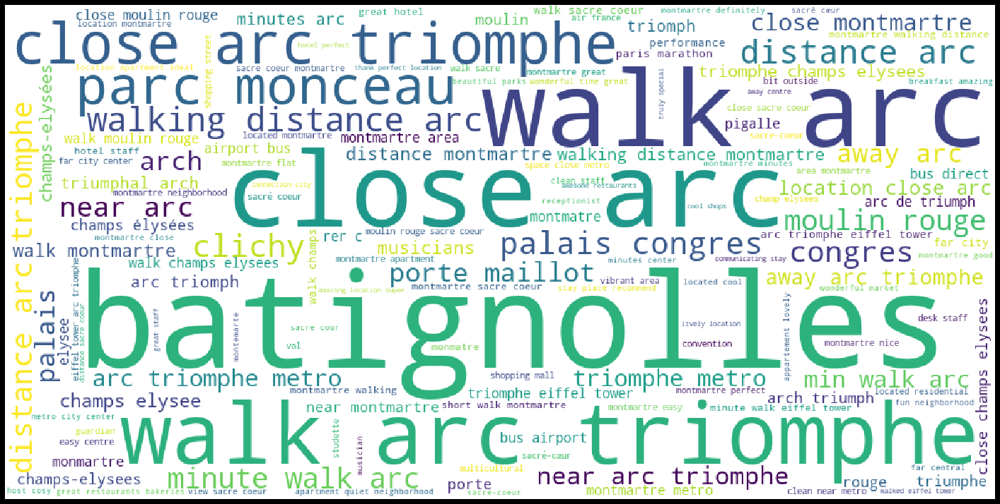

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

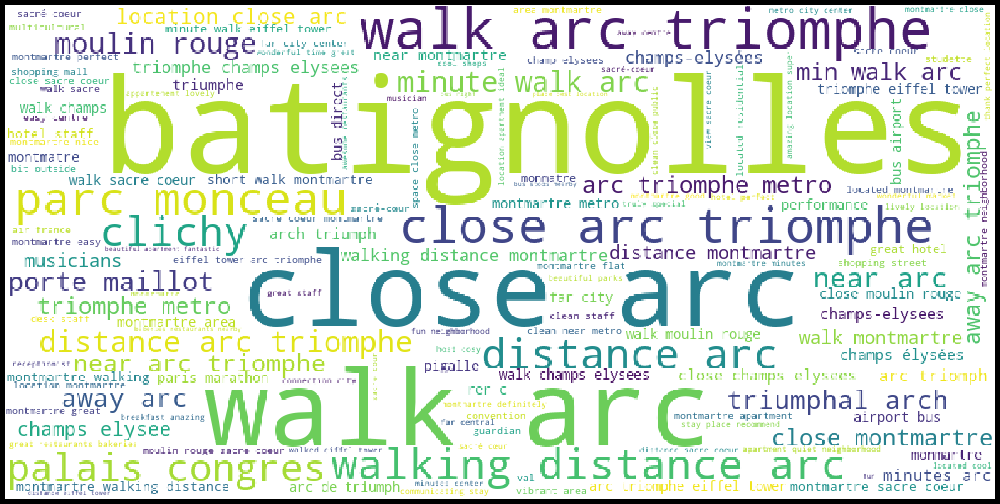

                    Filtered F23:

__________________________________________________



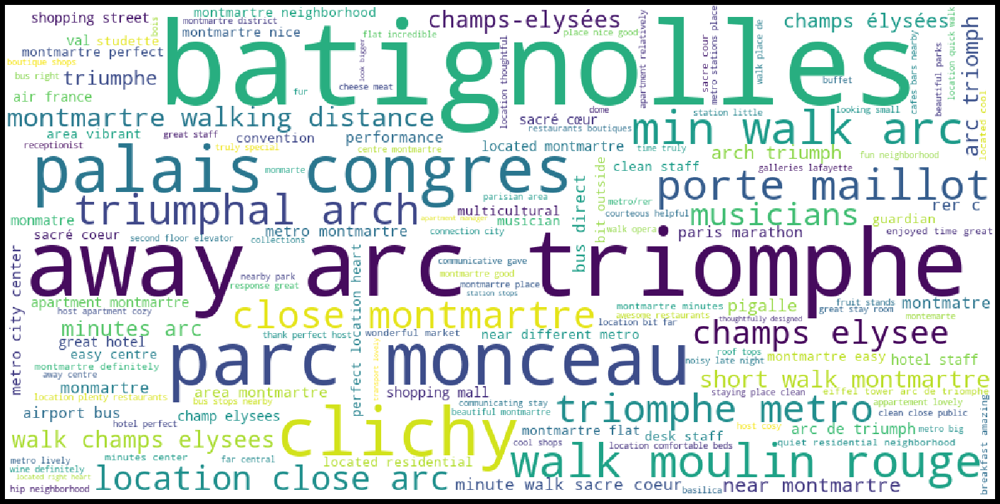

____________________________________________________________________________________________________

                                        BOURSE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



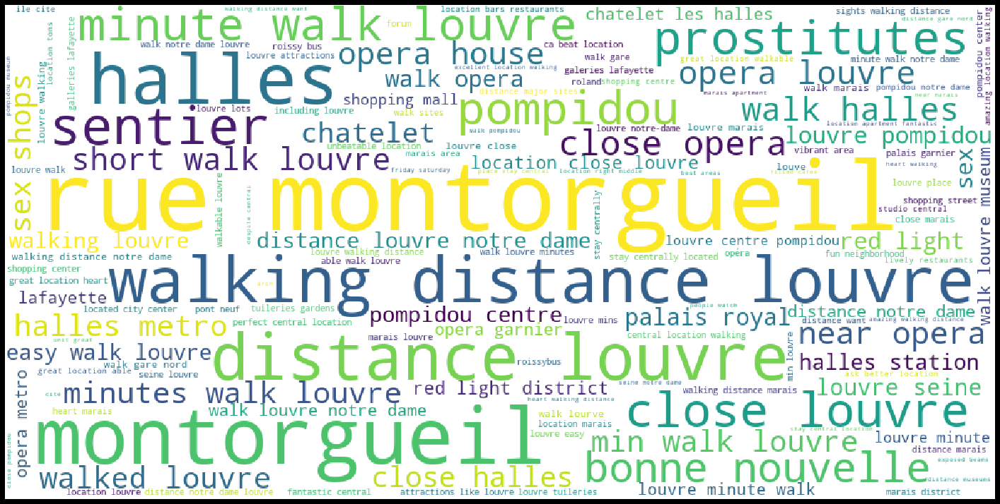

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

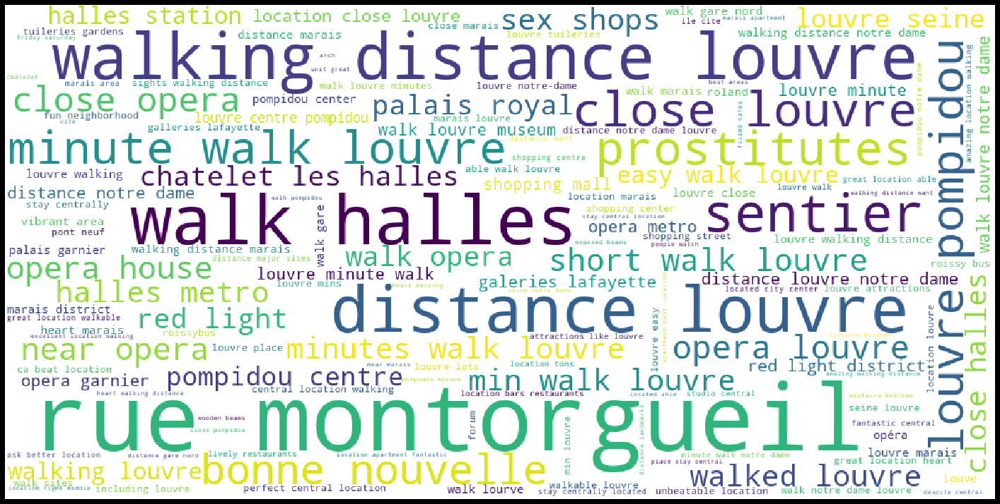

                    Filtered F23:

__________________________________________________



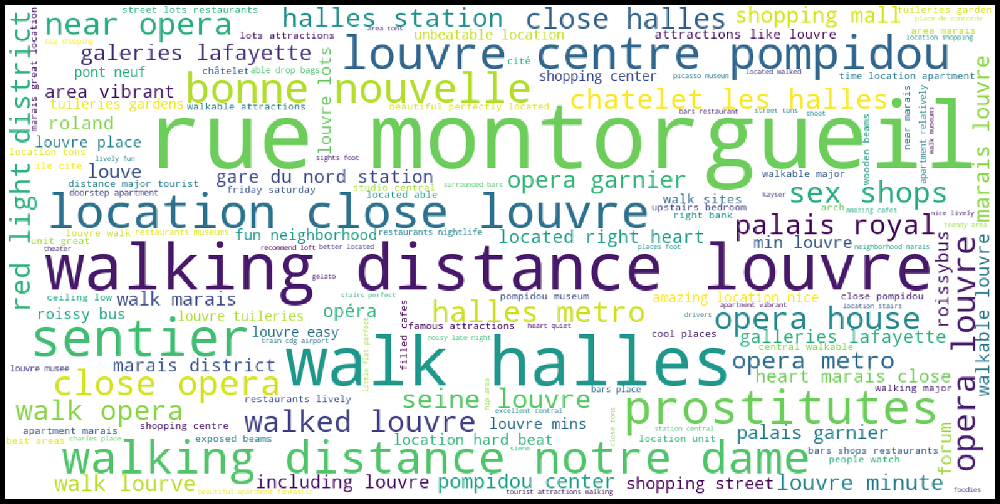

____________________________________________________________________________________________________

                                        BUTTES-CHAUMONT:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



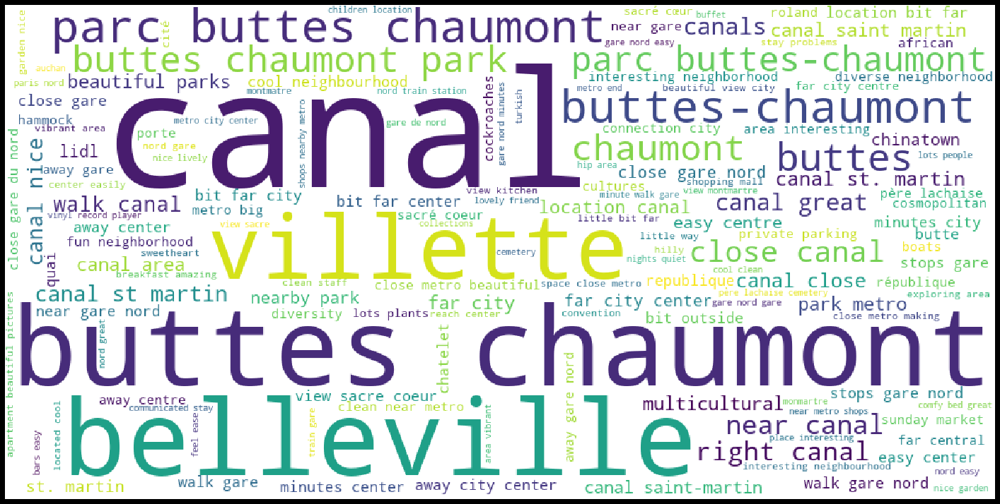

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

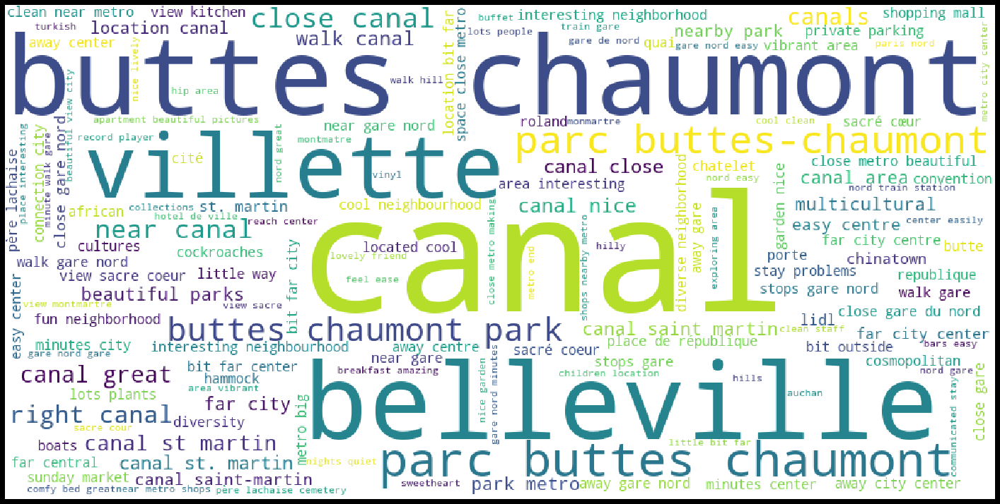

                    Filtered F23:

__________________________________________________



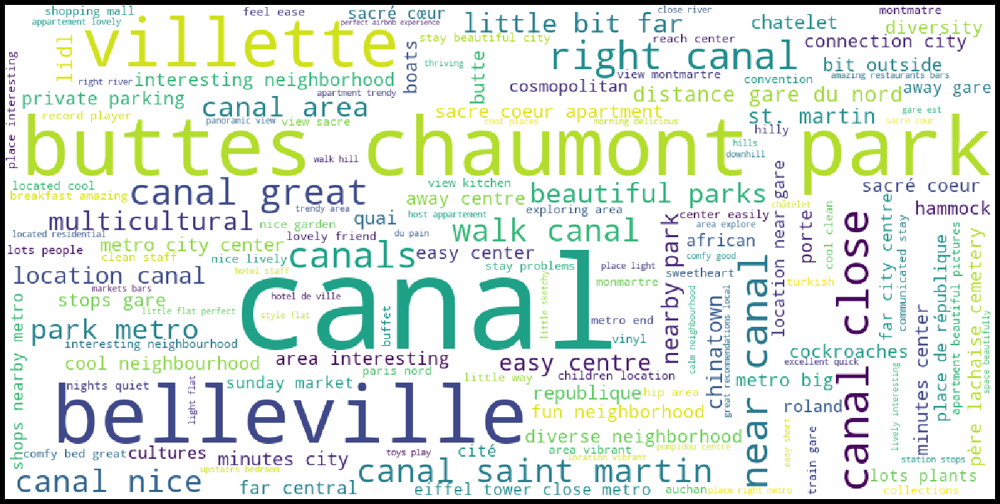

____________________________________________________________________________________________________

                                        BUTTES-MONTMARTRE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



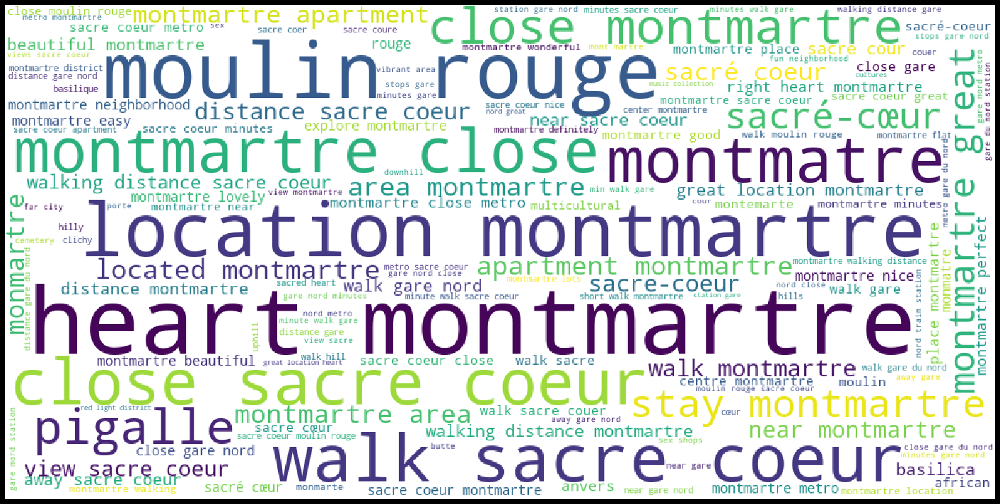

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

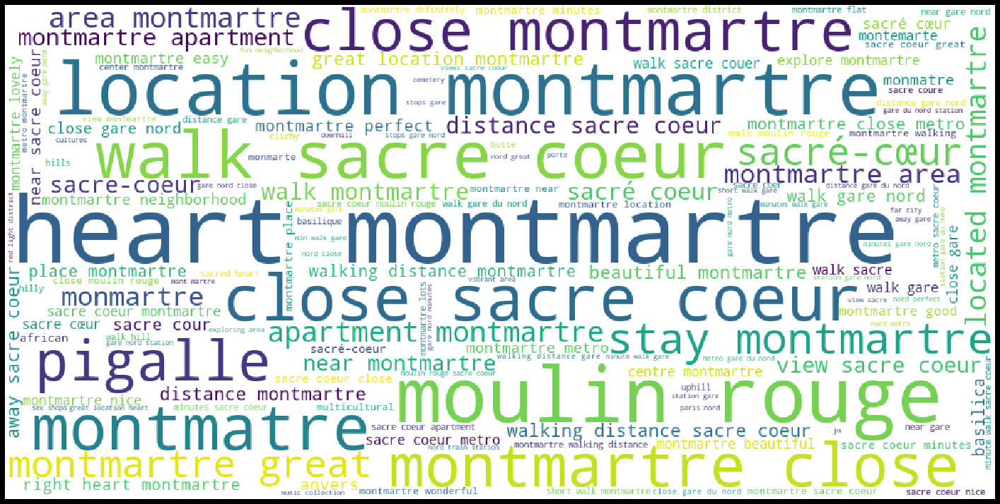

                    Filtered F23:

__________________________________________________



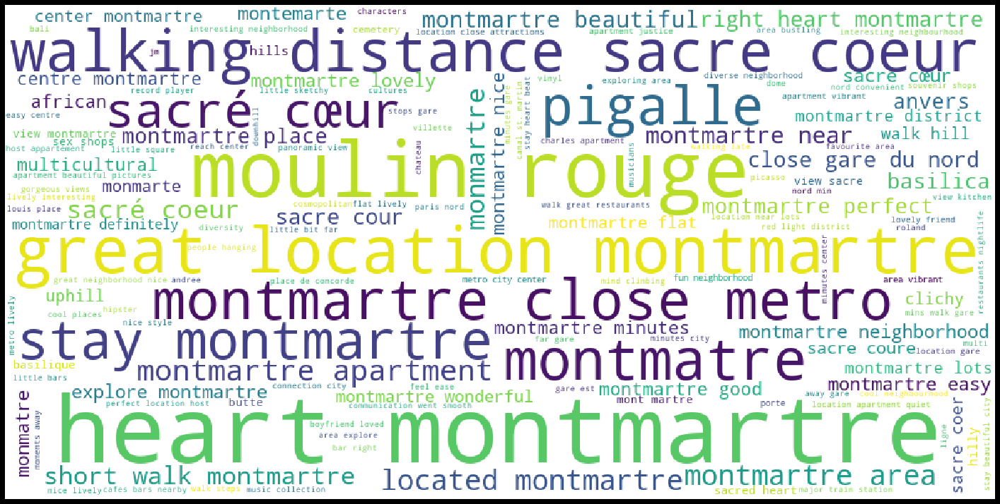

____________________________________________________________________________________________________

                                        ENTREPÔT:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



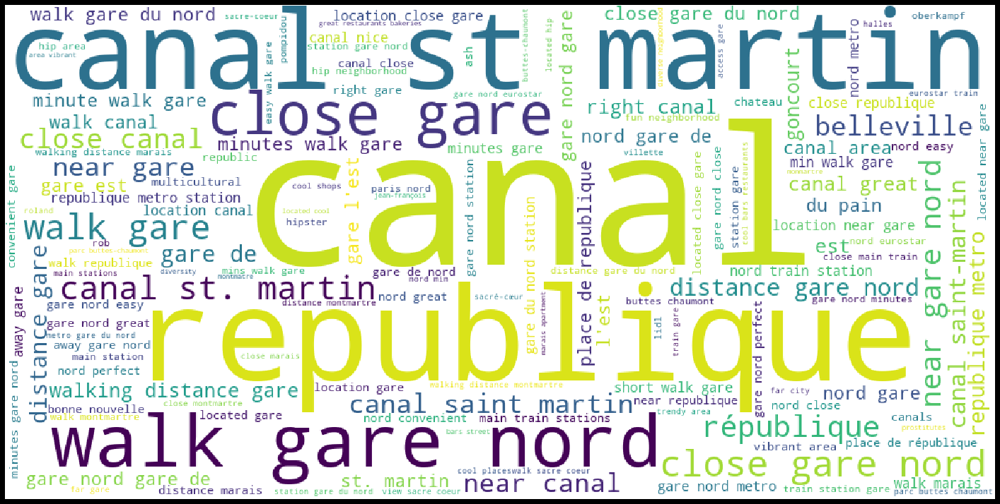

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

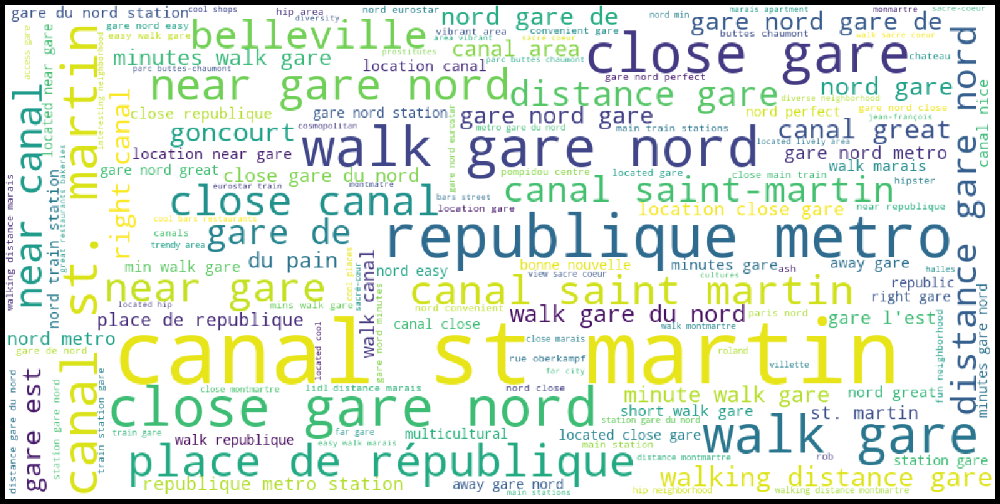

                    Filtered F23:

__________________________________________________



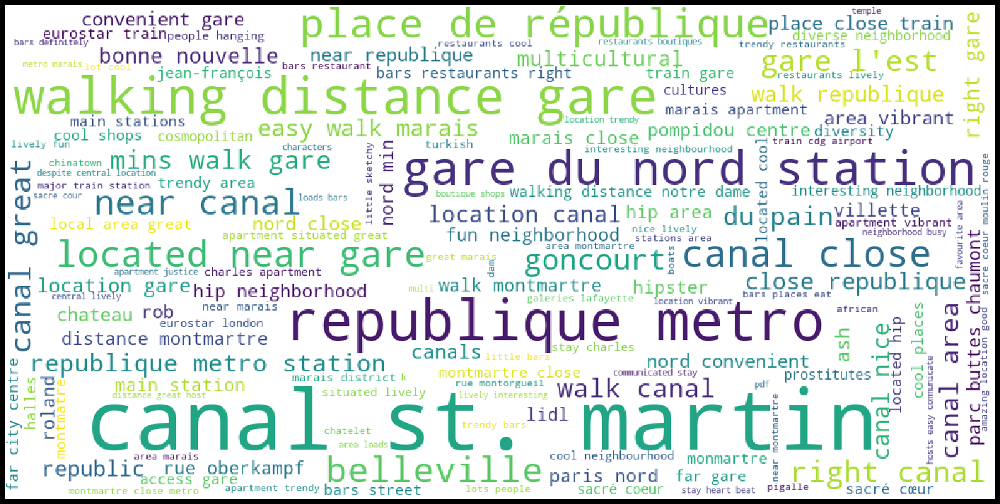

____________________________________________________________________________________________________

                                        GOBELINS:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



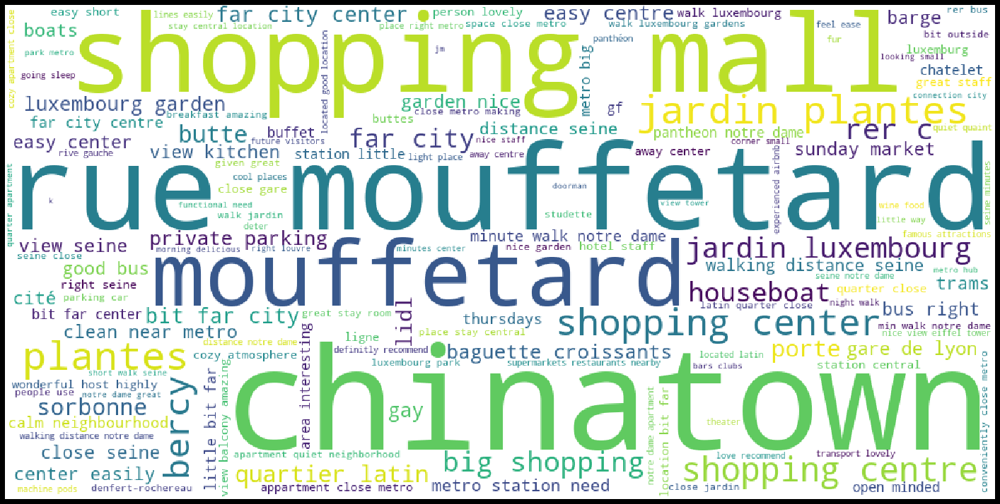

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

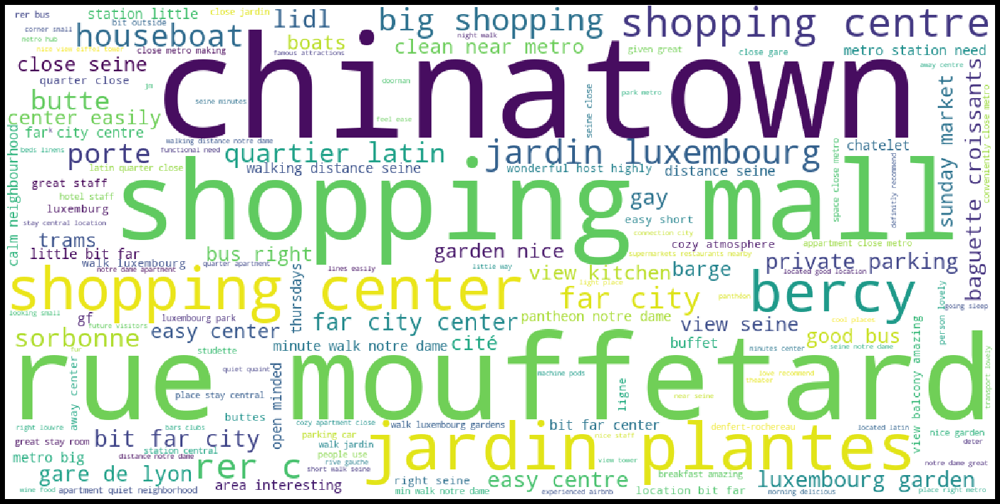

                    Filtered F23:

__________________________________________________



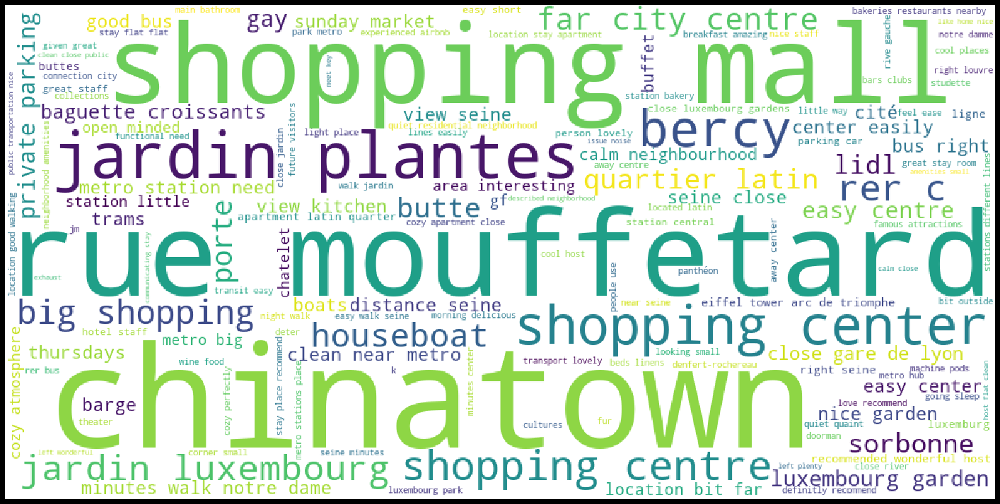

____________________________________________________________________________________________________

                                        HÔTEL-DE-VILLE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



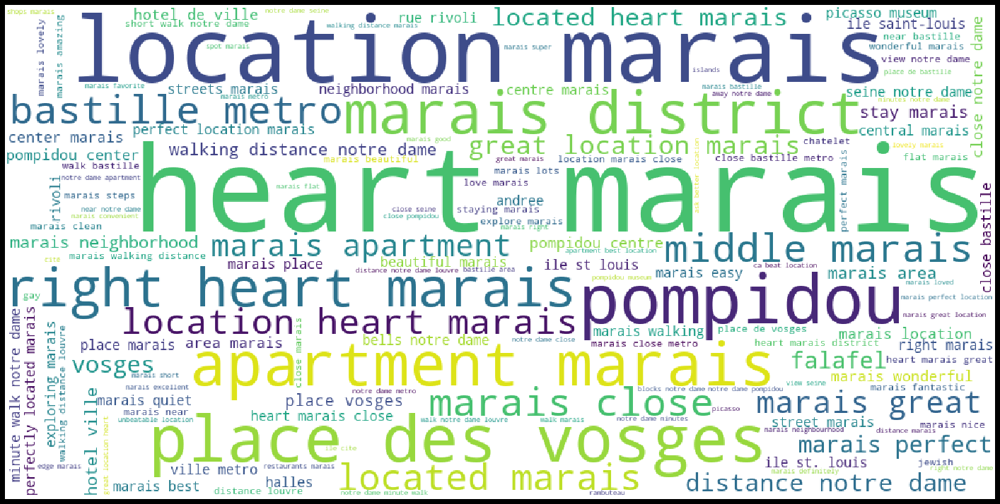

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

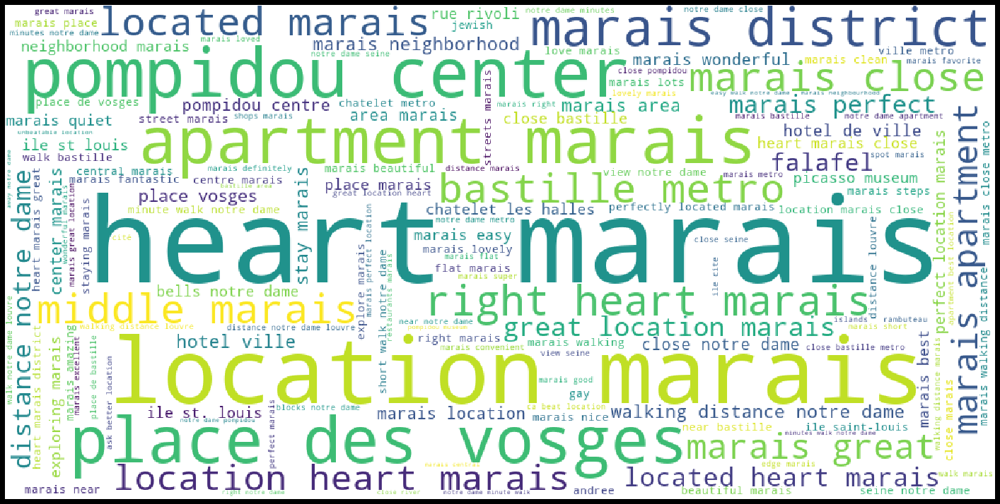

                    Filtered F23:

__________________________________________________



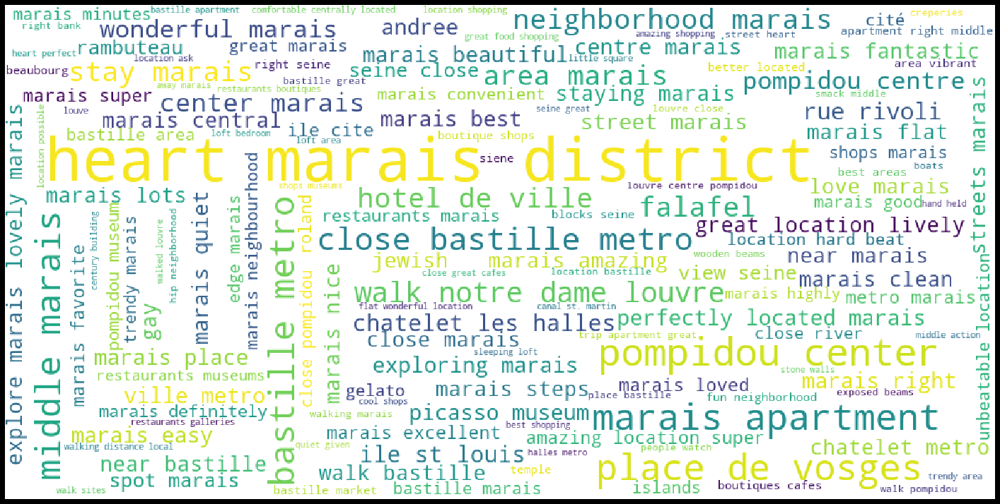

____________________________________________________________________________________________________

                                        LOUVRE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



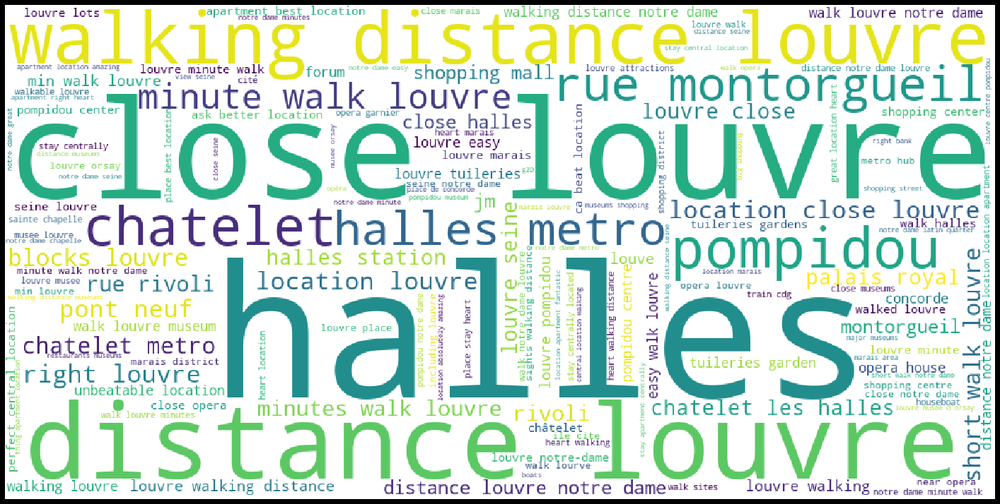

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

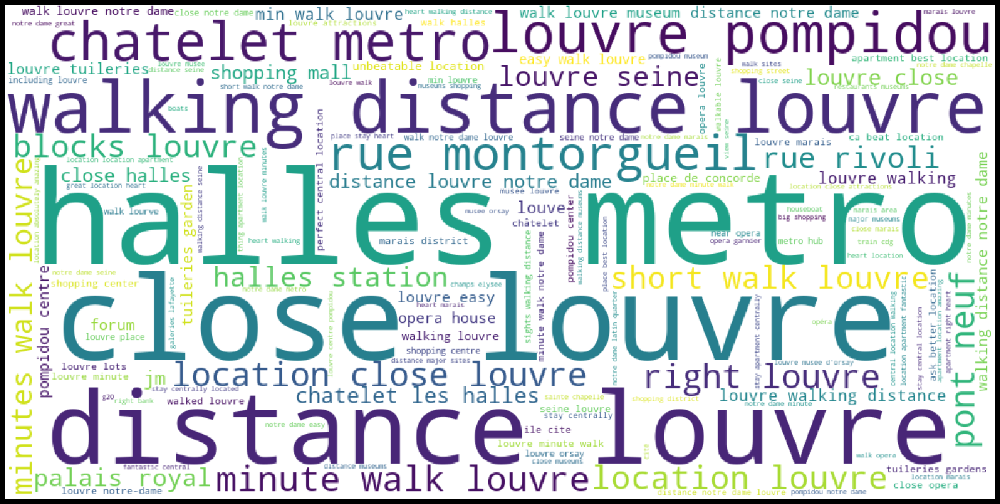

                    Filtered F23:

__________________________________________________



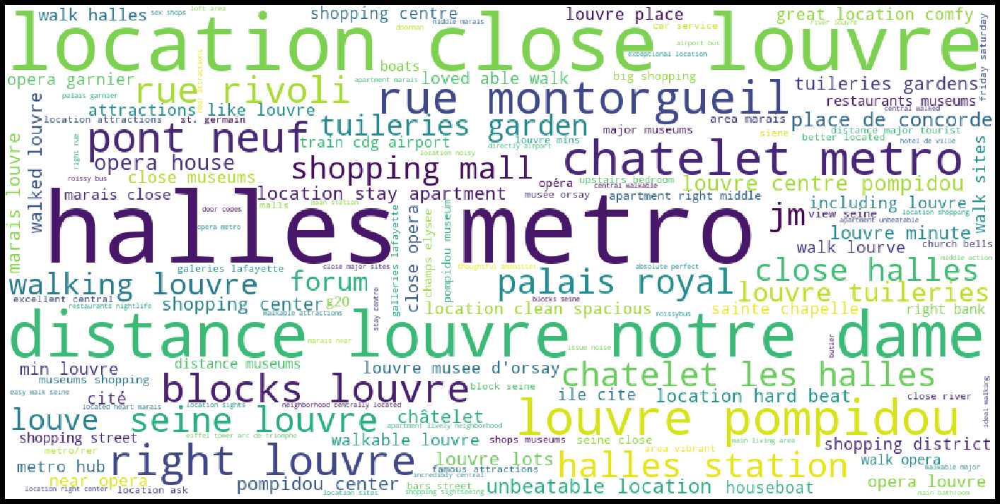

____________________________________________________________________________________________________

                                        LUXEMBOURG:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



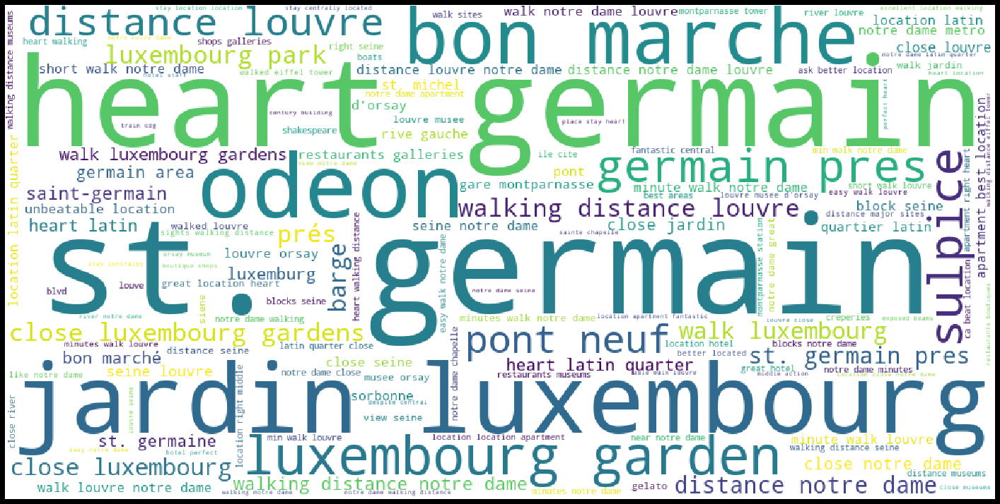

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

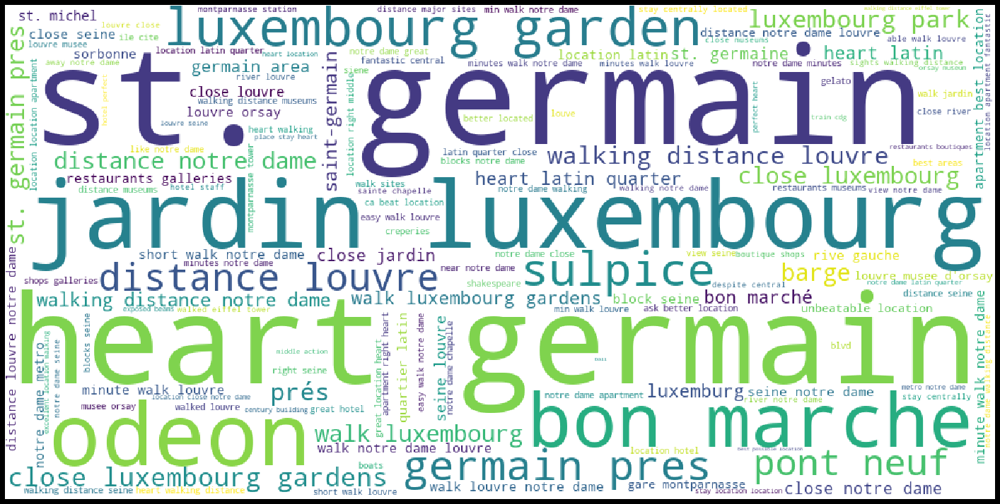

                    Filtered F23:

__________________________________________________



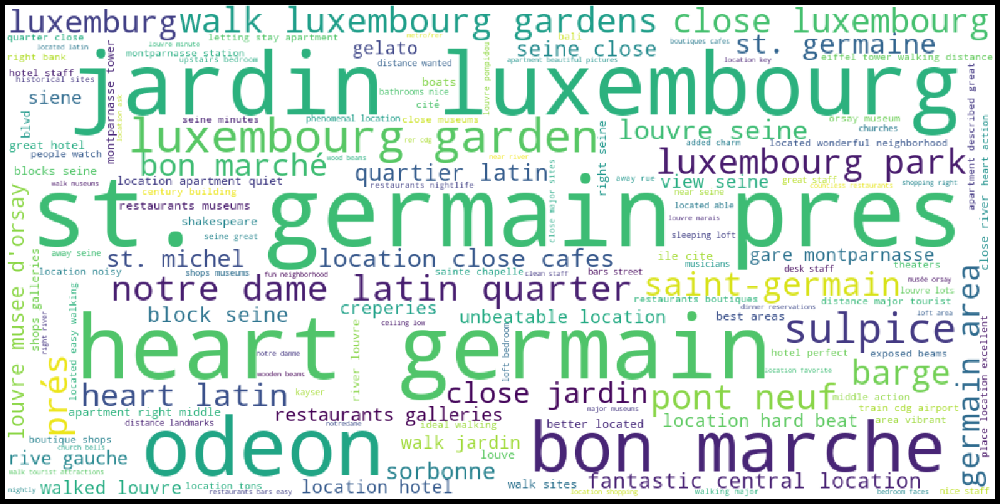

____________________________________________________________________________________________________

                                        MÉNILMONTANT:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



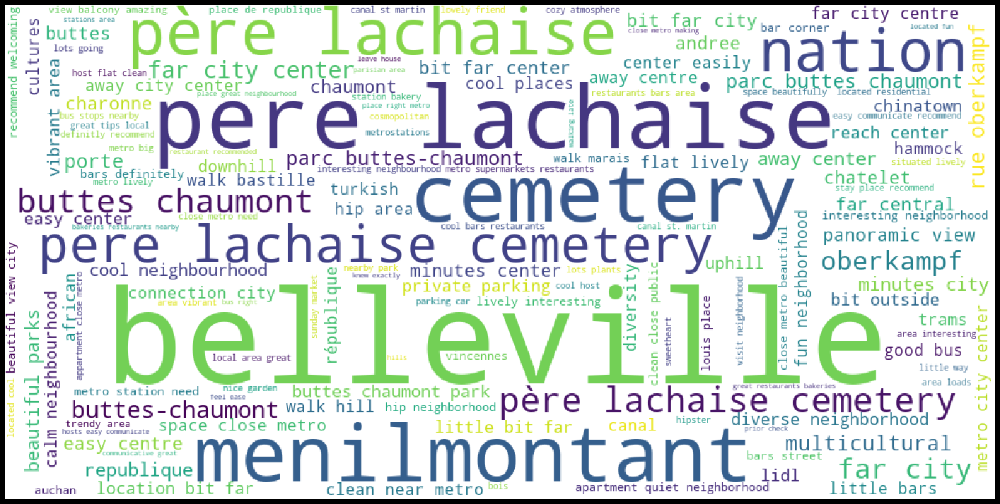

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

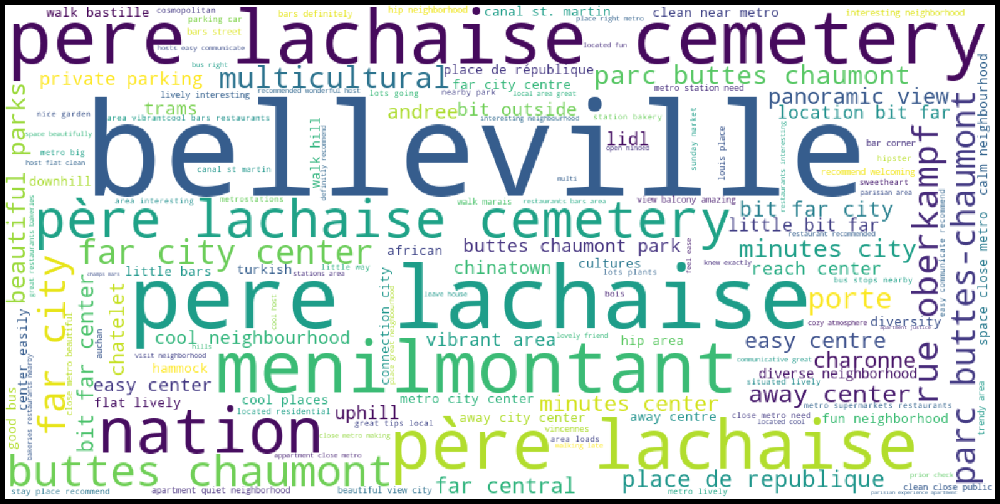

                    Filtered F23:

__________________________________________________



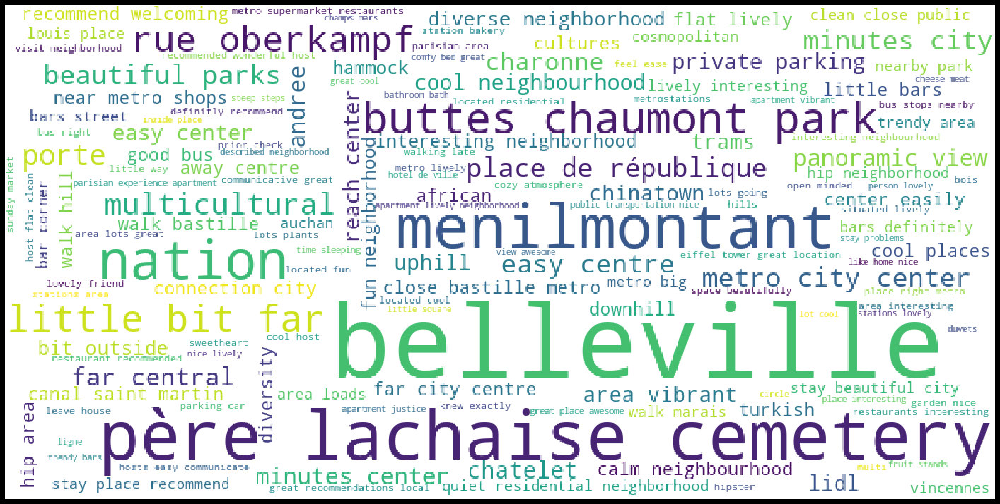

____________________________________________________________________________________________________

                                        OBSERVATOIRE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



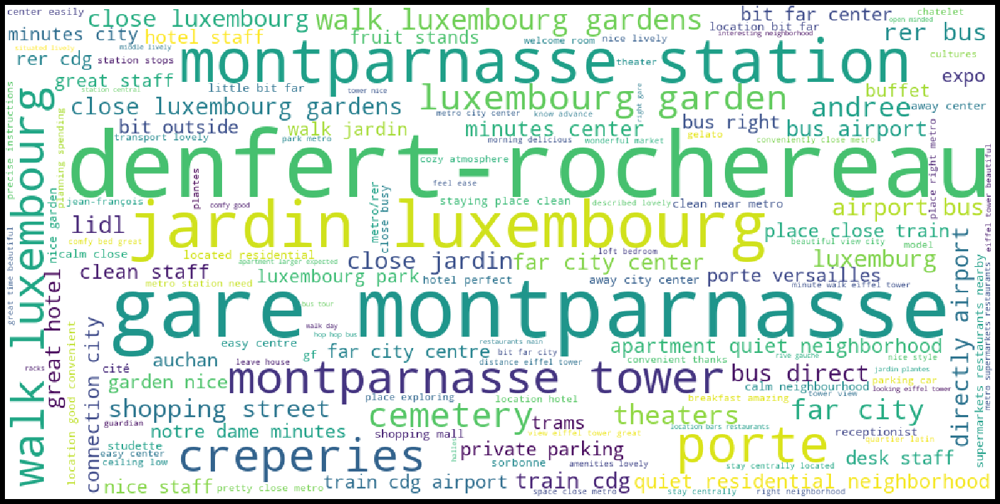

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

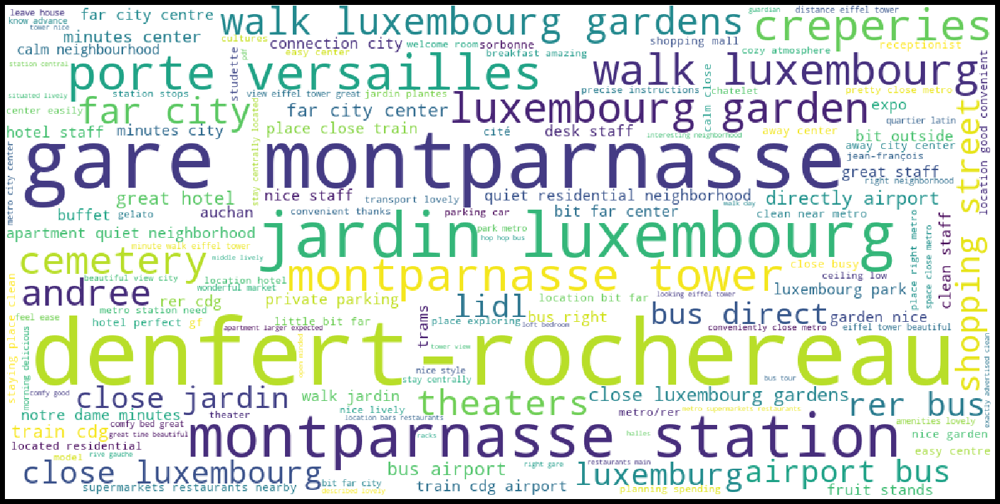

                    Filtered F23:

__________________________________________________



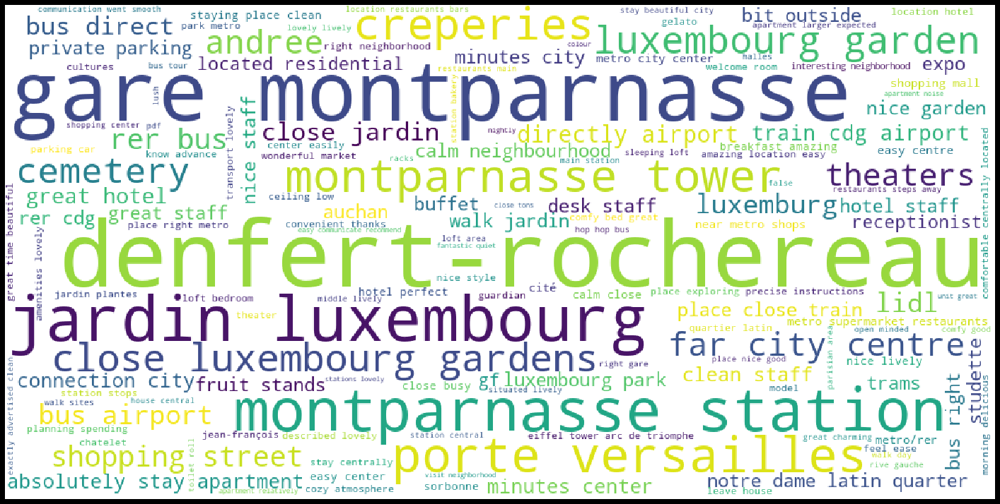

____________________________________________________________________________________________________

                                        OPÉRA:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



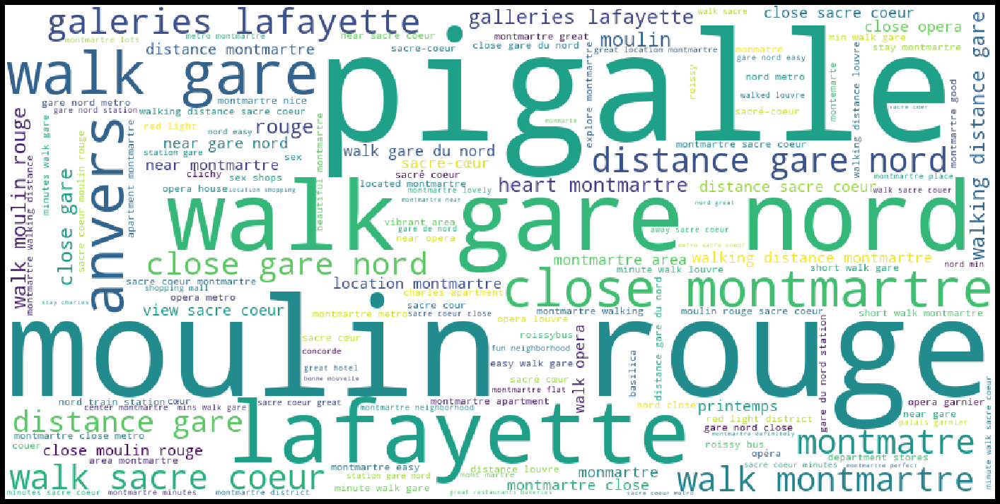

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

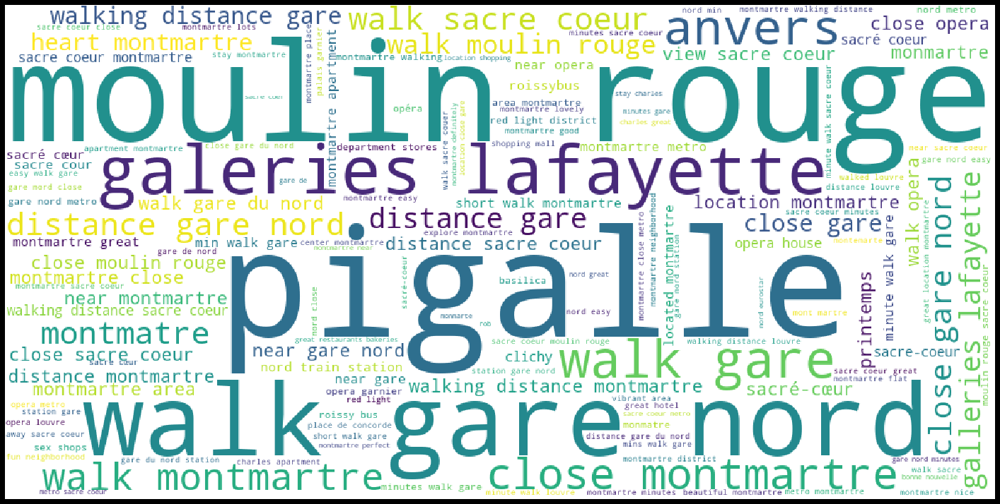

                    Filtered F23:

__________________________________________________



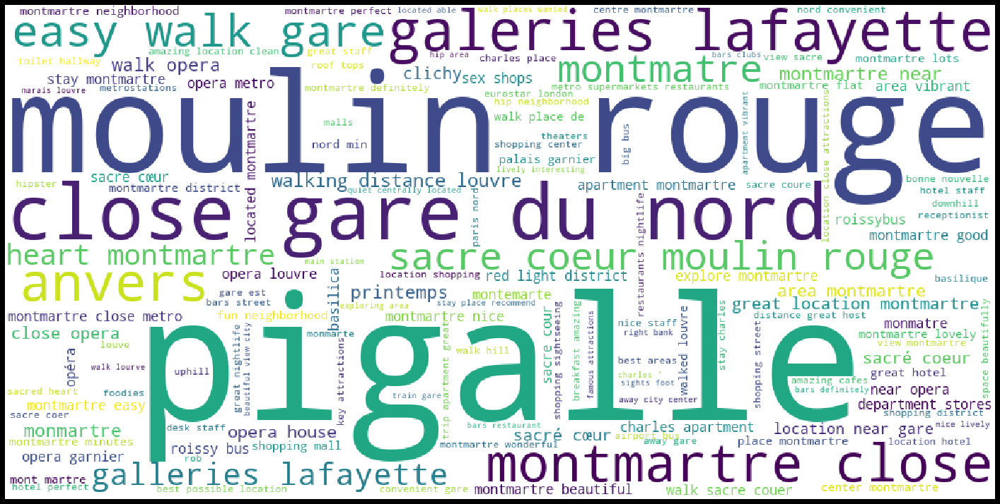

____________________________________________________________________________________________________

                                        PALAIS-BOURBON:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



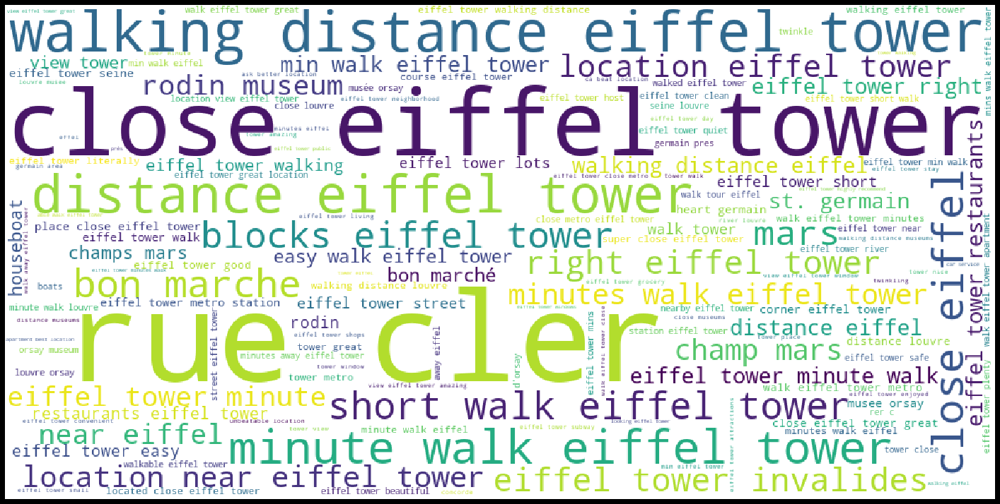

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

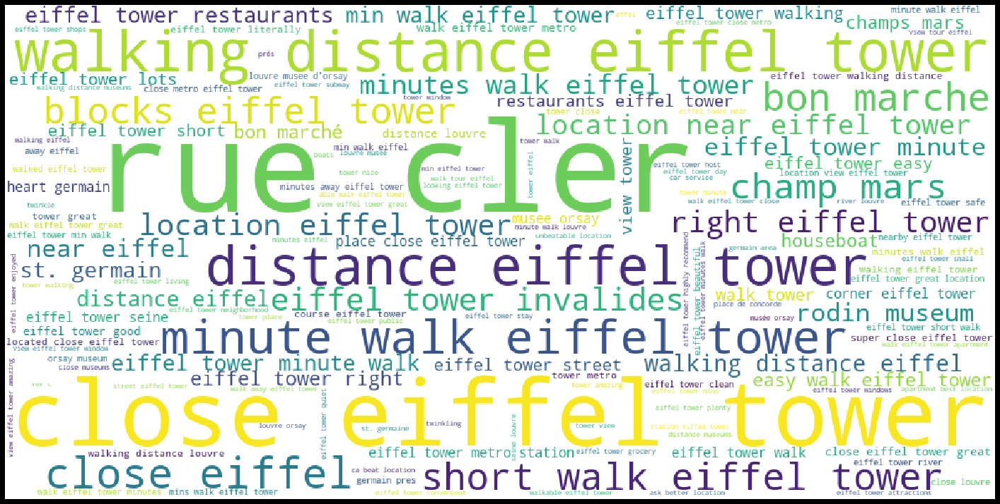

                    Filtered F23:

__________________________________________________



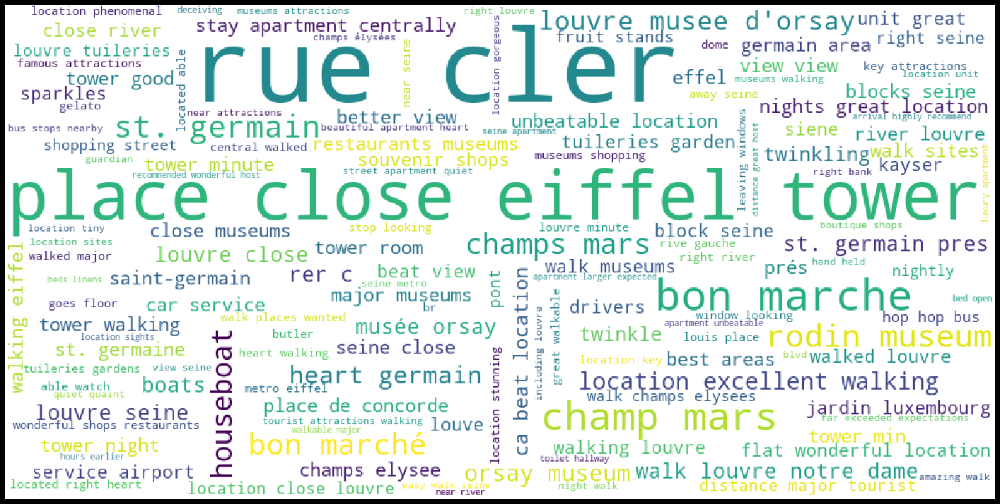

____________________________________________________________________________________________________

                                        PANTHÉON:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



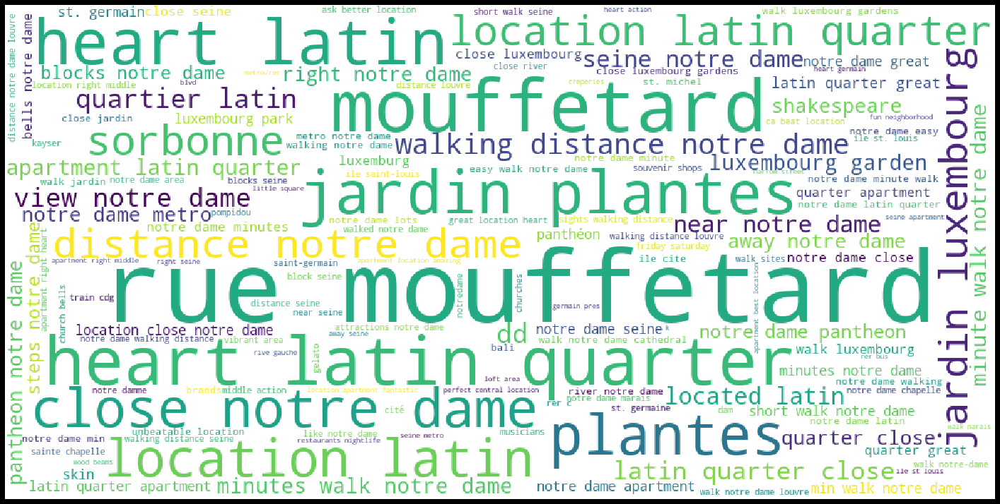

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

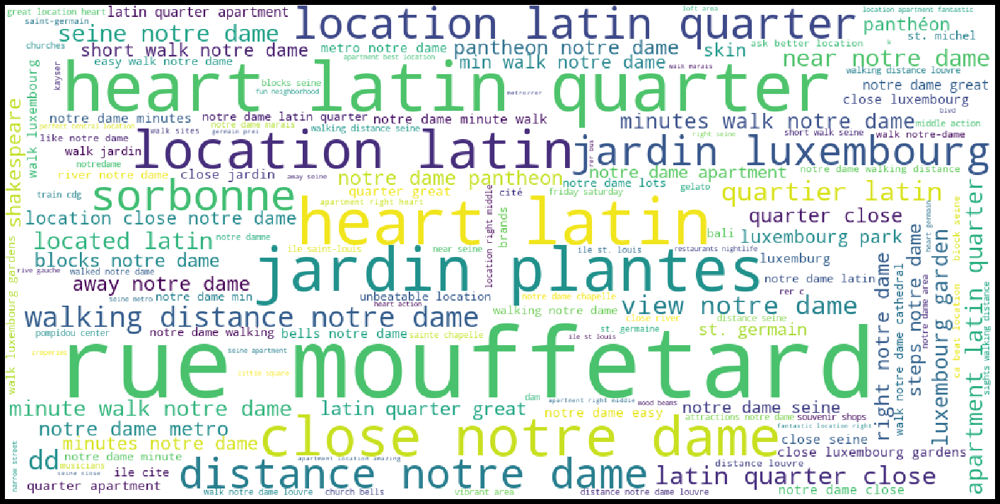

                    Filtered F23:

__________________________________________________



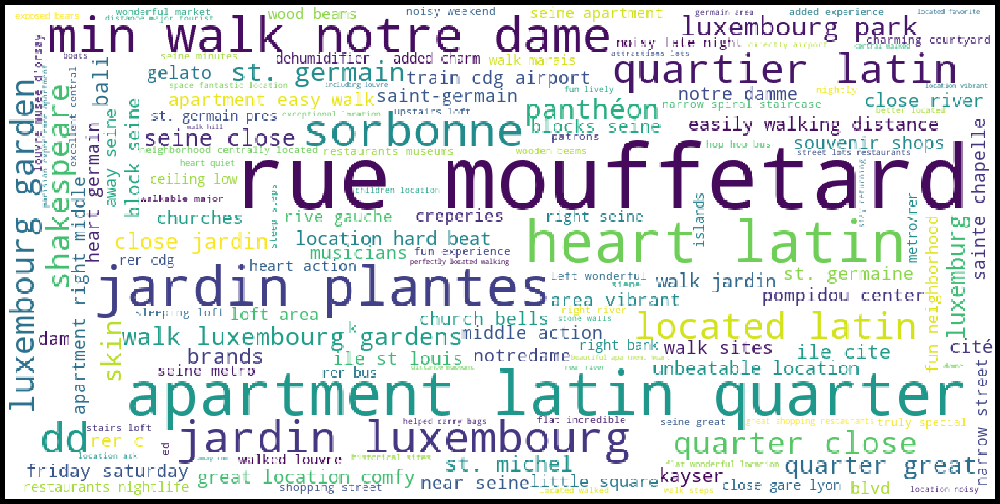

____________________________________________________________________________________________________

                                        PASSY:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



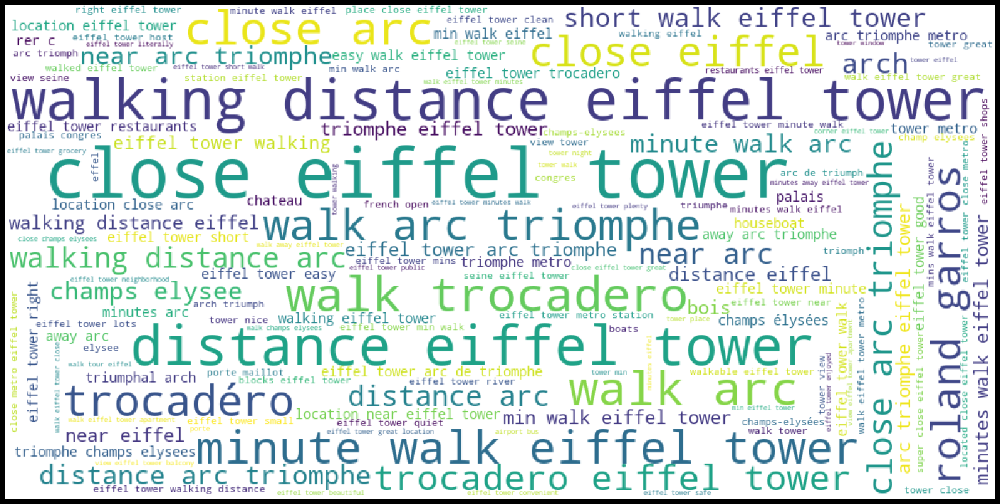

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

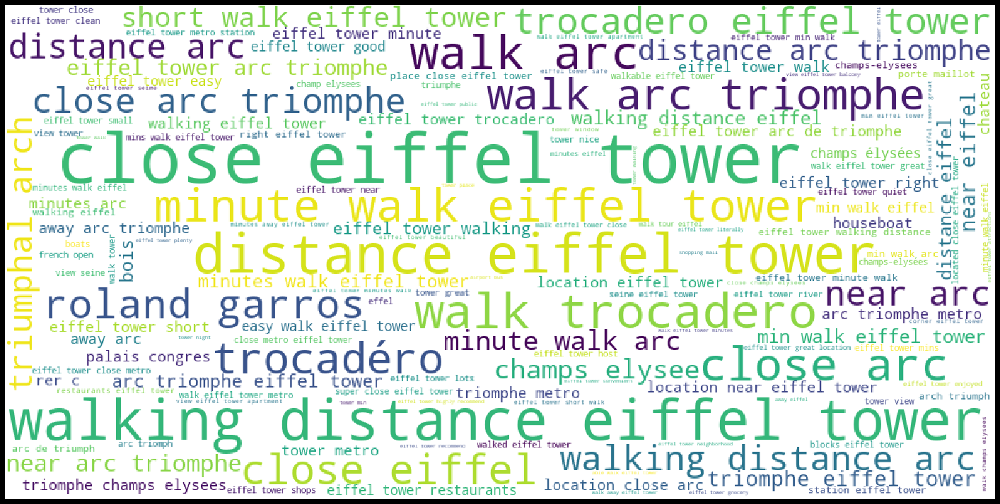

                    Filtered F23:

__________________________________________________



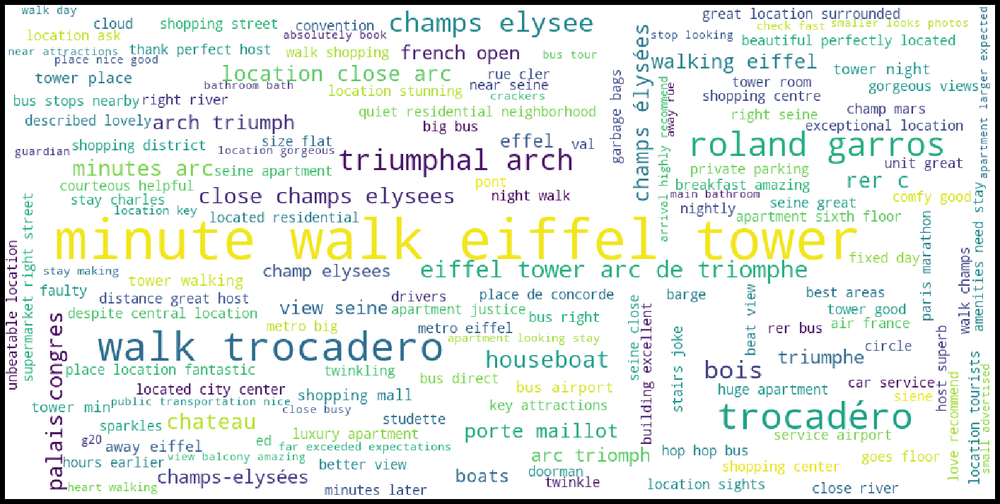

____________________________________________________________________________________________________

                                        POPINCOURT:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



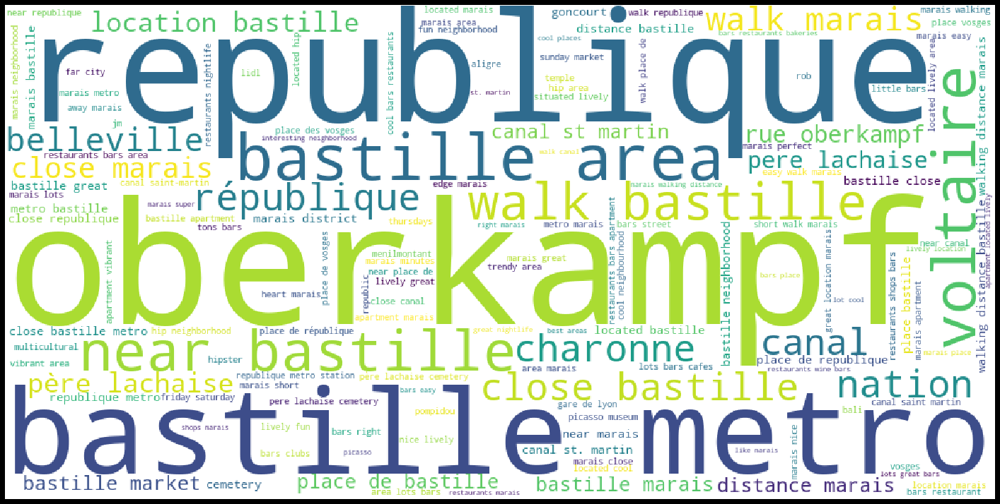

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

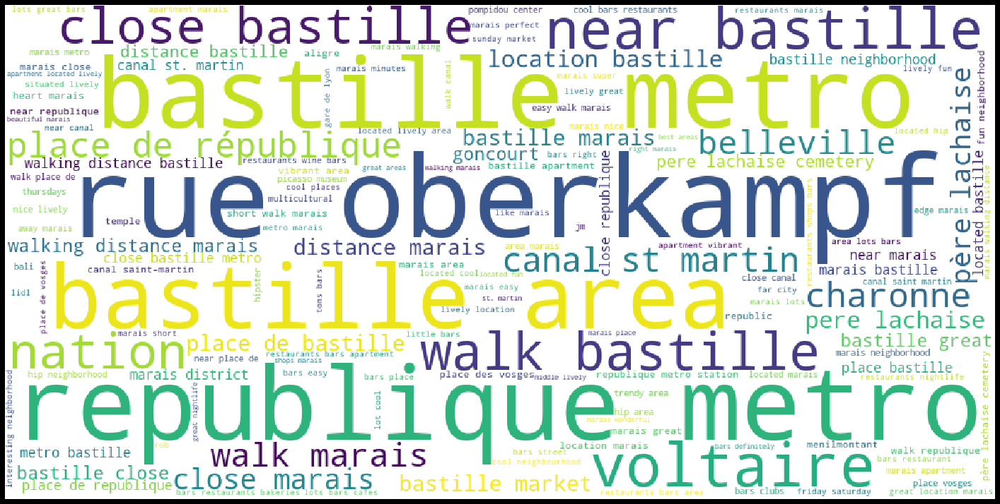

                    Filtered F23:

__________________________________________________



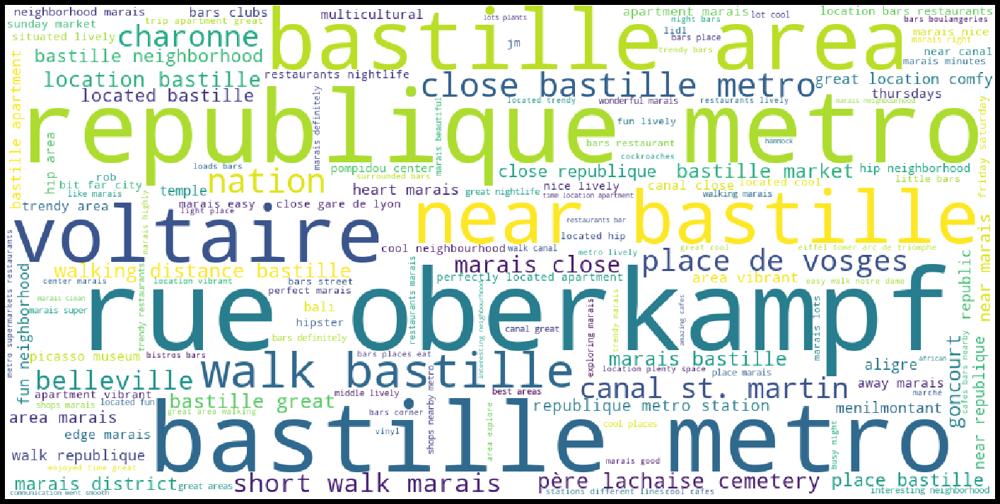

____________________________________________________________________________________________________

                                        REUILLY:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



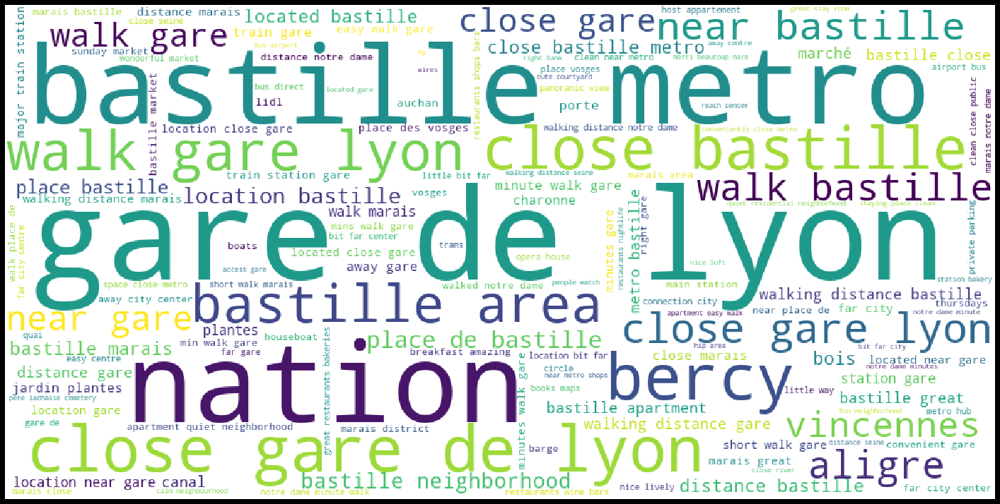

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

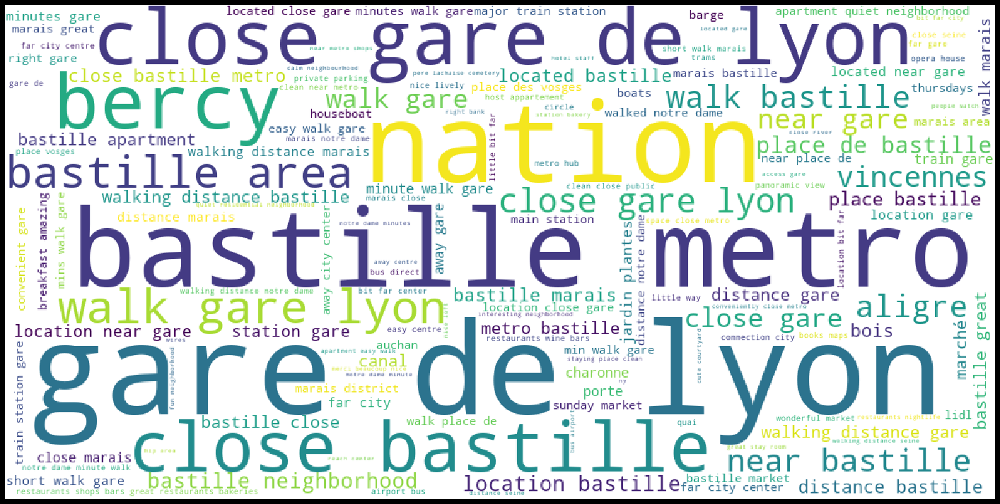

                    Filtered F23:

__________________________________________________



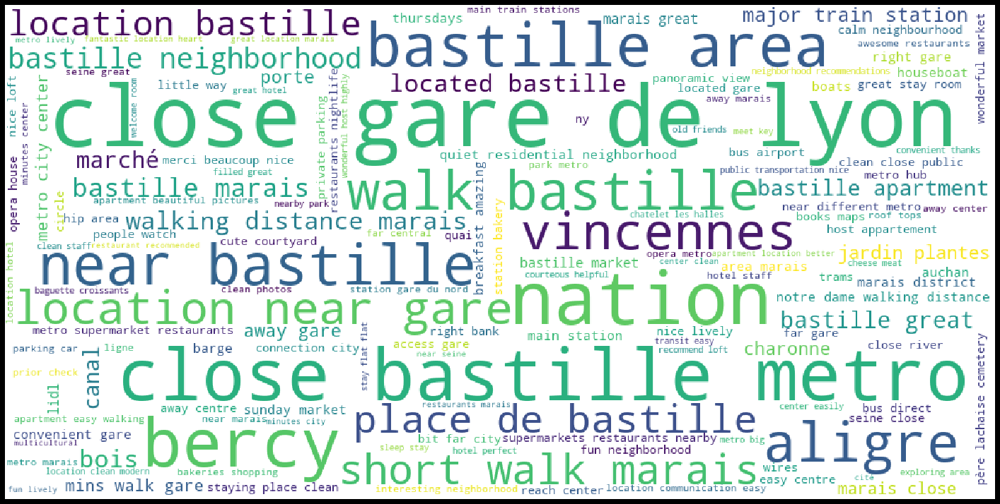

____________________________________________________________________________________________________

                                        TEMPLE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



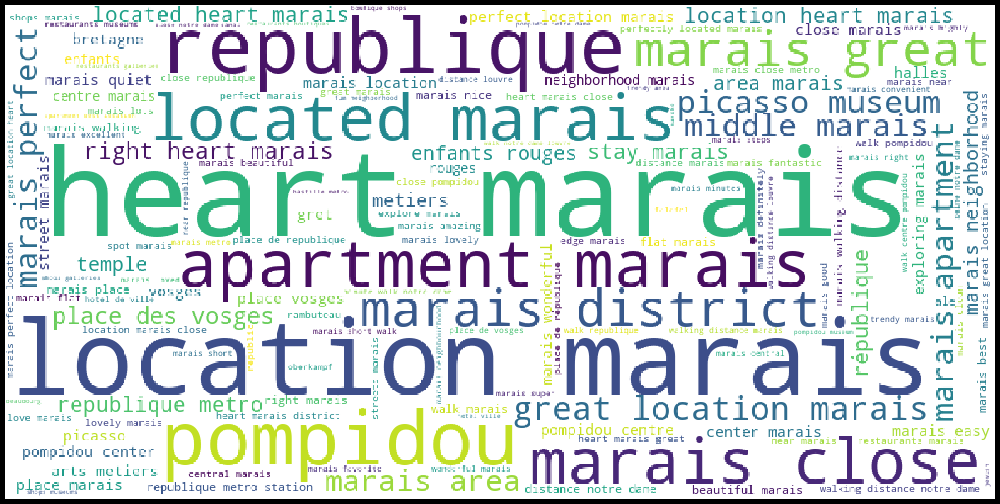

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

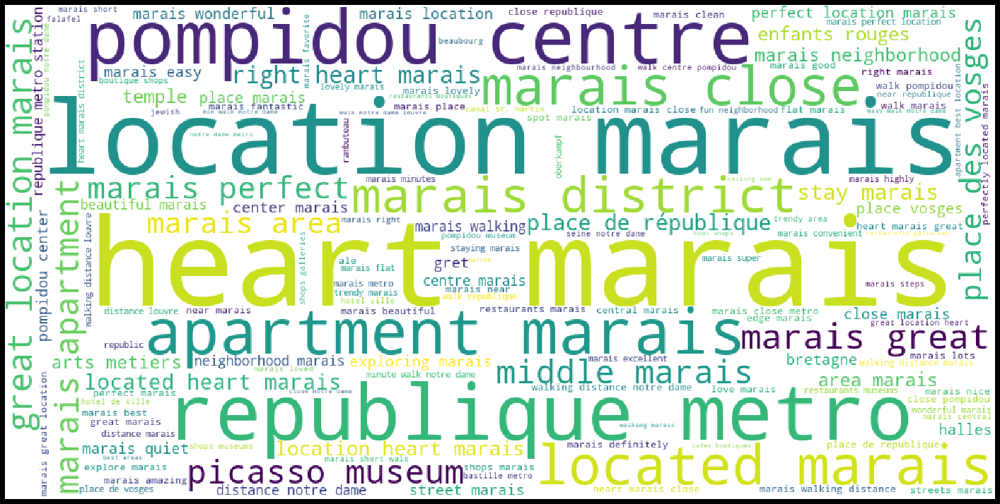

                    Filtered F23:

__________________________________________________



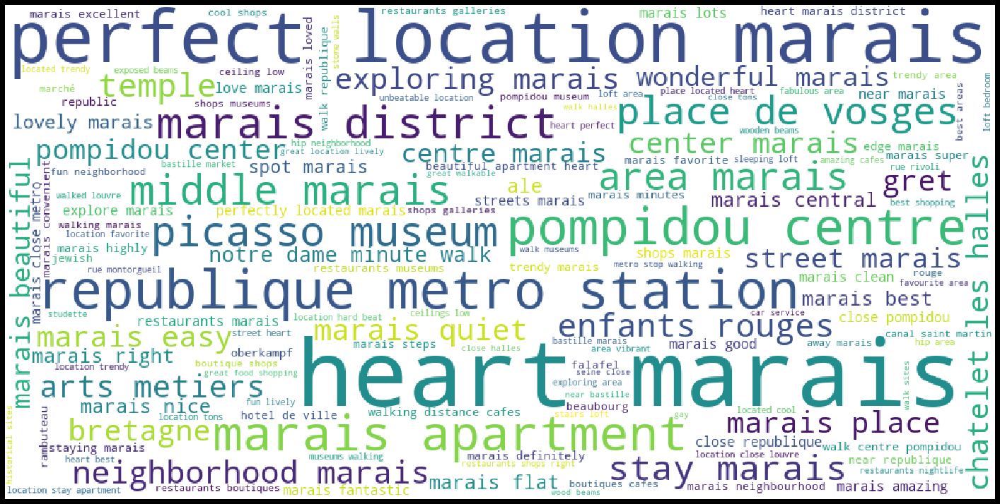

____________________________________________________________________________________________________

                                        VAUGIRARD:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



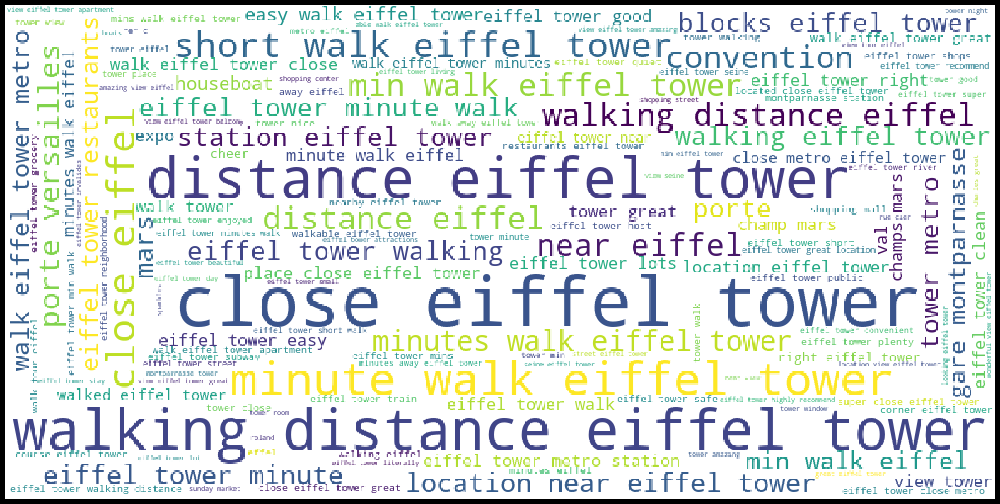

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

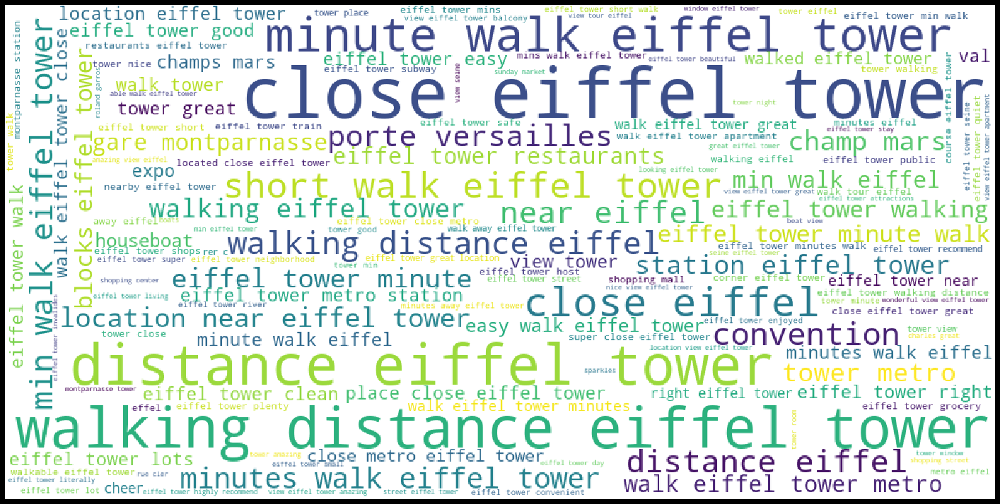

                    Filtered F23:

__________________________________________________



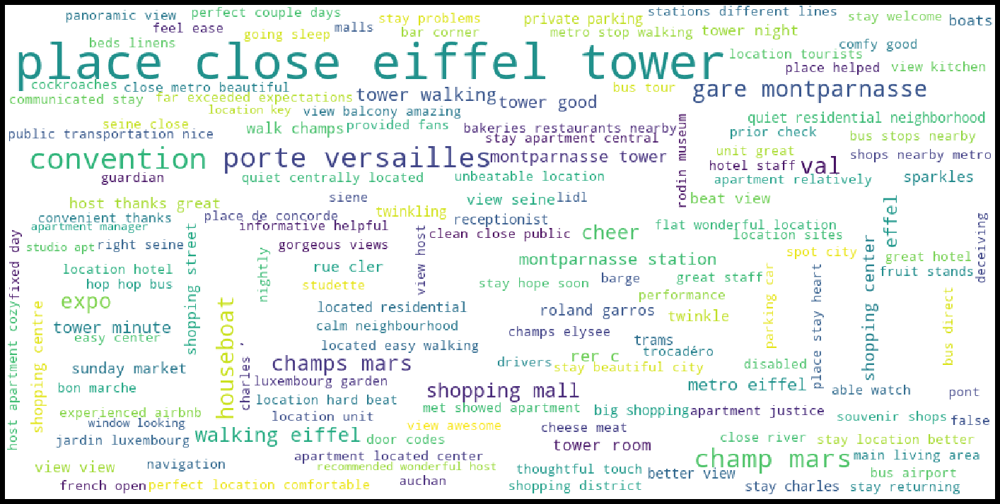

____________________________________________________________________________________________________

                                        ÉLYSÉE:

____________________________________________________________________________________________________

                    Full:

__________________________________________________



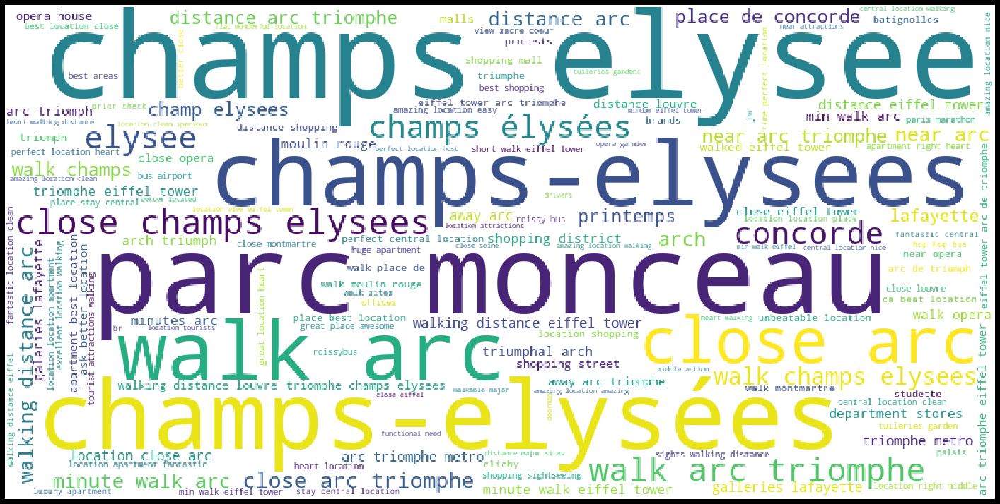

                    Filtered F2:

__________________________________________________



<Figure size 432x288 with 0 Axes>

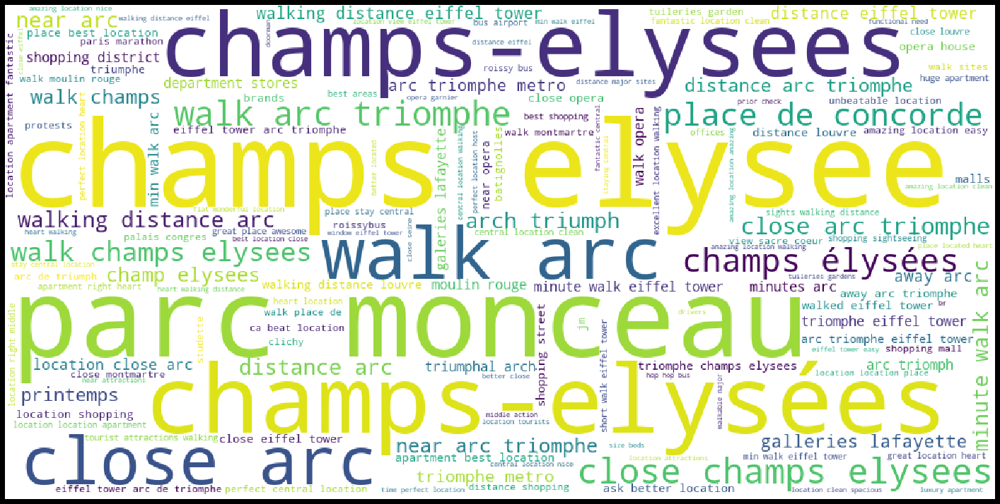

                    Filtered F23:

__________________________________________________



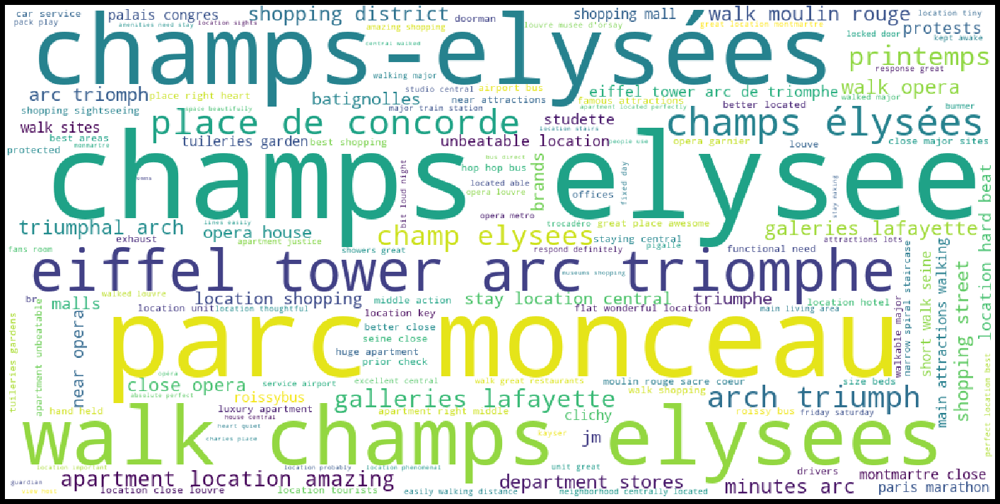

In [68]:
from wordcloud import WordCloud

folder_save = 'WordcloudResults4mars'
if not os.path.exists(folder_save):
    os.mkdir(folder_save)

for ngbh in vibrations.keys():
    
    print('_'*100+'\n')
    print(' '*40+ngbh.upper() + ':\n')
    print('_'*100+'\n')
    
    print(' '*20+'Full' + ':\n')
    print('_'*50+'\n')
    
    # Construct the wordcloud
    wordcloud = WordCloud(background_color="white", width=1000, height=500, max_words=150, contour_width=0.1, contour_color='steelblue')# Generate a word cloud
    wordcloud.generate_from_frequencies(dict(vibrations_full[ngbh]))
    wordcloud.to_image()

    # Plot the wordcloud
    plt.figure( figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=1)
    plt.show();
    
    # Save the wordcloud
    save_path = os.path.join(folder_save, 'wordcloud_'+ngbh+'.png')
    plt.savefig(save_path);
    
    # ------------------------------------------------------------------------
    
    print(' '*20+'Filtered F2' + ':\n')
    print('_'*50+'\n')
    
    # Construct the wordcloud
    wordcloud = WordCloud(background_color="white", width=1000, height=500, max_words=150, contour_width=0.1, contour_color='steelblue')# Generate a word cloud
    wordcloud.generate_from_frequencies(dict(vibrations_F2[ngbh]))
    wordcloud.to_image()

    # Plot the wordcloud
    plt.figure( figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=1)
    plt.show();

    # ------------------------------------------------------------------------
    
    print(' '*20+'Filtered F23' + ':\n')
    print('_'*50+'\n')
    
    # Construct the wordcloud
    wordcloud = WordCloud(background_color="white", width=1000, height=500, max_words=150, contour_width=0.1, contour_color='steelblue')# Generate a word cloud
    wordcloud.generate_from_frequencies(dict(vibrations_F23[ngbh]))
    wordcloud.to_image()

    # Plot the wordcloud
    plt.figure( figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=1)
    plt.show();